# Project Loan Default

In [1]:
import pandas as pd
import numpy as np
from collections import Counter
import matplotlib.pyplot as plt
import time
import seaborn as sns
from sklearn.neighbors import LocalOutlierFactor
from sklearn import svm

pd.set_option('display.max_columns', None)

In [2]:
def map_ageing_class(row):
    if row in ['01 mo', '02 mos', '03 mos', '04 mos', '05 mos']:
        return 1
    elif row in ['Current', 'FP']:
        return 0
    else:
        return np.nan
    
#FUNCTION TO IDENTIFY OUTLIERS USING IQR METHOD
def iqr_outlier(x,factor):
    q1 = x.quantile(0.25)
    q3 = x.quantile(0.75)
    iqr = q3 - q1
    min_ = q1 - factor * iqr
    max_ = q3 + factor * iqr
    result_ = pd.Series([0] * len(x))
    result_[((x < min_) | (x > max_))] = 1
    return result_

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from lightgbm import LGBMClassifier
from xgboost.sklearn import XGBClassifier

from sklearn.feature_selection import RFE, RFECV, VarianceThreshold

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, make_scorer, confusion_matrix, roc_curve
from sklearn.model_selection import GridSearchCV, StratifiedKFold, permutation_test_score
from sklearn.base import clone


from imblearn.metrics import geometric_mean_score
import shap

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from imblearn.pipeline import Pipeline
# from sklearn.pipeline import Pipeline

import dice_ml

from catboost import CatBoostClassifier

UserConfigValidationException will be deprecated from dice_ml.utils. Please import UserConfigValidationException from raiutils.exceptions.


In [4]:
def specificity_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    specificity = tn / (tn + fp)
    return specificity

specificity_scorer = make_scorer(specificity_score)

def npv_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    npv = tn / (tn + fn)
    return npv

npv_scorer = make_scorer(npv_score)

g_mean_scorer = make_scorer(geometric_mean_score)


skf = StratifiedKFold(10, shuffle=True, random_state=0)

def get_cat_cols(df):
    return df.select_dtypes(include=['object']).columns.tolist()

In [5]:
from sklearn.decomposition import PCA

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler, EditedNearestNeighbours, TomekLinks
from imblearn.combine import SMOTEENN, SMOTETomek

from sklearn.base import BaseEstimator, TransformerMixin

class DropCategoricalFeatures(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        # Assuming X is a DataFrame
        non_categorical_cols = X.select_dtypes(exclude=['object']).columns.tolist()
        return X[non_categorical_cols]

def logreg_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LogisticRegression(random_state=random_state, max_iter=1000))
    ])

    param_grid = {
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
                       EditedNearestNeighbours(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__penalty': ['l2', None],
        'classifier__solver': ['liblinear', 'lbfgs', 'newton-cholesky']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def dt_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]


    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', DecisionTreeClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(), 
#             RobustScaler(),
#             MinMaxScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
            SMOTEENN(random_state=random_state),
            SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
            TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__max_depth': [2, 3, 5],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [1, 2, 3],
        'classifier__max_features': ['auto', 'sqrt', 'log2', None],
        'classifier__criterion': ["gini", "entropy", "log_loss"]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)
        modified_estimator = clone(best_estimator)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }
    
    return grid_search, best_estimator, model_info, metrics_df

from sklearn.decomposition import TruncatedSVD

def rf_class2(df, scorer, label_col, random_state=0):
#     df_majority = df[df.home_ownership_class == 0]
#     df_minority = df[df.home_ownership_class == 1]

# #     display(df_majority)
# #     display(df_minority)
# #     print(len(df_majority), len(df_minority))
#     # Randomly downsample majority class
#     df_majority_downsampled = df_majority.sample(frac=0.2,
#                                                  random_state=random_state)
#     df = pd.concat([df_majority_downsampled, df_minority], axis=0)

    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)

#     n_components = X_scaled.shape[1]  # Maximum number of components
#     svd = TruncatedSVD(n_components=n_components)
#     X_svd = svd.fit_transform(X_scaled)

#     # Step 3: Find number of components that explain at least 90% variance
#     cum_variance = np.cumsum(svd.explained_variance_ratio_)
#     num_components = np.argmax(cum_variance >= 0.90) + 1  # +1 because Python indexing starts from 0
#     X_selected = X_svd[:, :num_components]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

#     X_resampled, y_resampled = RandomOverSampler(random_state=random_state).fit_resample(X_train, y_train)
#     class_counts_original = np.bincount(y_train.astype(int))
#     class_counts_resampled = np.bincount(y_resampled.astype(int))

    # Assuming 0 is the majority class, calculate its upweight factor
#     majority_class_original = class_counts_original[0]
#     majority_class_resampled = class_counts_resampled[0]
#     upweight_factor = majority_class_original / majority_class_resampled

#     minority_class_original = class_counts_original[1]
#     minority_class_resampled = class_counts_resampled[1]
#     downweight_factor = minority_class_original / minority_class_resampled

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', RandomForestClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_estimators': [200, 300],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__oob_score': [True, False],
        'classifier__criterion': ["gini", "entropy", "log_loss"]

#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__oob_score': [True, False],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
    }
#         'classifier__n_estimators': [200, 250, 300],
# #         'classifier__max_depth': [2, 3, 4],
#         'classifier__max_depth': [2],
#         'classifier__class_weight': [{0: 263/807, 1:1}],
#         'classifier__oob_score': [True],
# #         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
#     }
    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         modified_estimator = best_estimator
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def gbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', GradientBoostingClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
        'classifier__n_estimators': [200, 250],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def lgbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     plt.figure(figsize=(10, 6))
#     plt.plot(range(1, len(explained_var_ratio)+1), cumulative_explained_var, marker='o', linestyle='--')
#     plt.title('Cumulative Explained Variance Plot')
#     plt.xlabel('Number of Components')
#     plt.ylabel('Cumulative Explained Variance')
#     plt.grid(True)
#     plt.show()

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LGBMClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [400, 450],
#         'classifier__learning_rate': [0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__max_depth': [2, 3],
#         'classifier__boosting_type': ['gbdt', 'dart', 'goss']

        'classifier__n_estimators': [200, 300, 400],
        'classifier__learning_rate': [0.1, 0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
        'classifier__max_depth': [2, 3],
        'classifier__boosting_type': ['gbdt', 'dart', 'goss']
    }
#         'classifier__num_leaves': [20, 31, 40],
#         'classifier__min_child_samples': [10, 20, 30],
#         'classifier__max_depth': [-1, 5, 10],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def xgb_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', XGBClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
# #         'classifier__n_estimators': [200, 250],
#         'classifier__learning_rate': [2, 3],
# #         'classifier__max_depth': [2, 3],
#         'classifier__max_leaves': [5],
#         'classifier__grow_policy': ['depthwise', 'lossguide']
        'classifier__n_estimators': [200, 250],
        'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__max_depth': [None, 2, 3],
        'classifier__max_leaves': [10, 20, 30],
        'classifier__grow_policy': ['depthwise', 'lossguide']
    }
#         'classifier__max_depth': [None, 5, 10],
#         'classifier__max_leaves': [0, 10, 20],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def adaboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', AdaBoostClassifier(
            random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)],
        'classifier__n_estimators': [200, 300],
        'classifier__estimator': [DecisionTreeClassifier(
            random_state=random_state,
#             criterion='entropy', max_depth=3,
#             min_samples_leaf=2, min_samples_split=2
        ),
                                  RandomForestClassifier(
            random_state=random_state,
#             max_depth=3, min_samples_leaf=2,
#             min_samples_split=2, n_estimators=250,
#             oob_score=True
                                                        )],
#         'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__algorithm': ['SAMME', 'SAMME.R']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]


        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.linear_model import RidgeClassifier

def ridge_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]
    
    cat_transformer = Pipeline([
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])
    
    num_transformer = Pipeline([
        ('variance_threshold', VarianceThreshold(threshold=0.15))
    ])
    
    preprocessor = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols),
            ('cat', cat_transformer, cat_cols)
        ],
        remainder='passthrough'
    )

    preprocessor_num = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols)
        ],
        remainder='drop'
    )

    preprocessor_drop_cat = ColumnTransformer(
        transformers = [
            ('num', 'passthrough', num_cols)
        ],
        remainder='drop'
    )

    pipeline = Pipeline([
#         ('preprocessor', None),
        ('preprocessor', preprocessor_drop_cat),
#         ('scaler', None),
        ('resampling', None),
        ('var_threshold', VarianceThreshold(threshold=0.15)),
        ('classifier', RidgeClassifier(max_iter=1000, random_state=random_state))
    ])

    param_grid = {
#         'preprocessor': [
#             preprocessor_drop_cat,
#             preprocessor,
#             preprocessor_num            
#         ],
        'resampling': [ADASYN(random_state=random_state),
                       SMOTEENN(random_state=random_state),
                       SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
                       TomekLinks(),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__alpha': [0.01, 0.1, 1, 10, 100, 1000],
        'classifier__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sag', 'saga'],
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=10, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
        if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
            isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
            modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
        modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time) / 60

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def catboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', CatBoostClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_leaf': [2, 3],
#         'classifier__min_samples_split': [2, 3],
#         'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def knn_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', KNeighborsClassifier())
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_neighbors': list(range(1, 16)),
        'classifier__metric': ['euclidean', 'cosine', 'hamming', 'braycurtis',
                               'chebyshev', 'canberra', 'cityblock', 'sqeuclidean'
                              ]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

#         y_hat = modified_estimator.predict_proba(X_test)[:, 1]

#         fpr, tpr, thresholds = roc_curve(y_test, y_hat)
#         gmeans = np.sqrt(tpr * (1-fpr))
#         ix = np.argmax(gmeans)
#         print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

#         plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
#         plt.plot(fpr, tpr, marker='.', label='Original')
#         plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

#         plt.xlabel('False Positive Rate')
#         plt.ylabel('True Positive Rate')
#         plt.legend()

#         plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def svm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', SVC(random_state=random_state, max_iter=1000,
                           verbose=True))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__probability': [True, False],
        'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'stdev_test_recall': std_metrics['Test Recall'],        
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'stdev_test_accuracy': std_metrics['Test Accuracy'],        
        'average_test_precision': avg_metrics['Test Precision'],
        'stdev_test_precision': std_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

...

In [6]:
df_combined = pd.read_csv('df_merged_no_nans.csv')
df_combined.head()

,userId,fullName,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,id,firstName,lastName,age,gender,dateEntry,lastFirstName,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,province,address,job,occupation,foundInOS,foundInHDMF,Group,loanval
0,370,howard ibali,19000,2,3,3,40000,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,2203,howard,ibali,24,MALE,4/22/22,"IBALI, HOWARD",False,False,False,False,False,False,False,False,True,False,False,False,True,False,True,METRO MANILA,1665 valencia compound brgy karuhatan val city,SERVICE AND SALES,PROMOTER,652000,Current,SHDG,652000
1,1025,KIMBERLY PATALINGHOG,15000,3,2,4,30000,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,787,KIMBERLY,PATALINGHOG,26,FEMALE,3/28/22,"PATALINGHOG, KIMBERLY",False,False,True,True,True,False,False,False,True,False,False,False,False,True,False,METRO MANILA,581 JULIAN FELIPE ST SANGANDAAN CALOOCAN CITY,SERVICE AND SALES,MARKETING SALES,FALSE,FALSE,NaN,NaN
2,1105,DENNIS TEMILLOSO,20000,2,0,3,30000,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,8052,DENNIS,TEMILLOSO,40,MALE,9/10/22,"TEMILLOSO, DENNIS",False,False,False,False,False,False,False,False,True,False,True,False,False,False,True,METRO MANILA,BLK 8 L28 GILLIAN HILL SUBD LLANO CALOOCAN CITY,SERVICE AND SALES,SECURITY GUARD,FALSE,FALSE,NaN,NaN
3,1719,Elmer Oscares,21200,2,0,5,12000,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1342,Elmer,Oscares,32,MALE,4/4/22,"OSCARES, ELMER",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,UNKNOWN,oscares.elmer@gmail.com,MACHINE OPERATOR,MACHINE OPERATOR,FALSE,Current,LE,800000
4,2081,Manny Legaspi,19800,2,0,0,25000,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,1628,Manny,Legaspi,39,MALE,4/9/22,"LEGASPI, MANNY",False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,METRO MANILA,52 B Dela Cerna St. Daop Palad Brgy 201 Pasay ...,CLERICAL SUPPORT,BILL ISSUER,FALSE,FALSE,NaN,NaN


In [7]:
!pip install pandas pandas_profiling

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 2.1 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 2.1 MB/s eta 0:00:0000:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 28.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 4.7 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 4.7 MB/s eta 0:00:0000:0100:01m
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=701d300ea752c3a18d54216f17e67e088280f28c974b1c7e1f7927f422d3373a
  Stored in directory: /home/msds2023/jguinto/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Consider adding this directory to PATH or, if you prefer t

In [9]:
from pandas_profiling import ProfileReport

In [ ]:
profile = ProfileReport(df_combined, title='Loan Default Profiling Report')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
pwd

'/home/msds2023/jguinto/MSDS Term 5 Documents/Capstone_Project HOME/loans'

In [14]:
profile.to_file('./loan_default_univariate_report.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
df_combined.foundInHDMF = df_combined.foundInHDMF.str.replace(' Current', 'Current')
df_combined['ageing_class'] = df_combined['foundInHDMF'].apply(map_ageing_class)

cols_to_drop = ['foundInOS', 'foundInHDMF']
df_combined = df_combined.drop(cols_to_drop, axis=1)
df_combined = df_combined.dropna(subset=['ageing_class'])
df_combined['ageing_class'] = df_combined['ageing_class'].astype('int64')

df_combined.rename(columns={'Group': 'property_group', ' loanval ': 'loan_value'}, inplace=True)
df_combined['loan_value'] = df_combined['loan_value'].str.replace(',', '').str.strip().astype('float')
df_combined = df_combined.reset_index()
df_combined = df_combined.drop('index', axis=1)

Population per class:     0
0  179
1   72
Proportion Chance Criterion: 59.09%
1.25 * Proportion Chance Criterion: 73.86%


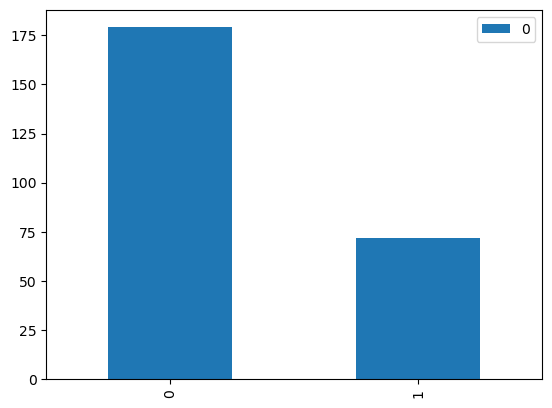

In [6]:
state_counts = Counter(df_combined['ageing_class'])
df_state = pd.DataFrame.from_dict(state_counts, orient='index')
df_state.plot(kind='bar')

num=(df_state[0]/df_state[0].sum())**2

print("Population per class:{}".format(df_state))

print("Proportion Chance Criterion: {:0.2f}%".format(100*num.sum()))
print("1.25 * Proportion Chance Criterion: {:0.2f}%".format(1.25*100*num.sum()))
plt.show()

### EDA on raw dataset

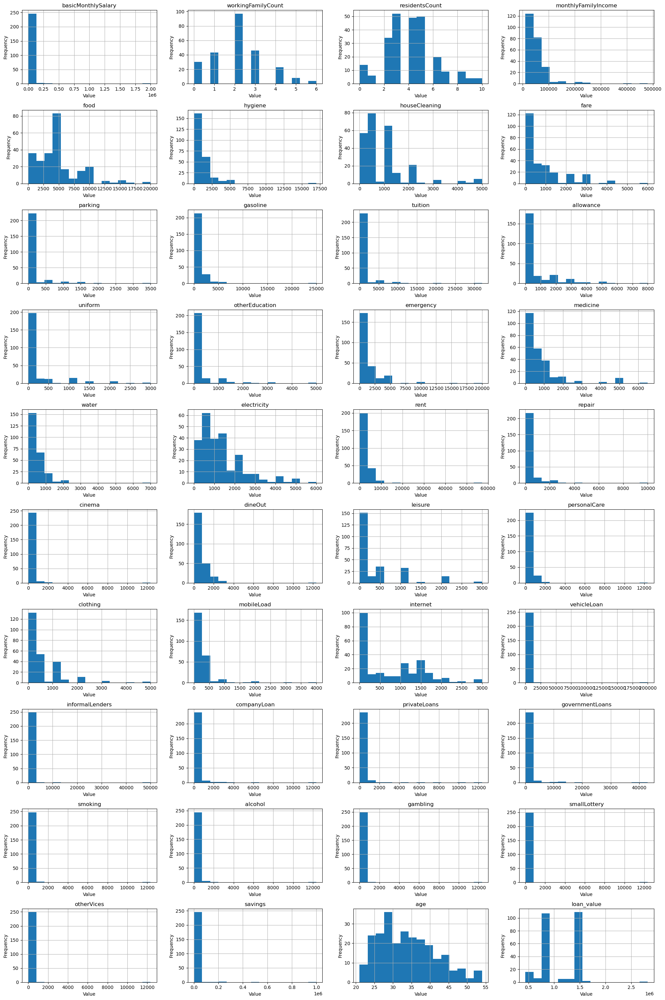

In [19]:
continuous_columns = ['basicMonthlySalary', 'workingFamilyCount', 'residentsCount', 'monthlyFamilyIncome', 
                      'food', 'hygiene',  'houseCleaning', 'fare', 'parking', 'gasoline', 'tuition', 
                      'allowance', 'uniform', 'otherEducation', 'emergency', 'medicine', 'water', 
                      'electricity', 'rent', 'repair', 'cinema', 'dineOut', 'leisure', 
                      'personalCare', 'clothing', 'mobileLoad', 'internet', 'vehicleLoan', 
                      'informalLenders', 'companyLoan', 'privateLoans', 'governmentLoans', 
                      'smoking', 'alcohol', 'gambling', 'smallLottery', 'otherVices', 'savings', 'age', 'loan_value'
                      ]

fig, axes = plt.subplots(10, 4, figsize=(20, 30))

for idx, col in enumerate(continuous_columns):
    ax = axes[idx // 4, idx % 4]
    df_combined[col].hist(ax=ax, bins=15)
    ax.set_title(col)
    
    # Labeling the x and y axes
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')
    
# Remove any empty subplots
for idx in range(len(continuous_columns), 40):
    fig.delaxes(axes.flatten()[idx])

plt.tight_layout()
plt.savefig('eda_raw.png', dpi=300)
plt.show()

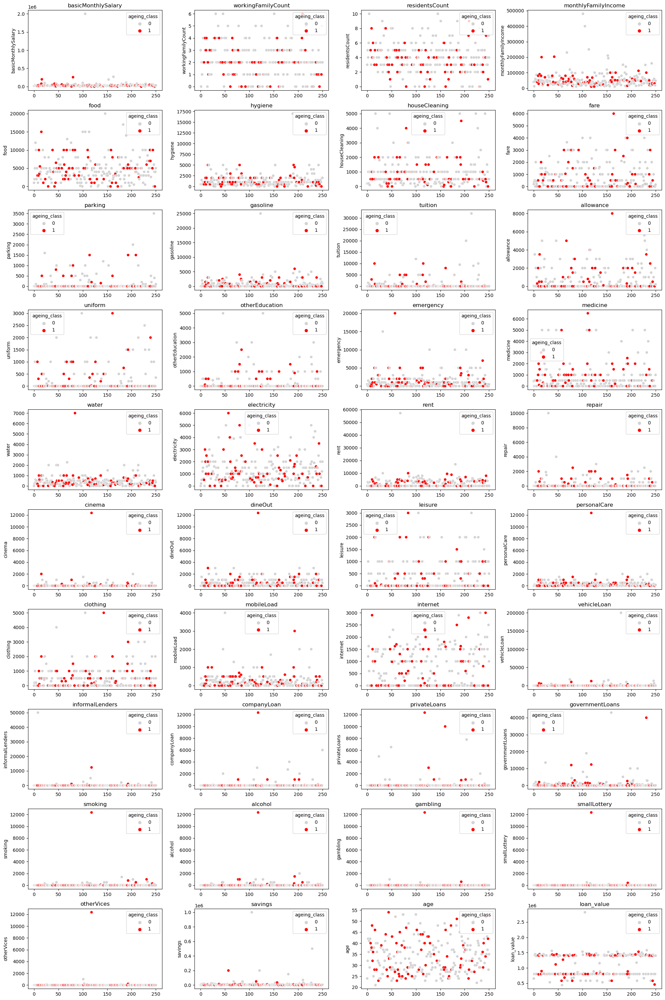

In [20]:
fig, axes = plt.subplots(10, 4, figsize=(20, 30))

# Define a custom color palette
palette = {0: 'lightgray', 1: 'red'}

for idx, col in enumerate(continuous_columns):
    ax = axes[idx // 4, idx % 4]
    
    # Create scatter plot with points colored by the ageing class using the custom palette
    sns.scatterplot(x=np.arange(len(df_combined[col])), y=df_combined[col], hue=df_combined['ageing_class'], ax=ax, palette=palette)
    
    ax.set_title(col)

# Remove any empty subplots
for idx in range(len(continuous_columns), 40):
    fig.delaxes(axes.flatten()[idx])

plt.tight_layout()
plt.savefig('class_raw.png', dpi=300)
plt.show()

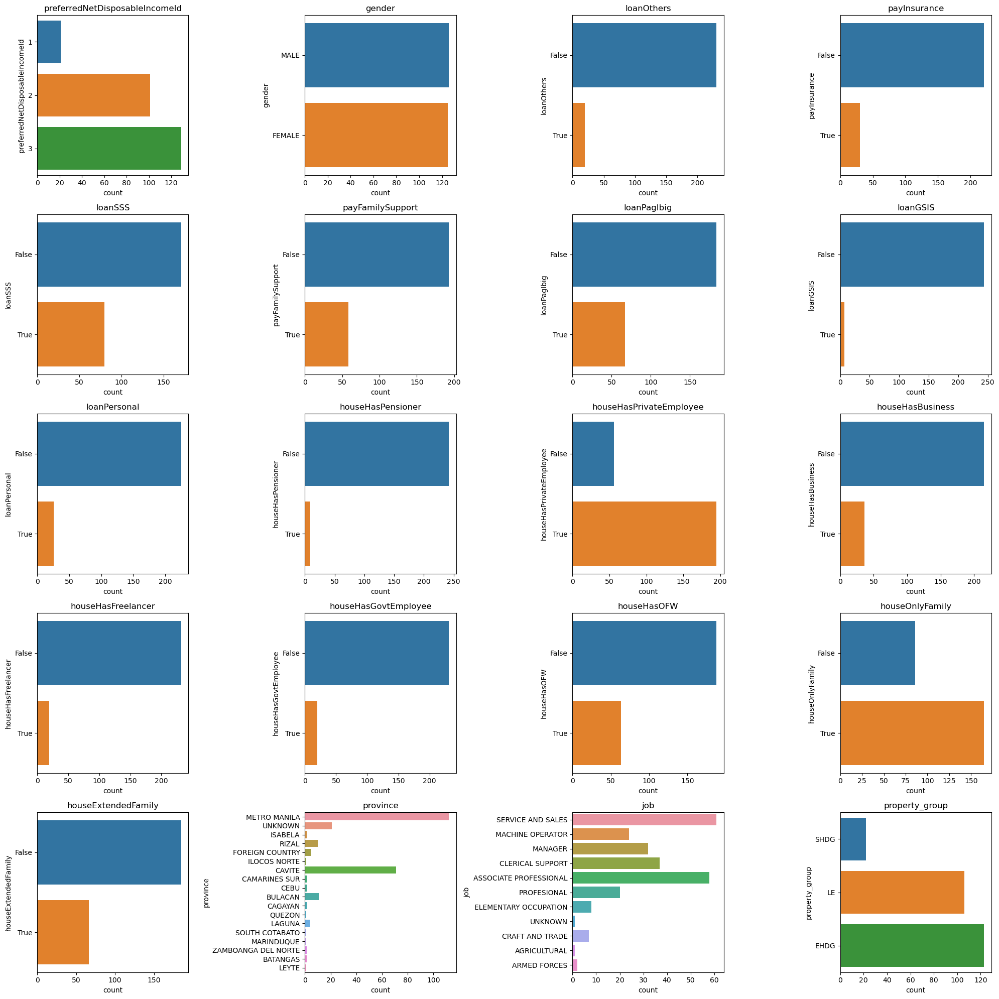

In [21]:
categorical_columns = ['preferredNetDisposableIncomeId', 'gender', 'loanOthers', 'payInsurance', 'loanSSS',
                       'payFamilySupport', 'loanPagIbig', 'loanGSIS', 'loanPersonal',
                       'houseHasPensioner', 'houseHasPrivateEmployee', 'houseHasBusiness', 'houseHasFreelancer', 
                       'houseHasGovtEmployee', 'houseHasOFW', 'houseOnlyFamily', 'houseExtendedFamily',
                       'province', 'job', 'property_group']

fig, axes = plt.subplots(5, 4, figsize=(20, 20))

for idx, col in enumerate(categorical_columns):
    ax = axes[idx // 4, idx % 4]
    sns.countplot(y=df_combined[col], ax=ax)
    ax.set_title(col)

# Remove any empty subplots
for idx in range(len(categorical_columns), 20):
    fig.delaxes(axes.flatten()[idx])

plt.tight_layout()
plt.savefig('categorical_raw.png', dpi=300)
plt.show()

/tmp/ipykernel_57668/1675904757.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_combined.corr()


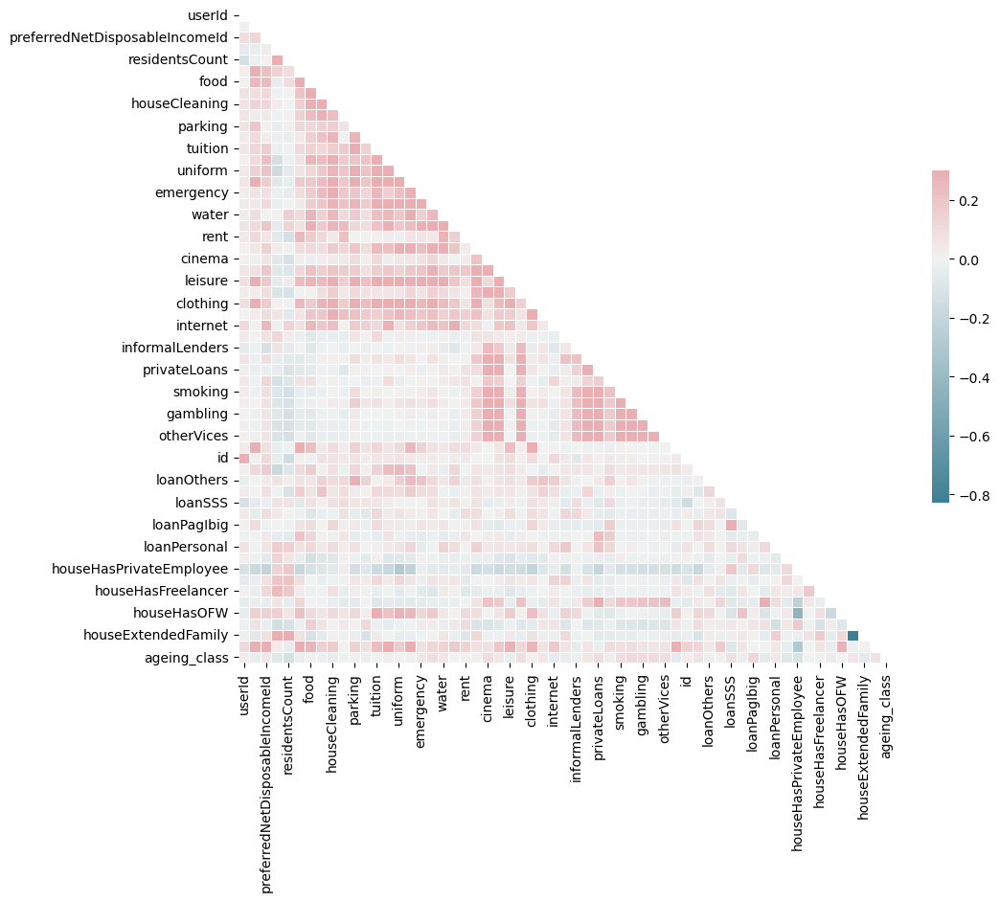

[('gambling', 'smallLottery', 0.9961546265783418),
 ('smallLottery', 'otherVices', 0.9953991941921801),
 ('gambling', 'otherVices', 0.992154647460432),
 ('smoking', 'gambling', 0.9811136032027008),
 ('smoking', 'smallLottery', 0.9810490167590084),
 ('smoking', 'otherVices', 0.9761216722796048),
 ('smoking', 'alcohol', 0.9682647963019225),
 ('alcohol', 'gambling', 0.9660926653670896),
 ('alcohol', 'smallLottery', 0.9646241967419544),
 ('alcohol', 'otherVices', 0.9595161378888936),
 ('cinema', 'otherVices', 0.9557311762944339),
 ('cinema', 'alcohol', 0.9545147701645146),
 ('cinema', 'gambling', 0.9528491877624305),
 ('cinema', 'smallLottery', 0.9498144181415943),
 ('cinema', 'smoking', 0.9456963780361475),
 ('userId', 'id', 0.9286806314348443),
 ('personalCare', 'alcohol', 0.9049830327620882),
 ('personalCare', 'gambling', 0.8984034038219766),
 ('personalCare', 'smallLottery', 0.8955227653090224),
 ('cinema', 'personalCare', 0.8951362635833454),
 ('personalCare', 'otherVices', 0.89319708

In [15]:
# Assuming df_combined is your dataframe
correlation_matrix = df_combined.corr()

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(correlation_matrix, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.show()

# Create an empty list to store the correlated pairs
highly_correlated_pairs = []

# Iterate over the pairs of columns
for i, column1 in enumerate(correlation_matrix.columns):
    for j, column2 in enumerate(correlation_matrix.columns):
        # We use j > i to avoid duplicate pairs and self-correlation
        if j > i:
            # Check if the correlation is greater than 0.50
            if abs(correlation_matrix.loc[column1, column2]) > 0.50:
                highly_correlated_pairs.append((column1, column2, correlation_matrix.loc[column1, column2]))

# Sort the pairs by the absolute value of their correlation in descending order
highly_correlated_pairs.sort(key=lambda x: -abs(x[2]))

# Return the list of highly correlated pairs
highly_correlated_pairs

## Data Cleaning and Preprocessing

### (1) Handling Missing Values

In [10]:
df_combined.isnull().sum().values != 0

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False])

### (2) Outlier Detection

In [22]:
continuous_columns = ['basicMonthlySalary', 'workingFamilyCount', 'residentsCount', 'monthlyFamilyIncome', 
                      'food', 'hygiene',  'houseCleaning', 'fare', 'parking', 'gasoline', 'tuition', 
                      'allowance', 'uniform', 'otherEducation', 'emergency', 'medicine', 'water', 
                      'electricity', 'rent', 'repair', 'cinema', 'dineOut', 'leisure', 
                      'personalCare', 'clothing', 'mobileLoad', 'internet', 'vehicleLoan', 
                      'informalLenders', 'companyLoan', 'privateLoans', 'governmentLoans', 
                      'smoking', 'alcohol', 'gambling', 'smallLottery', 'otherVices', 'savings', 'age', 'loan_value'
                      ]

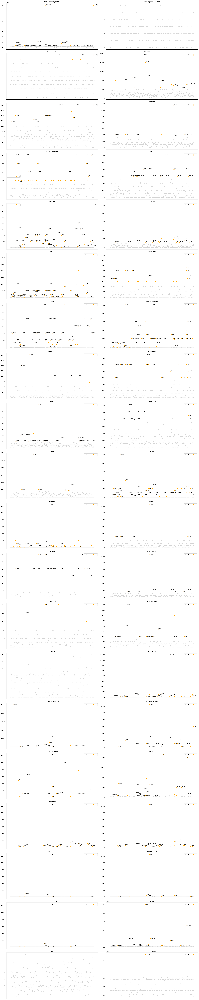

In [27]:
# scatter plots
n_cols = 2
n_rows = int(np.ceil(len(continuous_columns) / n_cols))

fig, ax = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

row = col = 0
for i in continuous_columns:
    outliers = iqr_outlier(df_combined[i], 1.5)

    if sum(outliers) == 0:
        sns.scatterplot(x=np.arange(len(df_combined[i])), y=df_combined[i], ax=ax[row, col], legend=False, color='lightgray')
    else:
        sns.scatterplot(x=np.arange(len(df_combined[i])), y=df_combined[i], ax=ax[row, col], hue=outliers, palette=['lightgray','orange'])
    for x, y in zip(np.arange(len(df_combined[i]))[outliers == 1], df_combined[i][outliers == 1]):
        ax[row, col].text(x=x, y=y, s=y, fontsize=8)
    ax[row, col].set_ylabel("")
    ax[row, col].set_title(i)
    ax[row, col].xaxis.set_visible(False)
    if sum(outliers) > 0:
        ax[row, col].legend(ncol=2)
    col += 1
    if col >= n_cols:
        col = 0
        row += 1

# Hide any empty subplots
for i in range(row, n_rows):
    for j in range(col, n_cols):
        fig.delaxes(ax[i][j])

plt.tight_layout()
plt.savefig('outliers.png', dpi=300)
plt.show()

### (3) Feature Engineering

#### gross_income simulation through average net_income to normalize those unusual values

In [18]:
df_combined['total_exp'] = df_combined[[
    'food', 'hygiene', 'houseCleaning', 'fare', 'parking', 
    'gasoline', 'tuition', 'allowance', 'uniform', 'otherEducation', 
    'emergency', 'medicine', 'water', 'electricity', 'rent', 
    'repair', 'cinema', 'dineOut', 'leisure', 'personalCare', 
    'clothing', 'mobileLoad', 'internet', 'vehicleLoan', 'informalLenders', 
    'companyLoan', 'privateLoans', 'governmentLoans', 'smoking', 
    'alcohol', 'gambling', 'smallLottery', 'otherVices'
]].sum(axis=1)

# average net income using the range provided by the Foundation
df_combined['net_income'] = df_combined['preferredNetDisposableIncomeId'].replace({
    1: 4250,
    2: 7800,
    3: 10000
})

# simulated gross_income
df_combined['sim_gross'] = df_combined[['total_exp', 'net_income']].sum(axis=1)
df_combined.loc[df_combined['basicMonthlySalary'] < 1000, 'basicMonthlySalary'] = df_combined.loc[df_combined['basicMonthlySalary'] < 1000, 'sim_gross']
df_combined.head()

,userId,fullName,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,id,firstName,lastName,age,gender,dateEntry,lastFirstName,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,province,address,job,occupation,property_group,loan_value,ageing_class,total_exp,net_income,sim_gross
0,370,howard ibali,19000,2,3,3,40000,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,2203,howard,ibali,24,MALE,4/22/22,"IBALI, HOWARD",False,False,False,False,False,False,False,False,True,False,False,False,True,False,True,METRO MANILA,1665 valencia compound brgy karuhatan val city,SERVICE AND SALES,PROMOTER,SHDG,652000.0,0,2950,7800,10750
1,1719,Elmer Oscares,21200,2,0,5,12000,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1342,Elmer,Oscares,32,MALE,4/4/22,"OSCARES, ELMER",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,UNKNOWN,oscares.elmer@gmail.com,MACHINE OPERATOR,MACHINE OPERATOR,LE,800000.0,0,8168,7800,15968
2,4090,Leonora Millares,40000,3,2,4,43000,5000,1500,1000,500,0,0,1500,3500,1000,0,1500,500,300,500,2600,0,0,1500,1000,200,1000,100,1200,0,0,0,0,0,0,0,0,0,0,12000,9270,Leonora,Millares,42,FEMALE,10/13/22,"MILLARES, LEONORA",False,False,False,False,False,False,False,False,True,False,False,False,True,True,False,ISABELA,Mabuhay angadanan isabela,SERVICE AND SALES,OFW,EHDG,1420000.0,0,24400,10000,34400
3,4568,Gwendolyn MORENO,30500,3,1,6,60000,12000,500,200,0,0,2000,0,0,0,0,0,0,600,2000,0,0,0,500,500,100,0,0,1625,0,0,0,0,0,0,0,0,0,0,500,3623,Gwendolyn,MORENO,36,FEMALE,5/22/22,"MORENO, GWENDOLYN",False,False,True,True,True,False,False,False,True,True,False,False,False,True,False,METRO MANILA,418 Area C PAROLa Binondo Manila,MANAGER,BILLING SUPERVISOR,EHDG,1449000.0,0,20025,10000,30025
4,5382,Mary Grace Sol,30000,2,2,10,56000,10000,500,1000,2000,100,900,1000,2000,0,500,500,500,300,1200,0,500,0,100,200,0,200,100,600,0,0,0,0,2000,0,0,0,0,0,5800,4272,Mary Grace,Sol,41,FEMALE,6/4/22,"SOL, MARY GRACE",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,RIZAL,B12 L20 Villa San Mateo 6 Dulong Bayan 2 San M...,CLERICAL SUPPORT,SENIOR ACCOUNTANT,LE,800000.0,0,24200,7800,32000


#### total expenses, rent, savings, and emergency ratios

In [19]:
# create columns for financial ratios
df_combined['totalexp_to_basicssalary_ratio'] = df_combined['total_exp'] / df_combined['basicMonthlySalary']
df_combined['rent_to_basicssalary_ratio'] = df_combined['rent'] / df_combined['basicMonthlySalary']
df_combined['savings_to_basicssalary_ratio'] = df_combined['savings'] / df_combined['basicMonthlySalary']

# create category for savings and emergency
conditions = [
    (df_combined['savings'] == df_combined['emergency']),  # Savings equal to emergency
    (df_combined['savings'] > df_combined['emergency']),   # Savings greater than emergency
    (df_combined['savings'] < df_combined['emergency']),   # Savings less than emergency
]

# Define the choices
choices = [
    'sufficient savings',   # Savings equal to emergency
    'sufficient savings',   # Savings greater than emergency
    'insufficient savings',      # Savings less than emergency
]

# Create the new column with np.select
df_combined['savings_to_emergency_category'] = np.select(conditions, choices, default='Uncategorized')
df_combined.head()

,userId,fullName,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,id,firstName,lastName,age,gender,dateEntry,lastFirstName,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,province,address,job,occupation,property_group,loan_value,ageing_class,total_exp,net_income,sim_gross,totalexp_to_basicssalary_ratio,rent_to_basicssalary_ratio,savings_to_basicssalary_ratio,savings_to_emergency_category
0,370,howard ibali,19000,2,3,3,40000,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,2203,howard,ibali,24,MALE,4/22/22,"IBALI, HOWARD",False,False,False,False,False,False,False,False,True,False,False,False,True,False,True,METRO MANILA,1665 valencia compound brgy karuhatan val city,SERVICE AND SALES,PROMOTER,SHDG,652000.0,0,2950,7800,10750,0.155263,0.000000,0.105263,sufficient savings
1,1719,Elmer Oscares,21200,2,0,5,12000,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1342,Elmer,Oscares,32,MALE,4/4/22,"OSCARES, ELMER",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,UNKNOWN,oscares.elmer@gmail.com,MACHINE OPERATOR,MACHINE OPERATOR,LE,800000.0,0,8168,7800,15968,0.385283,0.141509,0.023585,sufficient savings
2,4090,Leonora Millares,40000,3,2,4,43000,5000,1500,1000,500,0,0,1500,3500,1000,0,1500,500,300,500,2600,0,0,1500,1000,200,1000,100,1200,0,0,0,0,0,0,0,0,0,0,12000,9270,Leonora,Millares,42,FEMALE,10/13/22,"MILLARES, LEONORA",False,False,False,False,False,False,False,False,True,False,False,False,True,True,False,ISABELA,Mabuhay angadanan isabela,SERVICE AND SALES,OFW,EHDG,1420000.0,0,24400,10000,34400,0.610000,0.065000,0.300000,sufficient savings
3,4568,Gwendolyn MORENO,30500,3,1,6,60000,12000,500,200,0,0,2000,0,0,0,0,0,0,600,2000,0,0,0,500,500,100,0,0,1625,0,0,0,0,0,0,0,0,0,0,500,3623,Gwendolyn,MORENO,36,FEMALE,5/22/22,"MORENO, GWENDOLYN",False,False,True,True,True,False,False,False,True,True,False,False,False,True,False,METRO MANILA,418 Area C PAROLa Binondo Manila,MANAGER,BILLING SUPERVISOR,EHDG,1449000.0,0,20025,10000,30025,0.656557,0.000000,0.016393,sufficient savings
4,5382,Mary Grace Sol,30000,2,2,10,56000,10000,500,1000,2000,100,900,1000,2000,0,500,500,500,300,1200,0,500,0,100,200,0,200,100,600,0,0,0,0,2000,0,0,0,0,0,5800,4272,Mary Grace,Sol,41,FEMALE,6/4/22,"SOL, MARY GRACE",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,RIZAL,B12 L20 Villa San Mateo 6 Dulong Bayan 2 San M...,CLERICAL SUPPORT,SENIOR ACCOUNTANT,LE,800000.0,0,24200,7800,32000,0.806667,0.000000,0.193333,sufficient savings


#### ratio of existing total loans (excluding possible monthly amortization) to basic monthly salary

In [20]:
loans_features = ['vehicleLoan', 'informalLenders', 'companyLoan', 'privateLoans', 'governmentLoans']

df_combined['loans_to_gross_salary_ratio'] = (df_combined[loans_features].sum(axis=1)) / df_combined['basicMonthlySalary']

#### loan and interest related to the property

In [21]:
df_combined.property_group.unique()

array(['SHDG', 'LE', 'EHDG'], dtype=object)

In [22]:
# Initialize the new columns
df_combined['interest'] = None
df_combined['monthly_amortization'] = None

# Apply the conditions to fill the new columns
df_combined.loc[(df_combined['basicMonthlySalary'] <= 15000) & (df_combined['property_group'] == 'SHDG'), ['interest', 'monthly_amortization']] = [0.03, 2866]
df_combined.loc[(df_combined['basicMonthlySalary'] > 15000) & (df_combined['property_group'] == 'SHDG'), ['interest', 'monthly_amortization']] = [0.06375, 4219]
df_combined.loc[df_combined['property_group'] == 'LE', ['interest', 'monthly_amortization']] = [0.06375, 5511]
df_combined.loc[df_combined['property_group'] == 'EHDG', ['interest', 'monthly_amortization']] = [0.06375, 9921]

df_combined['monthly_amortization'] = df_combined['monthly_amortization'].astype('float')

# compute nominal interest and interest coverage ratio
df_combined['nominal_interest'] = ((df_combined['interest']/12) * df_combined['loan_value']).astype('float')
df_combined['interest_coverage_ratio'] = (df_combined['net_income'] / df_combined['nominal_interest']).astype('float')

# compute net income to monthly amortization
df_combined['ndi_amortization_ratio'] = (df_combined['net_income'] / df_combined['monthly_amortization']).astype('float')
df_combined.head()

,userId,fullName,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,id,firstName,lastName,age,gender,dateEntry,lastFirstName,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,province,address,job,occupation,property_group,loan_value,ageing_class,total_exp,net_income,sim_gross,totalexp_to_basicssalary_ratio,rent_to_basicssalary_ratio,savings_to_basicssalary_ratio,savings_to_emergency_category,loans_to_gross_salary_ratio,interest,monthly_amortization,nominal_interest,interest_coverage_ratio,ndi_amortization_ratio
0,370,howard ibali,19000,2,3,3,40000,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,2203,howard,ibali,24,MALE,4/22/22,"IBALI, HOWARD",False,False,False,False,False,False,False,False,True,False,False,False,True,False,True,METRO MANILA,1665 valencia compound brgy karuhatan val city,SERVICE AND SALES,PROMOTER,SHDG,652000.0,0,2950,7800,10750,0.155263,0.000000,0.105263,sufficient savings,0.000000,0.06375,4219.0,3463.7500,2.251895,1.848779
1,1719,Elmer Oscares,21200,2,0,5,12000,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1342,Elmer,Oscares,32,MALE,4/4/22,"OSCARES, ELMER",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,UNKNOWN,oscares.elmer@gmail.com,MACHINE OPERATOR,MACHINE OPERATOR,LE,800000.0,0,8168,7800,15968,0.385283,0.141509,0.023585,sufficient savings,0.041321,0.06375,5511.0,4250.0000,1.835294,1.415351
2,4090,Leonora Millares,40000,3,2,4,43000,5000,1500,1000,500,0,0,1500,3500,1000,0,1500,500,300,500,2600,0,0,1500,1000,200,1000,100,1200,0,0,0,0,0,0,0,0,0,0,12000,9270,Leonora,Millares,42,FEMALE,10/13/22,"MILLARES, LEONORA",False,False,False,False,False,False,False,False,True,False,False,False,True,True,False,ISABELA,Mabuhay angadanan isabela,SERVICE AND SALES,OFW,EHDG,1420000.0,0,24400,10000,34400,0.610000,0.065000,0.300000,sufficient savings,0.000000,0.06375,9921.0,7543.7500,1.325601,1.007963
3,4568,Gwendolyn MORENO,30500,3,1,6,60000,12000,500,200,0,0,2000,0,0,0,0,0,0,600,2000,0,0,0,500,500,100,0,0,1625,0,0,0,0,0,0,0,0,0,0,500,3623,Gwendolyn,MORENO,36,FEMALE,5/22/22,"MORENO, GWENDOLYN",False,False,True,True,True,False,False,False,True,True,False,False,False,True,False,METRO MANILA,418 Area C PAROLa Binondo Manila,MANAGER,BILLING SUPERVISOR,EHDG,1449000.0,0,20025,10000,30025,0.656557,0.000000,0.016393,sufficient savings,0.000000,0.06375,9921.0,7697.8125,1.299070,1.007963
4,5382,Mary Grace Sol,30000,2,2,10,56000,10000,500,1000,2000,100,900,1000,2000,0,500,500,500,300,1200,0,500,0,100,200,0,200,100,600,0,0,0,0,2000,0,0,0,0,0,5800,4272,Mary Grace,Sol,41,FEMALE,6/4/22,"SOL, MARY GRACE",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,RIZAL,B12 L20 Villa San Mateo 6 Dulong Bayan 2 San M...,CLERICAL SUPPORT,SENIOR ACCOUNTANT,LE,800000.0,0,24200,7800,32000,0.806667,0.000000,0.193333,sufficient savings,0.066667,0.06375,5511.0,4250.0000,1.835294,1.415351


#### ratio between working and residents count

In [23]:
df_combined['workingFamilyCount'] = df_combined['workingFamilyCount'].replace(0, 1)
df_combined['residentsCount'] = df_combined['residentsCount'].replace(0, 1)

mask = df_combined['workingFamilyCount'] > df_combined['residentsCount']
df_combined.loc[mask, 'workingFamilyCount'] = df_combined.loc[mask, 'residentsCount']

df_combined['working_resident_ratio'] = df_combined['workingFamilyCount'] / df_combined['residentsCount']
df_combined.head()

,userId,fullName,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,id,firstName,lastName,age,gender,dateEntry,lastFirstName,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,province,address,job,occupation,property_group,loan_value,ageing_class,total_exp,net_income,sim_gross,totalexp_to_basicssalary_ratio,rent_to_basicssalary_ratio,savings_to_basicssalary_ratio,savings_to_emergency_category,loans_to_gross_salary_ratio,interest,monthly_amortization,nominal_interest,interest_coverage_ratio,ndi_amortization_ratio,working_resident_ratio
0,370,howard ibali,19000,2,3,3,40000,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,2203,howard,ibali,24,MALE,4/22/22,"IBALI, HOWARD",False,False,False,False,False,False,False,False,True,False,False,False,True,False,True,METRO MANILA,1665 valencia compound brgy karuhatan val city,SERVICE AND SALES,PROMOTER,SHDG,652000.0,0,2950,7800,10750,0.155263,0.000000,0.105263,sufficient savings,0.000000,0.06375,4219.0,3463.7500,2.251895,1.848779,1.000000
1,1719,Elmer Oscares,21200,2,1,5,12000,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1342,Elmer,Oscares,32,MALE,4/4/22,"OSCARES, ELMER",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,UNKNOWN,oscares.elmer@gmail.com,MACHINE OPERATOR,MACHINE OPERATOR,LE,800000.0,0,8168,7800,15968,0.385283,0.141509,0.023585,sufficient savings,0.041321,0.06375,5511.0,4250.0000,1.835294,1.415351,0.200000
2,4090,Leonora Millares,40000,3,2,4,43000,5000,1500,1000,500,0,0,1500,3500,1000,0,1500,500,300,500,2600,0,0,1500,1000,200,1000,100,1200,0,0,0,0,0,0,0,0,0,0,12000,9270,Leonora,Millares,42,FEMALE,10/13/22,"MILLARES, LEONORA",False,False,False,False,False,False,False,False,True,False,False,False,True,True,False,ISABELA,Mabuhay angadanan isabela,SERVICE AND SALES,OFW,EHDG,1420000.0,0,24400,10000,34400,0.610000,0.065000,0.300000,sufficient savings,0.000000,0.06375,9921.0,7543.7500,1.325601,1.007963,0.500000
3,4568,Gwendolyn MORENO,30500,3,1,6,60000,12000,500,200,0,0,2000,0,0,0,0,0,0,600,2000,0,0,0,500,500,100,0,0,1625,0,0,0,0,0,0,0,0,0,0,500,3623,Gwendolyn,MORENO,36,FEMALE,5/22/22,"MORENO, GWENDOLYN",False,False,True,True,True,False,False,False,True,True,False,False,False,True,False,METRO MANILA,418 Area C PAROLa Binondo Manila,MANAGER,BILLING SUPERVISOR,EHDG,1449000.0,0,20025,10000,30025,0.656557,0.000000,0.016393,sufficient savings,0.000000,0.06375,9921.0,7697.8125,1.299070,1.007963,0.166667
4,5382,Mary Grace Sol,30000,2,2,10,56000,10000,500,1000,2000,100,900,1000,2000,0,500,500,500,300,1200,0,500,0,100,200,0,200,100,600,0,0,0,0,2000,0,0,0,0,0,5800,4272,Mary Grace,Sol,41,FEMALE,6/4/22,"SOL, MARY GRACE",False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,RIZAL,B12 L20 Villa San Mateo 6 Dulong Bayan 2 San M...,CLERICAL SUPPORT,SENIOR ACCOUNTANT,LE,800000.0,0,24200,7800,32000,0.806667,0.000000,0.193333,sufficient savings,0.066667,0.06375,5511.0,4250.0000,1.835294,1.415351,0.200000


#### province

In [26]:
df_combined.province.value_counts()

METRO MANILA           112
CAVITE                  71
UNKNOWN                 21
BULACAN                 11
RIZAL                   10
FOREIGN COUNTRY          5
LAGUNA                   4
CAMARINES SUR            2
CEBU                     2
ISABELA                  2
CAGAYAN                  2
ZAMBOANGA DEL NORTE      2
BATANGAS                 2
ILOCOS NORTE             1
QUEZON                   1
SOUTH COTABATO           1
MARINDUQUE               1
LEYTE                    1
Name: province, dtype: int64

In [8]:
df_combined['province_category'] = df_combined['province'].apply(
    lambda x: x if x in ['METRO MANILA', 
                         'CAVITE', 
                         'UNKNOWN', 
                         'BULACAN', 
                         'FOREIGN COUNTRY'] else 'OTHER PROVINCES')

#### others

In [26]:
df_combined.columns

Index(['userId', 'fullName', 'basicMonthlySalary',
       'preferredNetDisposableIncomeId', 'workingFamilyCount',
       'residentsCount', 'monthlyFamilyIncome', 'food', 'hygiene',
       'houseCleaning', 'fare', 'parking', 'gasoline', 'tuition', 'allowance',
       'uniform', 'otherEducation', 'emergency', 'medicine', 'water',
       'electricity', 'rent', 'repair', 'cinema', 'dineOut', 'leisure',
       'personalCare', 'clothing', 'mobileLoad', 'internet', 'vehicleLoan',
       'informalLenders', 'companyLoan', 'privateLoans', 'governmentLoans',
       'smoking', 'alcohol', 'gambling', 'smallLottery', 'otherVices',
       'savings', 'id', 'firstName', 'lastName', 'age', 'gender', 'dateEntry',
       'lastFirstName', 'loanOthers', 'payInsurance', 'loanSSS',
       'payFamilySupport', 'loanPagIbig', 'loanGSIS', 'loanPersonal',
       'houseHasPensioner', 'houseHasPrivateEmployee', 'houseHasBusiness',
       'houseHasFreelancer', 'houseHasGovtEmployee', 'houseHasOFW',
       'houseOnlyF

In [9]:
cols_to_drop = [
    'id', 'fullName', 'preferredNetDisposableIncomeId', 'firstName', 
    'lastName', 'dateEntry', 'occupation', 'lastFirstName', 'province', 
    'address']

dataset = df_combined.drop(cols_to_drop, axis=1)

boolean_columns = [col for col in dataset.columns if dataset[col].dtype == bool]
dataset[boolean_columns] = dataset[boolean_columns].apply(lambda x: x.astype('int64'))

columns_to_move = ['age', 'gender', 'province_category', 'job']
columns_remaining = [col for col in dataset.columns if col not in columns_to_move]

new_column_order = columns_to_move + columns_remaining
dataset = dataset[new_column_order]
dataset.insert(0, 'userId', dataset.pop('userId'))

In [10]:
# Convert all non-numeric columns to categorical
for column in dataset.columns:
    if dataset[column].dtype == 'object':
        dataset[column] = dataset[column].astype('category')

for column in dataset.columns:
    if dataset[column].dtype.name == 'category':
        print(column, dataset[column].nunique())

gender 2
province_category 6
job 11
property_group 3


In [11]:
# One-hot encoding of categorical columns
dataset = pd.get_dummies(dataset, columns=['gender'], prefix='gender', drop_first='True')
dataset = pd.get_dummies(dataset, columns=['province_category'], prefix='province')
dataset = pd.get_dummies(dataset, columns=['job'], prefix='job')
dataset = pd.get_dummies(dataset, columns=['property_group'], prefix='group', drop_first='True')
# dataset = pd.get_dummies(dataset, columns=['savings_to_emergency_category'], prefix='excess', drop_first='True')

### EDA including engineered features

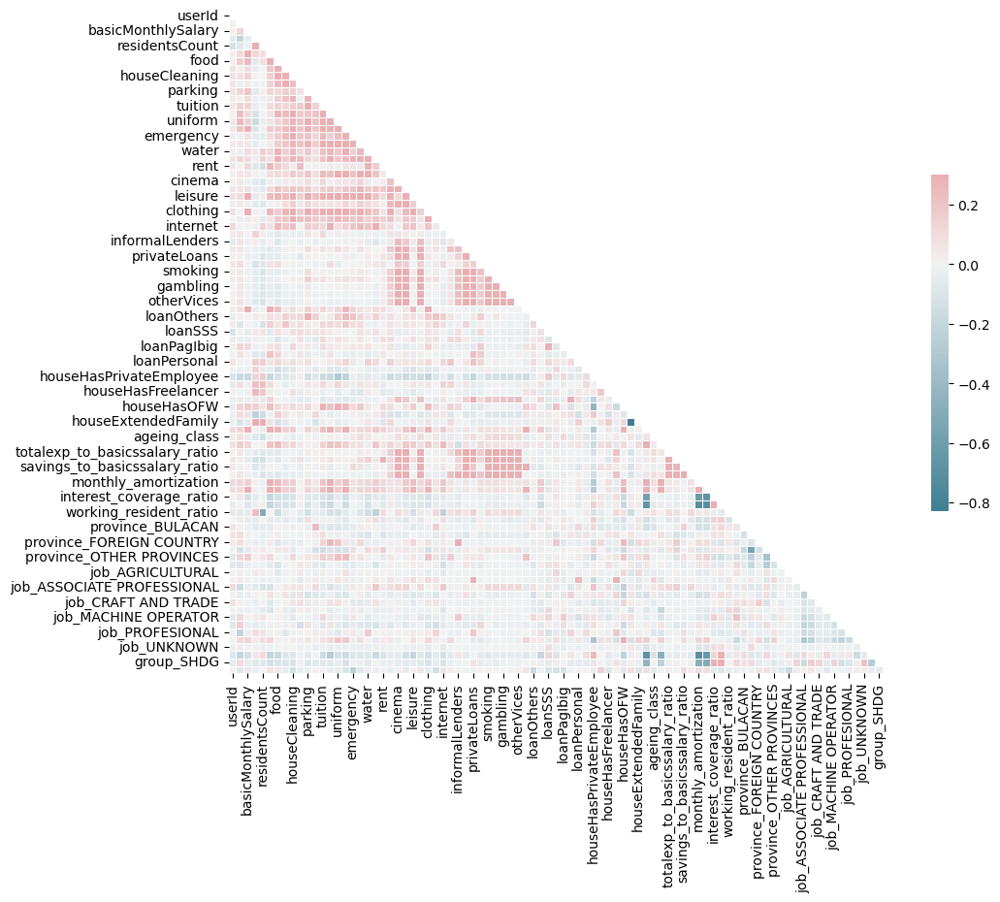

[('gambling', 'smallLottery', 0.9961546265783418),
 ('smallLottery', 'otherVices', 0.9953991941921801),
 ('gambling', 'otherVices', 0.992154647460432),
 ('loan_value', 'nominal_interest', 0.9904319841486022),
 ('smallLottery', 'totalexp_to_basicssalary_ratio', 0.9860682543192807),
 ('otherVices', 'totalexp_to_basicssalary_ratio', 0.9834833297337257),
 ('smallLottery', 'loans_to_gross_salary_ratio', 0.9832987932491787),
 ('gambling', 'totalexp_to_basicssalary_ratio', 0.9825778995826762),
 ('totalexp_to_basicssalary_ratio',
  'loans_to_gross_salary_ratio',
  0.9817724019488212),
 ('otherVices', 'loans_to_gross_salary_ratio', 0.9817046563518832),
 ('smoking', 'gambling', 0.9811136032027008),
 ('smoking', 'smallLottery', 0.9810490167590084),
 ('gambling', 'loans_to_gross_salary_ratio', 0.9796127576504269),
 ('smoking', 'otherVices', 0.9761216722796048),
 ('smoking', 'totalexp_to_basicssalary_ratio', 0.9689343072594384),
 ('smoking', 'alcohol', 0.9682647963019225),
 ('smoking', 'loans_to_gr

In [35]:
# Assuming df_combined is your dataframe
correlation_matrix = dataset.corr()

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(correlation_matrix, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.show()

# Create an empty list to store the correlated pairs
highly_correlated_pairs = []

# Iterate over the pairs of columns
for i, column1 in enumerate(correlation_matrix.columns):
    for j, column2 in enumerate(correlation_matrix.columns):
        # We use j > i to avoid duplicate pairs and self-correlation
        if j > i:
            # Check if the correlation is greater than 0.95
            if abs(correlation_matrix.loc[column1, column2]) > 0.95:
                highly_correlated_pairs.append((column1, column2, correlation_matrix.loc[column1, column2]))

# Sort the pairs by the absolute value of their correlation in descending order
highly_correlated_pairs.sort(key=lambda x: -abs(x[2]))

# Return the list of highly correlated pairs
highly_correlated_pairs

In [13]:
ho_t02 = dataset.copy()

In [14]:
ho_t02.head()

,userId,age,basicMonthlySalary,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,loan_value,ageing_class,gender_MALE,province_BULACAN,province_CAVITE,province_FOREIGN COUNTRY,province_METRO MANILA,province_OTHER PROVINCES,province_UNKNOWN,job_AGRICULTURAL,job_ARMED FORCES,job_ASSOCIATE PROFESSIONAL,job_CLERICAL SUPPORT,job_CRAFT AND TRADE,job_ELEMENTARY OCCUPATION,job_MACHINE OPERATOR,job_MANAGER,job_PROFESIONAL,job_SERVICE AND SALES,job_UNKNOWN,group_LE,group_SHDG
0,370,24,19000,3,3,40000,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,652000.0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1
1,1719,32,21200,0,5,12000,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,800000.0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0
2,4090,42,40000,2,4,43000,5000,1500,1000,500,0,0,1500,3500,1000,0,1500,500,300,500,2600,0,0,1500,1000,200,1000,100,1200,0,0,0,0,0,0,0,0,0,0,12000,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,1420000.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0
3,4568,36,30500,1,6,60000,12000,500,200,0,0,2000,0,0,0,0,0,0,600,2000,0,0,0,500,500,100,0,0,1625,0,0,0,0,0,0,0,0,0,0,500,0,0,1,1,1,0,0,0,1,1,0,0,0,1,0,1449000.0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
4,5382,41,30000,2,10,56000,10000,500,1000,2000,100,900,1000,2000,0,500,500,500,300,1200,0,500,0,100,200,0,200,100,600,0,0,0,0,2000,0,0,0,0,0,5800,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,800000.0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0


In [12]:
import category_encoders as ce
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

In [15]:
# Columns to scale, starting from 'age' and excluding 'home_ownership_class'
cols_to_scale = ho_t02.columns.tolist()  # Adjust according to your exact requirements
cols_to_scale.remove('ageing_class')

# Initialize the scaler
scaler = MinMaxScaler()

# Fit and transform the data and replace in the original data frame
ho_t02[cols_to_scale] = scaler.fit_transform(ho_t02[cols_to_scale])

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=nan, test=nan) total time=   0.1s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTEENN(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNei

[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 7/10] END

[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.204, test=0.200) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.347, test=0.000) total time=   0.0s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.388, test=0.200) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, sco

[CV 6/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.833, test=0.667) total time=   0.0s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.208, test=0.167) total time=   0.0s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(

[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.714, test=0.600) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.633, test=0.400) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.438, test=0.167) total time=   0.0s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.583, test=0.500) total time=   0.0s
[CV 

[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.800) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=0.694, test=0.400) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=0.429, test=0.

[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.857, test=0.800) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.938, test=0.833) total time=   0.0s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.667) total time=   0.0s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(

[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTEENN(random_state=0);, score=(train=0.714, test=0.400) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTEENN(random_state=0);, score=(train=0.857, test=0.400) total time=   0.0s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTEENN(random_state=0);, score=(train=0.878, test=1.000) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTEENN(random_state=0);, score=(train=0.796, test=0.800) total time=

[CV 8/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.625, test=0.333) total time=   0.0s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__crit

[CV 9/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time= 

[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=na

[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.918, test=0.800) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.469, test=0.400) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.812, test=0.833) total time=   0.0s
[CV 6

[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.167, test=0.167) total time=   0.0s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.000, test=0.000) total time=   0.0s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.286, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.388, test=0.000) total time=   0.0s
[CV 2/10] END clas

[CV 9/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.939, test=0.800) total time=   0.0s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.551, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=TomekLinks();, score=(train=0.367, test=0.000) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=TomekLinks();, score=(train=0.122, test=0.000) total time=   0.0s
[CV 3/10] END

[CV 4/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.408, test=0.200) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.979, test=0.667) total time=   0.0s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.667, test=0.500) total time=   0.0s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.653, test=0.400) total time=   0.0s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.667, test=0.667) total time=   0.0s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.812, test=0.500) total time=   0.0s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.714, test=0.000) total time

[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.633, test=0.800) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.469, test=0.000) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.633, test=0.400) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.938, test=0.6

[CV 6/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, t

[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.673, test=0.000) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.837, test=0.800) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=na

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.792, test=0.667) total time=   0.0s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.750, test=0.333) total time=   0.0s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.694, test=0.600) total time=   

[CV 9/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.571, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.800) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.531, test=0.400) total time=   0.0s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.4

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.857, test=0.400) total time=   0.0s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.694, test=0.400) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=1.000) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, sco

[CV 4/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.857, test=1.000) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.875, test=0.667) total time=   0.0s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.833, test=0.500) total time=   0.0s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(

[CV 4/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.612, test=0.600) total time=   0.0s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.750, test=0.167) total time=   0.0s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.562, test=0.333) total time=   0.0s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=0.898, test=0.000) total time=  

[CV 3/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.400) total time=   0.0s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.796, test=0.600) total time=   0.0s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.776, test=0.400) total time=   0.0s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.571, test=0.000) total time=   

[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, sc

[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 5/10] END classifier__criterion=entropy,

[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.204, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.000, test=0.000) total time

[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.265, test=0.000) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.571, test=0.200) total time=   0.0s
[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.896, test=0.500) total time=   0.0s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(tr

[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.771, test=0.333) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.396, test=0.167) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.800) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.959, test=1

[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.449, test=0.200) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.347, test=0.400) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.755, test=0.600) total time=   0.0s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.612, tes

[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.367, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.367, test=0.000) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.633, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.8

[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.592, test=0.200) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.531, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.571, test=0.800) total time=   0.0s
[CV 1/10

[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.792, test=0.500) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.688, test=0.500) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.612, test=0.400) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.816, test=0.400

[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.469, test=0.800) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.592, test=0.600) total time=   0.0s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.612, test=0.400) total time=   0.0s
[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_st

[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.857, test=0.800) total

[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.292, test=0.167) total time=   0.0s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.271, test=0.000) total time=   0.0s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.896, test=0.833) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_st

[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.604, test=0.333) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.125, test=0.000) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.367, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.367, test=0.000) total time

[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.125, test=0.167) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.083, test=0.000) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.102, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.163, test=0.000) total time=   0.0s
[CV 1/10] END classifier__c

[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.429, test=0.000) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.653, test=0.400) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.592, test=0.400) total time=   0.0s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.592, test=0.

[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.571, test=0.800) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.510, test=0.200) total time=   0.0s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.694, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, sco

[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, sco

[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=nan, test=nan) total t

[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.776, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.714, test=0.600) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.600) total time=   0.0s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_st

[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.000) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.510, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.714, test=0.400) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.755, test=1.000) to

[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.694, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.571, test=0.200) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.633, test=0.400) total time=   0.0s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_sta

[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.667) total time=   0.0s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.938, test=0.333) total time=   0.0s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.875, test=0.167) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=

[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s


[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.896, test=0.167) total time=   0.0s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.400) total time=   0.0s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_stat

[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=nan, test=nan) total tim

[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.327, test=0.000) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.388, test=0.200) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.224, test=0.600) total time=   0.0s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(tr

[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.531, test=0.200) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.735, test=1.000) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.714, test=0.600) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.633,

[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.510, test=0.400) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.833) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.250, tes

[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.833, test=0.500) total time=   0.0s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.542, test=0.167) total time=   0.0s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.816, test=0.600) total time=   0.0s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomUnderSampler(rand

[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.729, test=0.500) total time=   0.0s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.469, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.592, test=0.200) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=0.367,

[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.604, test=0.333) total time=   0.0s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.729, test=0.500) total time=   0.0s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.469, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=0.592

[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=nan, test=nan) total time=   0.0s
[CV 5/10] END classifier__criterion=log_

[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.612, test=0.400) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.469, test=0.200) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.510, test=0.200) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.375, test=0.500) total t

[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.449, test=0.200) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.735, test=0.400) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.375, test=0.500) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.812,

[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.146, test=0.000) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.354, test=0.167) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.688, test=0.333) total time=   0.0s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.125, test=0.000) tot

[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.673, test=0.400) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.469, test=0.000) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.551, test=0.200) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.438,

[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.918, test=0.800) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.633, test=0.400) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.800) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.653, test=

[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.469, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=SMOTE(random_state=0);, score=(train=0.327, test=0.000) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.531, test=0.200) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.633, test=0.000) tota

[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=nan, test=nan) total time=   0.0s


[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=SMOTETomek(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=EditedNearestNeighbours();, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, score=(train=nan, test=nan) total ti

[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);,

[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, sco

[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.625, test=0.500) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.854, test=0.833) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.604, test=0.333) total time=   0.0s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_st

[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.592, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.490, test=0.600) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=EditedNearestNeighbours();, score=(train=0.653, test=0.200) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=EditedNearestNeighbours();, score=(train=0.796, 


4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2194 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/jedalvin/anaconda3/lib/python3.11/site-packages/imblearn/pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/base.py", line 1145, in wrapper
    estimator._validate_params()
  File "/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': SMOTEENN(random_state=0)}
Best Validation Score (G-mean): 0.8066666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTEENN(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        max_features='sqrt', random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 21.15411925315857 secs
Run 1 - Random State: 0
Test G-mean: 0.6055300708194984
Best Threshold=0.857143, G-Mean=0.606


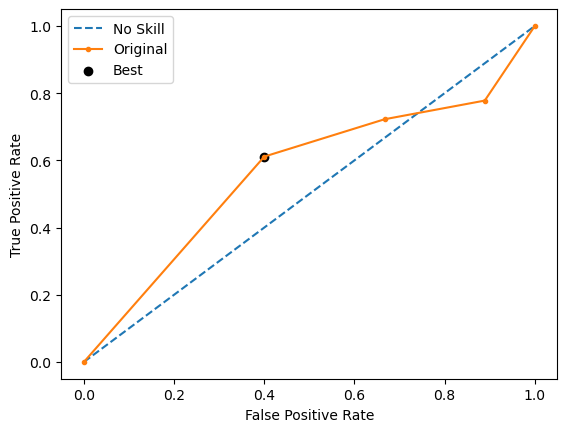

Run 2 - Random State: 1
Test G-mean: 0.38490017945975047
Best Threshold=0.714286, G-Mean=0.385


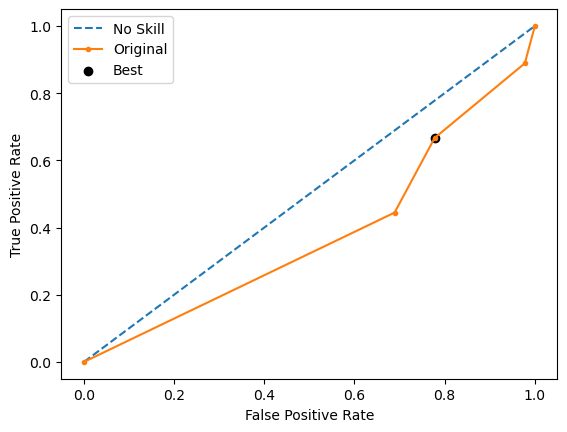

Run 3 - Random State: 2
Test G-mean: 0.25819888974716115
Best Threshold=0.891892, G-Mean=0.556


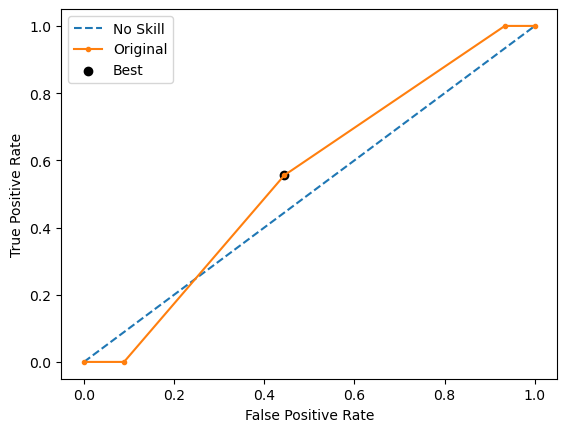

Run 4 - Random State: 3
Test G-mean: 0.47140452079103173
Best Threshold=0.928571, G-Mean=0.471


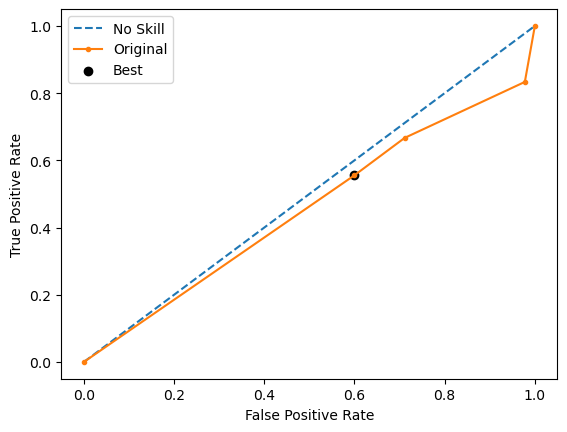

Run 5 - Random State: 4
Test G-mean: 0.4554200340426488
Best Threshold=0.904110, G-Mean=0.507


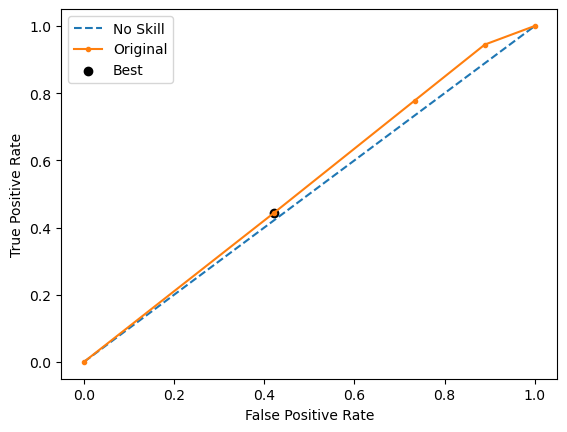

Ave Test G-mean: 0.4350907389720181
Stdev Test G-mean: 0.12707414707074294
Ave Test Specificity: 0.31111111111111106
Ave Test Recall: 0.7222222222222221
Ave Test NPV: 0.7722850678733032
Ave Test Accuracy: 0.42857142857142855
Ave Test Precision: 0.30055442089191176
Ave Test F1-Score: 0.4186519863115607
Ave Runtime: 0.028037309646606445


In [16]:
ho_t02_dt_gs, ho_t02_dt_be, ho_t02_dt_model_info, ho_t02_dt_metrics_df = dt_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.837, test=0.200) total time=   0.0s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.306, test=0.000) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.200) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min

[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.604, test=0.500) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.771, test=0.667) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.583, test=0.000) total time=   0.0s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.500, test=0.000) tot

[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.714, test=0.200) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.646, test=0.167) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.542, test=0.333) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, resampling=RandomOverSampler(random_st

[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=EditedNearestNeighbours();, score=(train=0.429, test=0.200) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.204, test=0.000) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.653, test=0.400) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.306, test=0.200) total time=   0.0s
[CV 4/10] 

[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.571, test=0.000) total time=   0.0s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.939, test=0.400) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.714, test=0.200) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=RandomOverSampler(random_st

[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.510, test=0.200) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.408, test=0.000) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.271, test=0.167) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.229, test=0.000) total time=   0.0s
[CV 7/10] END classifier

[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=TomekLinks();, score=(train=0.612, test=0.600) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=TomekLinks();, score=(train=0.646, test=0.500) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=TomekLinks();, score=(train=0.792, test=0.667) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=2, resampling=TomekLinks();, score=(train=0.812, test=0.000) total time=   0.0s
[CV 8/10] END classifier

[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.796, test=0.600) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.600) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.708, test=0.000) total time=   0.0s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=1, classifier__min_samples_split=3, resampling=ADASYN(random_state=0);, score=(train=0.771, test=0.667) tot

[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTEENN(random_state=0);, score=(train=0.735, test=0.200) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.857, test=0.400) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=SMOTETomek(random_state=0);, score=(train=0.673, test=0.200) total time=   0.0s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.592, test=0.600) to

[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.200) total time=   0.0s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.939, test=1.000) total time=   0.0s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=2, classifier__min_samples_split=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.938, test=0.333) total time=   0.0s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=2, resampling=ADASYN(random_state=0);, sc

[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.633, test=0.600) total time=   0.0s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=TomekLinks();, score=(train=0.694, test=0.400) total time=   0.0s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.938, test=0.667) total time=   0.0s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=5, classifier__max_features=None, classifier__min_samples_leaf=3, classifier__min_samples_split=3, resampling=RandomUnderSampler(random_state=0);, score=(train=0.854, test=0.333)

[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.898, test=0.400) total time=   0.1s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.1s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.400) total time=   0.1s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estim

[CV 8/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.167) total time=   0.1s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.735, test=0.000) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=

[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.633, test=0.200) total time=   0.2s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.612, test=0.200) total time=   0.2s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.2s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classi

[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.592, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.200) total time=   0.1s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators

[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.200) total time=   0.1s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.592, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.200) total time=   0.1s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, clas

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.400) total time=   0.2s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.1s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=0.939, test=0.600) total time=   0.1s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_est

[CV 7/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.167) total time=   0.2s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.167) total time=   0.2s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.562, test=0.333) total time=   0.1s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_

[CV 7/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.896, test=0.667) total time=   0.2s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.667, test=0.167) total time=   0.2s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.857, test=0.600) total time=   0.2s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_esti

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.837, test=0.200) total time=   0.2s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.500, test=0.167) total time=   0.1s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.542, test=0.167) total time=   0.2s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=20

[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.600) total time=   0.1s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.857, test=0.400) total time=   0.1s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.633, test=0.200) total time=   0.2s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier_

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.776, test=0.600) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.400) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier

[CV 7/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.167) total time=   0.2s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.167) total time=   0.2s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.796, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n

[CV 3/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.939, test=0.800) total time=   0.1s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.857, test=0.800) total time=   0.1s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.667, test=0.167) total time=   0.2s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__

[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.837, test=0.200) total time=   0.1s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.878, test=0.000) total time=   0.1s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.896, test=0.667) total time=   0.1s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, cla

[CV 5/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.2s
[CV 6/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.958, test=0.667) total time=   0.2s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.958, test=0.500) total time=   0.2s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estim

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.939, test=0.400) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.694, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.000) total time=   0.2s
[CV 5/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimator

[CV 4/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.878, test=1.000) total time=   0.1s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.694, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.000) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators

[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.958, test=0.167) total time=   0.2s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.604, test=0.167) total time=   0.2s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.646, test=0.333) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimator

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.959, test=0.200) total time=   0.1s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.200) total time=   0.1s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.000) total time=   0.1s
[CV 9/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimator

[CV 10/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.980, test=0.400) total time=   0.1s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.604, test=0.167) total time=   0.1s
[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.646, test=0.333) total time=   0.1s
[CV 7/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimato

[CV 3/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.200) total time=   0.2s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.592, test=0.200) total time=   0.2s
[CV 3/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.2s
[CV 4/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, cla

[CV 8/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.938, test=0.333) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.200) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.000) total time=   0.1s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators

[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.673, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.000) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.878, test=0.200) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=3

[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.980, test=0.800) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.857, test=0.600) total time=   0.2s
[CV 2/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.939, test=0.400) total time=   0.2s
[CV 1/10] END classifier__criterion=gini, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier

[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=0.854, test=0.667) total time=   0.1s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.800) total time=   0.1s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, clas

[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.776, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.837, test=0.200) total time=   0.2s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.510, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, cla

[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.854, test=0.167) total time=   0.2s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.500, test=0.167) total time=   0.1s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.583, test=0.333) total time=   0.1s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__

[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.688, test=0.500) total time=   0.1s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.600) total time=   0.1s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.400) total time=   0.1s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, cla

[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.521, test=0.500) total time=   0.2s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.667, test=0.500) total time=   0.2s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.776, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_

[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.816, test=1.000) total time=   0.2s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.592, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.735, test=0.000) total time=   0.2s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier_

[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=0.854, test=0.667) total time=   0.1s
[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.812, test=0.167) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, clas

[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.200) total time=   0.1s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.521, test=0.167) total time=   0.2s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.542, test=0.167) total time=   0.2s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_

[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.612, test=0.400) total time=   0.1s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, c

[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.833, test=0.500) total time=   0.1s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.792, test=0.333) total time=   0.1s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.500, test=0.333) total time=   0.2s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3,

[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.000) total time=   0.2s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.592, test=0.200) total time=   0.2s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.200) total time=   0.2s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimato

[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.694, test=0.400) total time=   0.2s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.854, test=0.167) total time=   0.2s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.333) total time=   0.2s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, 

[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.688, test=0.500) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.708, test=0.500) total time=   0.1s
[CV 7/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.854, test=0.167) total time=   0.1s
[CV 8/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier_

[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.714, test=0.000) total time=   0.2s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.980, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.800) total time=   0.2s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estima

[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.896, test=0.667) total time=   0.1s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.551, test=0.200) total time=   0.1s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estim

[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.612, test=0.200) total time=   0.1s
[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.688, test=0.500) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.708, test=0.500) total time=   0.1s
[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimator

[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.918, test=0.600) total time=   0.2s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.2s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.755, test=0.200) total time=   0.2s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=

[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.755, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.571, test=0.200) total time=   0.1s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=0.980, test=0.600) total time=   0.1s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estim

[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.000) total time=   0.2s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.980, test=0.600) total time=   0.2s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.980, test=1.000) total time=   0.2s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estima

[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.667) total time=   0.2s
[CV 9/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.200) total time=   0.2s
[CV 10/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.551, test=0.200) total time=   0.2s
[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n

[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.812, test=0.667) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.812, test=0.667) total time=   0.1s
[CV 5/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.646, test=0.500) total time=   0.1s
[CV 6/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, cla

[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.694, test=0.400) total time=   0.1s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.857, test=0.200) total time=   0.1s
[CV 2/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.857, test=0.200) total time=   0.1s
[CV 1/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, 

[CV 3/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.857, test=0.400) total time=   0.2s
[CV 4/10] END classifier__criterion=entropy, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.878, test=0.200) total time=   0.2s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.571, test=0.200) total time=   0.1s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, 

[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.200) total time=   0.1s
[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.729, test=0.167) total time=   0.1s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.750, test=0.333) total time=   0.1s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2

[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.600) total time=   0.2s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.878, test=0.600) total time=   0.2s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.592, test=0.400) total time=   0.2s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split

[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.500, test=0.500) total time=   0.2s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.688, test=0.500) total time=   0.2s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.600) total time=   0.2s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier

[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.633, test=0.400) total time=   0.1s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.600) total time=   0.1s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.400) total time=   0.1s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split

[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.167) total time=   0.2s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.333) total time=   0.2s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.200) total time=   0.2s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=

[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.898, test=0.600) total time=   0.1s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.800) total time=   0.1s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.816, test=1.000) total time=   0.1s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_spl

[CV 7/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.938, test=0.667) total time=   0.2s
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.854, test=0.167) total time=   0.2s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=EditedNearestNeighbours();, score=(train=0.939, test=0.600) total time=   0.1s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_sp

[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.646, test=0.500) total time=   0.2s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.857, test=0.400) total time=   0.2s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.2s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_sp

[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.633, test=0.200) total time=   0.2s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.510, test=0.200) total time=   0.2s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.600) total time=   0.2s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier_

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.73
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=2,
                                        min_samples_leaf=2, n_estimators=200,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.7720532171201814
Std Train Score (G-mean) 0.06156770601805013
GridSearchCV Runtime: 80.76365303993225 secs
Run 1 - Random State: 0
Test G-mean: 0.3442651863295481
Best Threshold=0.525373, G-Mean=0.458


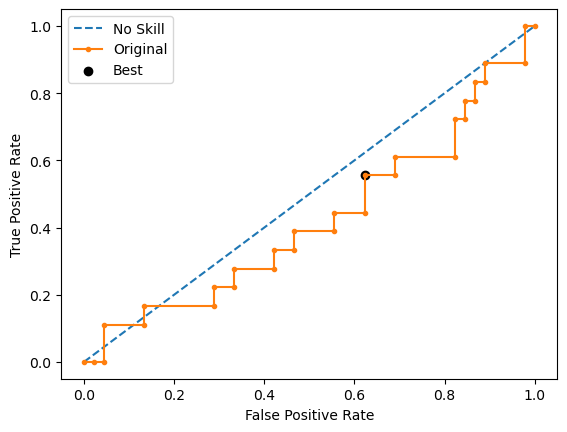

Run 2 - Random State: 1
Test G-mean: 0.415739709641549
Best Threshold=0.525476, G-Mean=0.497


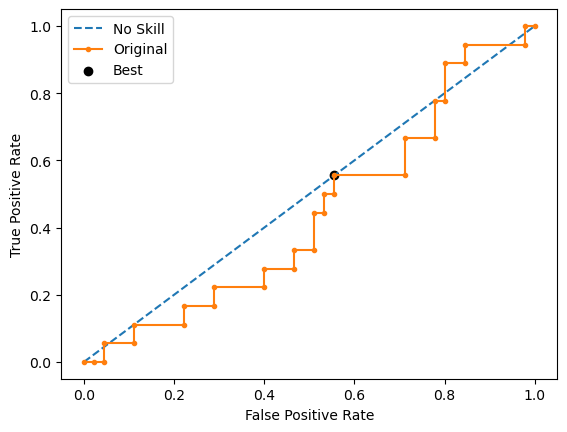

Run 3 - Random State: 2
Test G-mean: 0.5962847939999439
Best Threshold=0.537843, G-Mean=0.670


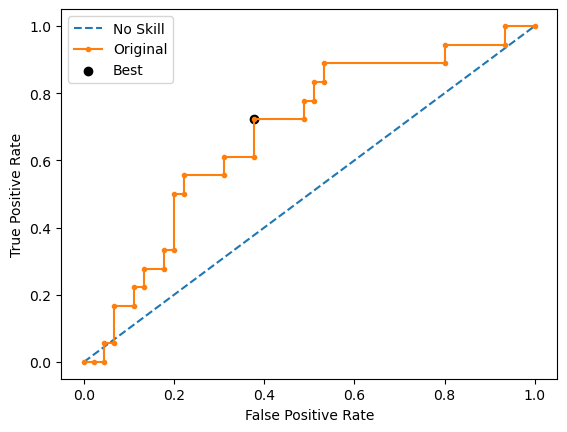

Run 4 - Random State: 3
Test G-mean: 0.5163977794943222
Best Threshold=0.551389, G-Mean=0.553


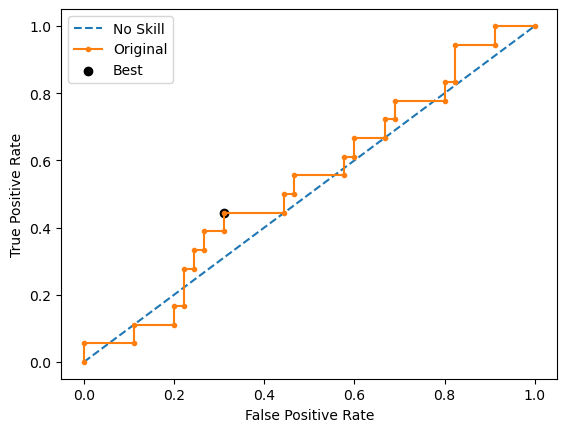

Run 5 - Random State: 4
Test G-mean: 0.6186404847588913
Best Threshold=0.500408, G-Mean=0.619


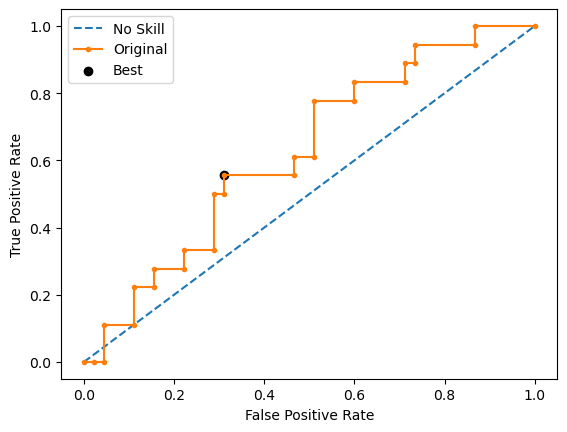

Ave Test G-mean: 0.4982655908448509
Stdev Test G-mean: 0.11721060233235547
Ave Test Specificity: 0.39555555555555555
Ave Test Recall: 0.6666666666666666
Ave Test NPV: 0.7305328005328005
Ave Test Accuracy: 0.473015873015873
Ave Test Precision: 0.3170504791645704
Ave Test F1-Score: 0.42380505555503756
Ave Runtime: 0.09810600280761719


In [17]:
ho_t02_rf_gs, ho_t02_rf_be, ho_t02_rf_model_info, ho_t02_rf_metrics_df = rf_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
[CV 8/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.812, test=0.333) total time=   0.1s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.959, test=0.600) total time=   0.2s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.980, test=0.200) total time=   0.1s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_de

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklea

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=5.52257e-23): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase th

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py

[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=0.600) total time=   0.2s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.939, test=0.600) total time=   0.2s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.200) total time=   0.2s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=8.77893e-23): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase th

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=2.278e-23): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=4.07377e-22): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/

[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.896, test=0.667) total time=   0.2s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.918, test=0.800) total time=   0.2s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.898, test=1.000) total time=   0.2s
[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_spl

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=6.6122e-23): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the

[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=SMOTE(random_state=0);, score=(train=0.612, test=0.200) total time=   0.2s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.800) total time=   0.1s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.918, test=0.800) total time=   0.1s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_es

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_

[CV 5/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.583, test=0.500) total time=   0.1s
[CV 6/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=ADASYN(random_state=0);, score=(train=0.708, test=0.500) total time=   0.1s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__oob_score=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.837, test=0.600) total time=   0.1s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classi

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py

[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.857, test=0.400) total time=   0.2s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.878, test=0.200) total time=   0.2s
[CV 3/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=300, classifier__oob_score=False, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.200) total time=   0.2s
[CV 4/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2,

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown i

_n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.959, test=0.400) total time=   0.1s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=EditedNearestNeighbours();, score=(train=0.980, test=1.000) total time=   0.1s
[CV 1/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.837, test=0.600) total time=   0.1s
[CV 2/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.918, test=0.400) total time= 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=6.22925e-23): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/

[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.755, test=0.200) total time=   0.2s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=ADASYN(random_state=0);, score=(train=0.592, test=0.200) total time=   0.1s
[CV 9/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, classifier__oob_score=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.200) total time=   0.1s
[CV 10/10] END classifier__criterion=log_loss, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifi

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Use

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/py

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear 

[CV 10/10] END classifier__C=1e-06, classifier__penalty=l2, classifier__solver=lbfgs, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.600) total time=   0.0s
[CV 3/10] END classifier__C=1e-06, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=0.265, test=0.600) total time=   0.0s
[CV 4/10] END classifier__C=1e-06, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=0.224, test=0.200) total time=   0.0s
[CV 5/10] END classifier__C=1e-06, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=0.312, test=0.000) total time=   0.0s
[CV 6/10] END classifier__C=1e-06, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=0.833, test=0.833) total time=   0.0s
[CV 5/10] END classifier__C=1e-06, classifier__penalty=l2, classifier__solver=newton-cholesk

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/py

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logis

[CV 9/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=ADASYN(random_state=0);, score=(train=0.551, test=0.000) total time=   0.0s
[CV 10/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=ADASYN(random_state=0);, score=(train=0.429, test=0.400) total time=   0.0s
[CV 1/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.735, test=0.400) total time=   0.0s
[CV 2/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.898, test=0.800) total time=   0.0s
[CV 3/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.837, test=0.600) total time=   0.0s
[CV 4/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNear

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=1.495e-22): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[CV 6/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.812, test=0.833) total time=   0.0s
[CV 7/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.729, test=0.667) total time=   0.0s
[CV 8/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.583, test=0.500) total time=   0.0s
[CV 9/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.837, test=0.800) total time=   0.0s
[CV 10/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=EditedNearestNeighbours();, score=(train=0.776, test=0.600) total time=   0.0s
[CV 1/10] END classifier__C=0.001, classifier__penalty=l2, classifier__solver=liblinear, resampling=Rand

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=1.40036e-22): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/U

[CV 4/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=lbfgs, resampling=ADASYN(random_state=0);, score=(train=0.837, test=0.800) total time=   0.0s
[CV 5/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=lbfgs, resampling=ADASYN(random_state=0);, score=(train=0.375, test=0.000) total time=   0.0s
[CV 6/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=lbfgs, resampling=ADASYN(random_state=0);, score=(train=0.854, test=0.833) total time=   0.0s
[CV 7/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=lbfgs, resampling=ADASYN(random_state=0);, score=(train=0.833, test=0.833) total time=   0.0s
[CV 8/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=lbfgs, resampling=ADASYN(random_state=0);, score=(train=0.875, test=1.000) total time=   0.0s
[CV 3/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_sta

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=1.2547e-22): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:


0s
[CV 4/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.286, test=0.200) total time=   0.0s
[CV 5/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.312, test=0.000) total time=   0.0s
[CV 6/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.812, test=0.833) total time=   0.0s
[CV 7/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.854, test=0.833) total time=   0.0s
[CV 8/10] END classifier__C=0.0001, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.229, test=0.167) total time=   0.0s
[CV 7/10] END classifi

e documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-lea

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=2.03463e-21): result may not be accurate.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/

[CV 5/10] END classifier__C=0.001, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.750, test=0.500) total time=   0.0s
[CV 6/10] END classifier__C=0.001, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.333) total time=   0.1s
[CV 7/10] END classifier__C=0.001, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.167) total time=   0.1s
[CV 8/10] END classifier__C=0.001, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.167) total time=   0.1s
[CV 9/10] END classifier__C=0.001, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.000) total time=   0.1s
[CV 10/10] END classifier

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[CV 10/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 1/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.200) total time=   0.1s
[CV 2/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.400) total time=   0.1s
[CV 3/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.857, test=0.000) total time=   0.1s
[CV 4/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.735, test=0.800) total time=   0.1s
[CV 5/10] END classifier__C=0.0001, classifier__penalty=None, classifier__sol

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the 

ver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.500) total time=   0.1s
[CV 6/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.771, test=0.333) total time=   0.1s
[CV 7/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.167) total time=   0.1s
[CV 8/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.167) total time=   0.1s
[CV 9/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.000) total time=   0.1s
[CV 10/10] END classifier__C=0.0001, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(trai

logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS R

[CV 2/10] END classifier__C=0.01, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=EditedNearestNeighbours();, score=(train=0.939, test=0.800) total time=   0.0s
[CV 3/10] END classifier__C=0.01, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=EditedNearestNeighbours();, score=(train=0.939, test=0.800) total time=   0.0s
[CV 4/10] END classifier__C=0.01, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=EditedNearestNeighbours();, score=(train=0.816, test=0.400) total time=   0.0s
[CV 9/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=liblinear, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 10/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=liblinear, resampling=RandomOverSampler(random_state=0);, score=(train=nan, test=nan) total time=   0.0s
[CV 1/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/py

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://s

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py

[CV 6/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=lbfgs, resampling=SMOTE(random_state=0);, score=(train=0.750, test=0.333) total time=   0.1s
[CV 7/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=lbfgs, resampling=SMOTE(random_state=0);, score=(train=0.812, test=0.167) total time=   0.1s
[CV 8/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=lbfgs, resampling=SMOTE(random_state=0);, score=(train=0.792, test=0.333) total time=   0.1s
[CV 9/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=lbfgs, resampling=SMOTE(random_state=0);, score=(train=0.796, test=0.000) total time=   0.1s
[CV 10/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=lbfgs, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.200) total time=   0.1s
[CV 1/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=lbfgs, resampling=ADASYN(random_state=0);, score=(train=0.75

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_

[CV 8/10] END classifier__C=0.1, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.646, test=0.667) total time=   0.0s
[CV 9/10] END classifier__C=0.1, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.694, test=0.200) total time=   0.0s
[CV 10/10] END classifier__C=0.1, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomOverSampler(random_state=0);, score=(train=0.633, test=0.200) total time=   0.0s
[CV 1/10] END classifier__C=0.1, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.796, test=0.200) total time=   0.0s
[CV 2/10] END classifier__C=0.1, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.200) total time=   0.0s
[CV 3/10] END classifier__C=0.1, classifie

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
 

[CV 3/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.816, test=0.000) total time=   0.1s
[CV 4/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.755, test=0.800) total time=   0.1s
[CV 5/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.792, test=0.500) total time=   0.1s
[CV 6/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.729, test=0.333) total time=   0.1s
[CV 7/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.812, test=0.167) total time=   0.1s
[CV 8/10] END classifier__C=0.01, classifier__penalty=None, classifier__solver=newton

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #13. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logi

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs i

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_

[CV 10/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=liblinear, resampling=SMOTE(random_state=0);, score=(train=0.714, test=0.200) total time=   0.0s
[CV 1/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=liblinear, resampling=ADASYN(random_state=0);, score=(train=0.735, test=0.000) total time=   0.0s
[CV 2/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=liblinear, resampling=ADASYN(random_state=0);, score=(train=0.755, test=0.200) total time=   0.0s
[CV 3/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=liblinear, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.200) total time=   0.0s
[CV 4/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=liblinear, resampling=ADASYN(random_state=0);, score=(train=0.735, test=0.600) total time=   0.0s
[CV 5/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=liblinear, resampling=ADASYN(random_state=0);, score=(

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_

[CV 5/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=0.958, test=0.500) total time=   0.0s
[CV 6/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=0.896, test=0.333) total time=   0.1s
[CV 7/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=0.896, test=0.500) total time=   0.1s
[CV 8/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=lbfgs, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 1/10] END classifier__C=100.0, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 2/10] END classifier__C=100.0, classifier__penalty=l2, classif

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklea

[CV 6/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.854, test=0.333) total time=   0.0s
[CV 7/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.875, test=0.500) total time=   0.0s
[CV 8/10] END classifier__C=1.0, classifier__penalty=l2, classifier__solver=newton-cholesky, resampling=RandomUnderSampler(random_state=0);, score=(train=0.896, test=0.667) total time=   0.0s
[CV 9/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=lbfgs, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 10/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=lbfgs, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 1/10] END classifier__C=1.0, classifier__penalty=None, classifier__so

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: Use

ewton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.792, test=0.333) total time=   0.1s
[CV 9/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.000) total time=   0.1s
[CV 10/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=ADASYN(random_state=0);, score=(train=0.735, test=0.200) total time=   0.1s
[CV 1/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.800) total time=   0.0s
[CV 2/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 3/10] END classifier__C=10.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=EditedNearestNeighbours();, score=(train=1.000, tes

[CV 5/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=SMOTE(random_state=0);, score=(train=0.750, test=0.667) total time=   0.1s
[CV 6/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=SMOTE(random_state=0);, score=(train=0.729, test=0.333) total time=   0.1s
[CV 7/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=SMOTE(random_state=0);, score=(train=0.792, test=0.167) total time=   0.1s
[CV 8/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=SMOTE(random_state=0);, score=(train=0.792, test=0.333) total time=   0.1s
[CV 9/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=newton-cholesky, resampling=SMOTE(random_state=0);, score=(train=0.776, test=0.200) total time=   0.1s
[CV 10/10] END classifier__C=1.0, classifier__penalty=None, classifier__solver=newton-cholesky,

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:195: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/py

[CV 10/10] END classifier__C=10.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.1s
[CV 1/10] END classifier__C=10.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.200) total time=   0.1s
[CV 2/10] END classifier__C=10.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.837, test=0.200) total time=   0.1s
[CV 3/10] END classifier__C=10.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.837, test=0.000) total time=   0.1s
[CV 4/10] END classifier__C=10.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.755, test=0.800) total time=   0.1s
[CV 5/10] END classifier__C=10.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=Ra

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #14. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/

[CV 10/10] END classifier__C=100.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.1s
[CV 1/10] END classifier__C=100.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.200) total time=   0.1s
[CV 2/10] END classifier__C=100.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.400) total time=   0.1s
[CV 3/10] END classifier__C=100.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.837, test=0.000) total time=   0.1s
[CV 4/10] END classifier__C=100.0, classifier__penalty=l2, classifier__solver=lbfgs, resampling=RandomOverSampler(random_state=0);, score=(train=0.694, test=0.800) total time=   0.1s
[CV 5/10] END classifier__C=100.0, classifier__penalty=l2, classifier__solver=lbfgs, resampl

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: Use

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_newton_solver.py:498: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Matrix is singular.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_glm/_

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: Conv

Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.8633333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 13.560516119003296 secs
Run 1 - Random State: 0
Test G-mean: 0.2721655269759087
Best Threshold=0.559561, G-Mean=0.494


/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(

650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/jedalvin/anaconda3/lib/python3.11/site-p

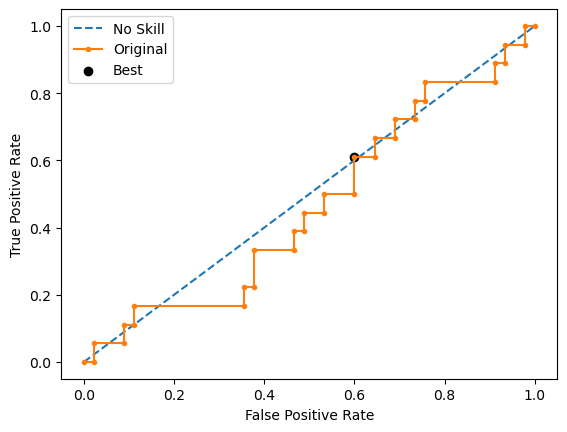

Run 2 - Random State: 1
Test G-mean: 0.37184890068181137
Best Threshold=0.537715, G-Mean=0.521


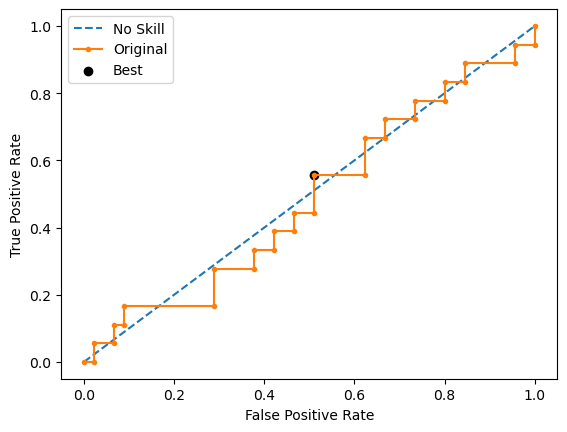

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.533908, G-Mean=0.598


invalid value encountered in scalar divide


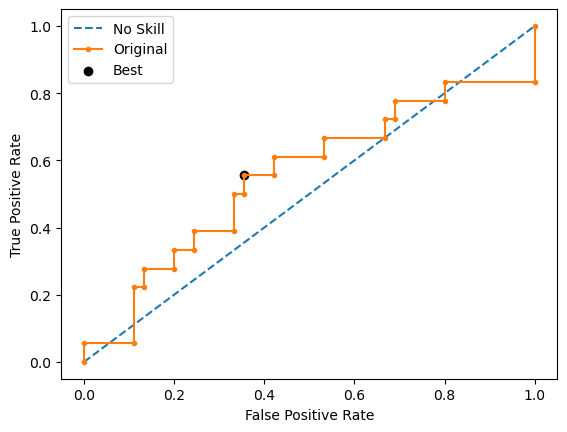

Run 4 - Random State: 3
Test G-mean: 0.2629368792488718
Best Threshold=0.523703, G-Mean=0.492


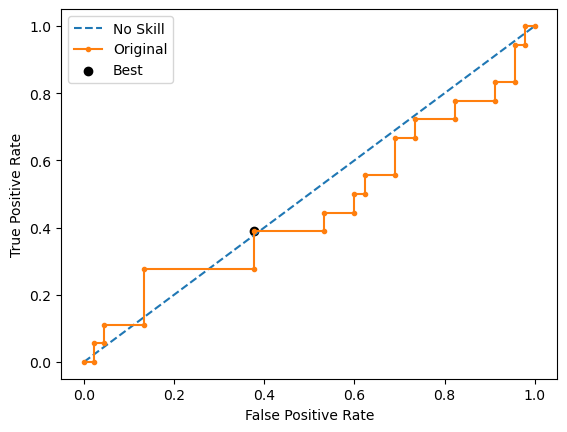

Run 5 - Random State: 4
Test G-mean: 0.0
Best Threshold=0.493732, G-Mean=0.565


Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


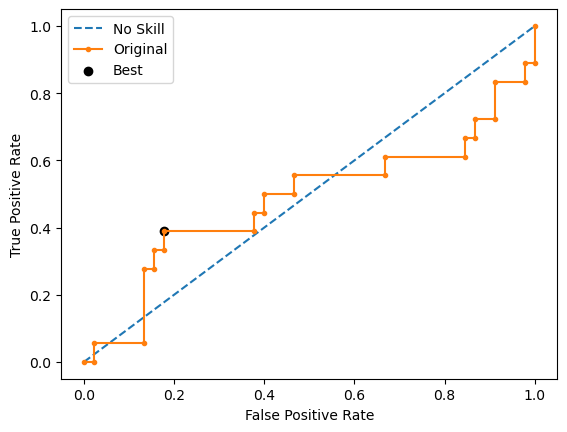

Ave Test G-mean: 0.18139026138131836
Stdev Test G-mean: 0.1710039084798696
Ave Test Specificity: 0.2666666666666667
Ave Test Recall: 0.7
Ave Test NPV: 0.6408730158730159
Ave Test Accuracy: 0.39047619047619053
Ave Test Precision: 0.22088263588263585
Ave Test F1-Score: 0.33557118762598215
Ave Runtime: 0.04379196166992187


In [18]:
ho_t02_logreg_gs, ho_t02_logreg_be, ho_t02_logreg_model_info, ho_t02_logreg_metrics_df = logreg_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits


/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


*
optimization finished, #iter = 95
obj = -0.000188, rho = 0.997698
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 96
obj = -0.000191, rho = 0.500264
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 95
obj = -0.000186, rho = 0.999251
nSV = 188, nBSV = 188
Total nSV = 188
*.
*
optimization finished, #iter = 310
obj = -0.000176, rho = -0.999750
nSV = 180, nBSV = 167
Total nSV = 180
*
optimization finished, #iter = 99
obj = -0.000181, rho = 0.999838
nSV = 184, nBSV = 181
Total nSV = 184
*
optimization finished, #iter = 128
obj = -0.000238, rho = -0.632236
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 115
obj = -0.000182, rho = 0.304165
nSV = 185, nBSV = 183
Total nSV = 185
*
optimization finished, #iter = 119
obj = -0.000186, rho = 0.281037
nSV = 189, nBSV = 186
Total nSV = 189
*
optimization finished, #iter = 145
obj = -0.000177, rho = 0.998279
nSV = 184, nBSV = 180
Total nSV = 184
*.
*
optimization finished, #iter = 

*
optimization finished, #iter = 38
obj = -0.000074, rho = 0.999840
nSV = 75, nBSV = 73
Total nSV = 75
*
optimization finished, #iter = 39
obj = -0.000076, rho = 0.999686
nSV = 77, nBSV = 75
Total nSV = 77
*.
*
optimization finished, #iter = 202
obj = -0.000185, rho = -0.999896
nSV = 188, nBSV = 183
Total nSV = 188
*
optimization finished, #iter = 39
obj = -0.000076, rho = 0.989444
nSV = 77, nBSV = 75
Total nSV = 77
*
optimization finished, #iter = 39
obj = -0.000074, rho = -0.961516
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 38
obj = -0.000074, rho = -0.943939
nSV = 74, nBSV = 74
Total nSV = 74
.*.*
optimization finished, #iter = 152
obj = -0.000054, rho = -0.987167
nSV = 56, nBSV = 52
Total nSV = 56
*
optimization finished, #iter = 111
obj = -0.000189, rho = 0.999279
nSV = 191, nBSV = 188
Total nSV = 191
*
optimization finished, #iter = 48
obj = -0.000096, rho = -0.161036
nSV = 96, nBSV = 96
Total nSV = 96
.*
optimization finished, #iter = 91
obj = -0.000058,

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

*
optimization finished, #iter = 121
obj = -0.000238, rho = -0.110326
nSV = 242, nBSV = 242
Total nSV = 242
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000230, rho = -0.998638
nSV = 235, nBSV = 227
Total nSV = 235
*
optimization finished, #iter = 33
obj = -0.000062, rho = 0.999945
nSV = 63, nBSV = 61
Total nSV = 63
*
optimization finished, #iter = 158
obj = -0.000238, rho = 0.981414
nSV = 240, nBSV = 237
Total nSV = 240
*
optimization finished, #iter = 130
obj = -0.000226, rho = -0.999287
nSV = 227, nBSV = 225
Total nSV = 227
*
optimization finished, #iter = 71
obj = -0.000088, rho = 0.999531
nSV = 90, nBSV = 85
Total nSV = 90
*
optimization finished, #iter = 133
obj = -0.000241, rho = -0.991906
nSV = 242, nBSV = 239
Total nSV = 242
*
optimization finished, #iter = 147
obj = -0.000239, rho = 0.975052
nSV = 240, nBSV = 238
Total nSV = 240
*
optimization finished, #iter = 199
obj = -0.000222, rho = -0.998693
nSV = 227, nBSV = 222
Total nSV = 227


*
optimization finished, #iter = 39
obj = -0.000078, rho = 1.000118
nSV = 78, nBSV = 78
Total nSV = 78
*
optimization finished, #iter = 39
obj = -0.000078, rho = -1.000145
nSV = 78, nBSV = 78
Total nSV = 78
*
optimization finished, #iter = 49
obj = -0.000096, rho = -1.000000
nSV = 97, nBSV = 95
Total nSV = 97
*
optimization finished, #iter = 95
obj = -0.000176, rho = -1.000296
nSV = 176, nBSV = 176
Total nSV = 176
*
optimization finished, #iter = 97
obj = -0.000194, rho = 1.000038
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 94
obj = -0.000180, rho = -1.000488
nSV = 180, nBSV = 180
Total nSV = 180
*
optimization finished, #iter = 96
obj = -0.000190, rho = 1.000000
nSV = 191, nBSV = 189
Total nSV = 191
*
optimization finished, #iter = 97
obj = -0.000182, rho = 0.999997
nSV = 185, nBSV = 178
Total nSV = 185
*
optimization finished, #iter = 94
obj = -0.000182, rho = 1.000000
nSV = 183, nBSV = 181
Total nSV = 183
*
optimization finished, #iter = 88
obj = -0.000176

*
optimization finished, #iter = 94
obj = -0.000188, rho = -1.000041
nSV = 188, nBSV = 188
Total nSV = 188
*
optimization finished, #iter = 39
obj = -0.000076, rho = 1.000016
nSV = 77, nBSV = 75
Total nSV = 77
*
optimization finished, #iter = 38
obj = -0.000076, rho = -0.999989
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 93
obj = -0.000184, rho = -1.000015
nSV = 184, nBSV = 184
Total nSV = 184
*
optimization finished, #iter = 39
obj = -0.000078, rho = 1.000000
nSV = 78, nBSV = 78
Total nSV = 78
*
optimization finished, #iter = 92
obj = -0.000184, rho = 1.000042
nSV = 184, nBSV = 184
Total nSV = 184
*
optimization finished, #iter = 121
obj = -0.000242, rho = 0.272634
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 38
obj = -0.000076, rho = -1.000448
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 39
obj = -0.000078, rho = -0.002442
nSV = 78, nBSV = 78
Total nSV = 78
*
optimization finished, #iter = 49
obj = -0.000098, rh

obj = -0.000186, rho = -0.999996
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 37
obj = -0.000074, rho = -0.999999
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 34
obj = -0.000068, rho = 0.999999
nSV = 68, nBSV = 68
Total nSV = 68
*
optimization finished, #iter = 37
obj = -0.000074, rho = -0.999998
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 48
obj = -0.000096, rho = -0.000000
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 95
obj = -0.000190, rho = 0.999996
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 99
obj = -0.000198, rho = 0.999998
nSV = 198, nBSV = 198
Total nSV = 198
*
optimization finished, #iter = 25
obj = -0.000050, rho = -1.000000
nSV = 50, nBSV = 50
Total nSV = 50
*
optimization finished, #iter = 121
*
optimization finished, #iter = 97
obj = -0.000242, rho = -0.000003
nSV = 242, nBSV = 242
Total nSV = 242
obj = -0.000194, rho = -0.999998
nSV = 194, nBSV = 194

*
optimization finished, #iter = 48
obj = -0.000096, rho = -0.000002
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 93
obj = -0.000186, rho = -0.999997
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 120
obj = -0.000240, rho = 0.999997
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 120
obj = -0.000240, rho = -0.000001
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 113
obj = -0.000226, rho = -0.999997
nSV = 226, nBSV = 226
Total nSV = 226
*
optimization finished, #iter = 121
obj = -0.000242, rho = 0.000003
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 48
obj = -0.000096, rho = -0.000001
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 121
obj = -0.000242, rho = 0.999995
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 121
obj = -0.000242, rho = -0.000002
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 120
obj

*
optimization finished, #iter = 94
obj = -0.000188, rho = -0.999994
nSV = 188, nBSV = 188
Total nSV = 188
*
optimization finished, #iter = 106
obj = -0.001745, rho = 0.996787
nSV = 179, nBSV = 173
Total nSV = 179
*
optimization finished, #iter = 93
obj = -0.000186, rho = 1.000000
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 93
obj = -0.000186, rho = -0.999996
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 95
obj = -0.000190, rho = 1.000000
*
optimization finished, #iter = 95
obj = -0.001848, rho = -0.512004
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 121
obj = -0.000242, rho = -0.000008
nSV = 242, nBSV = 242
Total nSV = 242
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 111
obj = -0.001653, rho = 0.999410
nSV = 173, nBSV = 168
Total nSV = 173
*
optimization finished, #iter = 97
obj = -0.000194, rho = 0.000004
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 125
ob

obj = -0.000859, rho = 0.995713
nSV = 88, nBSV = 83
Total nSV = 88
*
optimization finished, #iter = 136
obj = -0.002396, rho = 0.816177
nSV = 240, nBSV = 239
Total nSV = 240
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.002367, rho = -0.137527
nSV = 238, nBSV = 232
Total nSV = 238
.
*
optimization finished, #iter = 298
obj = -0.001976, rho = 0.963466
nSV = 200, nBSV = 197
Total nSV = 200
*
optimization finished, #iter = 123
obj = -0.002178, rho = -0.996632
nSV = 220, nBSV = 216
Total nSV = 220
...
*..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.001887, rho = -0.992129
nSV = 190, nBSV = 187
Total nSV = 190
.......*....*
optimization finished, #iter = 926
obj = -0.000733, rho = 0.321561
nSV = 76, nBSV = 72
Total nSV = 76
..*..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000692, rho = -0.808546
nSV = 73, nBSV = 68
Total nSV = 73
.
*
optimization finished, #iter = 147
o

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

..
*
optimization finished, #iter = 481
obj = -0.001849, rho = 0.990315
nSV = 188, nBSV = 184
Total nSV = 188
*.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.001759, rho = -0.996293
nSV = 184, nBSV = 171
Total nSV = 184
*
optimization finished, #iter = 56
obj = -0.000936, rho = -0.992346
nSV = 96, nBSV = 92
Total nSV = 96
....
*.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.001816, rho = 0.987190
nSV = 183, nBSV = 178
Total nSV = 183
*
optimization finished, #iter = 69
obj = -0.000753, rho = 0.999752
nSV = 77, nBSV = 73
Total nSV = 77
*
optimization finished, #iter = 185
obj = -0.002368, rho = -0.666503
nSV = 240, nBSV = 237
Total nSV = 240
*
optimization finished, #iter = 75
obj = -0.000748, rho = -0.862176
nSV = 76, nBSV = 74
Total nSV = 76
.
*
optimization finished, #iter = 140
obj = -0.000791, rho = 0.779740
nSV = 81, nBSV = 79
Total nSV = 81
*..
*
optimization finished, #iter = 181
obj = -0.000620, rho = 0

*
optimization finished, #iter = 37
obj = -0.000740, rho = -0.979315
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 36
obj = -0.000700, rho = -0.997395
nSV = 71, nBSV = 69
Total nSV = 71
*
optimization finished, #iter = 36
obj = -0.000720, rho = -0.991252
nSV = 72, nBSV = 72
Total nSV = 72
*
optimization finished, #iter = 34
obj = -0.000660, rho = -0.999858
nSV = 67, nBSV = 65
Total nSV = 67
*
optimization finished, #iter = 36
obj = -0.000700, rho = -0.999531
nSV = 71, nBSV = 69
Total nSV = 71
*
optimization finished, #iter = 44
obj = -0.000880, rho = 0.997341
nSV = 88, nBSV = 88
Total nSV = 88
*
optimization finished, #iter = 123
obj = -0.002395, rho = 1.000000
nSV = 242, nBSV = 240
Total nSV = 242
*
optimization finished, #iter = 125
obj = -0.002394, rho = 1.000000
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 37
obj = -0.000740, rho = 0.996436
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 38
obj = -0.000760, rho = 0

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

.996999
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 38
obj = -0.000760, rho = 0.888148
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 38
obj = -0.000732, rho = -1.000000
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 39
obj = -0.000733, rho = -1.000000
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 48
obj = -0.000952, rho = 0.545839
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 97
obj = -0.001934, rho = -0.431192
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 98
obj = -0.001914, rho = -0.999996
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 96
obj = -0.001900, rho = 0.979309
nSV = 191, nBSV = 189
Total nSV = 191
*
optimization finished, #iter = 126
obj = -0.002381, rho = 1.000000
nSV = 240, nBSV = 238
Total nSV = 240
*
optimization finished, #iter = 28
obj = -0.000540, rho = -1.000000
nSV = 55, nBSV = 53
Total nSV = 55
*
optimizati

*
optimization finished, #iter = 121
obj = -0.002420, rho = 0.999975
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 97
obj = -0.001940, rho = 0.000000
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 96
obj = -0.001920, rho = -0.999942
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 120
obj = -0.002400, rho = 0.000016
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 121
obj = -0.002420, rho = -0.000001
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 35
obj = -0.000700, rho = 0.999998
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 121
obj = -0.002420, rho = 0.999933
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 93
obj = -0.001860, rho = 0.999963
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 97
obj = -0.001940, rho = 0.000002
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 93
obj = -

*
optimization finished, #iter = 28
obj = -0.000560, rho = -0.999995
nSV = 56, nBSV = 56
Total nSV = 56
*
optimization finished, #iter = 97
obj = -0.001940, rho = 0.000003
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 45
*
optimization finished, #iter = 107
obj = -0.000880, rho = 0.999997
obj = -0.001900, rho = 1.000004
nSV = 190, nBSV = 190
nSV = 88, nBSV = 88
Total nSV = 190
Total nSV = 88
*
optimization finished, #iter = 28
obj = -0.000540, rho = -0.999999
nSV = 54, nBSV = 54
Total nSV = 54
*
optimization finished, #iter = 29
obj = -0.000560, rho = -0.999996
nSV = 56, nBSV = 56
Total nSV = 56
*
optimization finished, #iter = 29
obj = -0.000580, rho = -0.999996
nSV = 58, nBSV = 58
Total nSV = 58
*
optimization finished, #iter = 96
obj = -0.001820, rho = 0.999992
nSV = 182, nBSV = 182
Total nSV = 182
*
optimization finished, #iter = 35
obj = -0.000700, rho = 0.999995
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 97
obj = -0.001920, rho = 

*
optimization finished, #iter = 95
obj = -0.001860, rho = -0.999981
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 38
obj = -0.000740, rho = -0.999959
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 35
obj = -0.000700, rho = -0.999962
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 96
obj = -0.001900, rho = 1.000000
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 36
obj = -0.000720, rho = -0.999949
nSV = 72, nBSV = 72
Total nSV = 72
*
optimization finished, #iter = 48
obj = -0.000960, rho = -0.999995
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 33
obj = -0.000660, rho = -0.999987
nSV = 66, nBSV = 66
Total nSV = 66
*
optimization finished, #iter = 35
obj = -0.000700, rho = -0.999965
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 44
obj = -0.000880, rho = 0.999968
nSV = 88, nBSV = 88
Total nSV = 88
*
optimization finished, #iter = 121
obj = -0.002420, rho = 

optimization finished, #iter = 1000
obj = -0.017492, rho = -1.278499
nSV = 178, nBSV = 165
Total nSV = 178
..
*
optimization finished, #iter = 285
obj = -0.017094, rho = 0.986439
nSV = 175, nBSV = 165
Total nSV = 175
......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.016056, rho = -0.783115
nSV = 170, nBSV = 153
Total nSV = 170
...*
optimization finished, #iter = 35
WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.006697, rho = -0.812885
nSV = 70, nBSV = 68
Total nSV = 70
obj = -0.017867, rho = 0.584501
nSV = 184, nBSV = 172
Total nSV = 184
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.017158, rho = 3.192297
nSV = 176, nBSV = 159
Total nSV = 176
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.020675, rho = -1.202261
nSV = 228, nBSV = 223
Total nSV = 228
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.020675, rho = -1.202261
nSV = 228, nBSV = 223
Total nSV = 228
..
*
optimization finished, #iter = 931
obj = -0.023290, rho = -0.513375
nSV = 238, nBSV = 233
Total nSV = 238
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.024768, rho = 1.344056
nSV = 241, nBSV = 232
Total nSV = 241
....*
optimization finished, #iter = 369
obj = -0.006324, rho = 0.677415
nSV = 67, nBSV = 62
Total nSV = 67
.
*
optimization finished, #iter = 304
..
*
optimization finished, #iter = 256
obj = -0.009292, rho = -0.995044
nSV = 96, nBSV = 92
Total nSV = 96
obj = -0.017128, rho = 0.991266
nSV = 177, nBSV = 169
Total nSV = 177
....
*...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.019497, rho = 1.058706
nSV = 199, nBSV = 195
Total nSV = 199
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.023606, rho = -0.846565
nSV = 24

**
optimization finished, #iter = 127
obj = -0.023832, rho = 1.000053
nSV = 241, nBSV = 238
Total nSV = 241

optimization finished, #iter = 39
obj = -0.007600, rho = 1.000000
nSV = 77, nBSV = 75
Total nSV = 77
*
optimization finished, #iter = 38
obj = -0.007597, rho = 1.000327
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 90
obj = -0.017800, rho = 1.000000
nSV = 179, nBSV = 177
Total nSV = 179
*
optimization finished, #iter = 42
obj = -0.007400, rho = -1.000338
nSV = 76, nBSV = 73
Total nSV = 76
*
optimization finished, #iter = 97
obj = -0.019146, rho = -0.860996
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 96
obj = -0.018399, rho = 0.999573
nSV = 185, nBSV = 181
Total nSV = 185
*
optimization finished, #iter = 39
obj = -0.007398, rho = -1.000321
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 48
obj = -0.009597, rho = 0.077693
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 36
*
optimization finish

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

*
optimization finished, #iter = 96
obj = -0.018957, rho = -0.995674
nSV = 191, nBSV = 189
Total nSV = 191
*
optimization finished, #iter = 103
obj = -0.018995, rho = 0.987364
nSV = 191, nBSV = 189
Total nSV = 191
*
optimization finished, #iter = 95
obj = -0.018991, rho = 1.000000
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 98
obj = -0.018786, rho = 0.998665
nSV = 189, nBSV = 187
Total nSV = 189
*
optimization finished, #iter = 37
obj = -0.007381, rho = -0.793152
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 121
obj = -0.017391, rho = -1.000134
nSV = 179, nBSV = 172
Total nSV = 179
*
optimization finished, #iter = 121
obj = -0.024194, rho = 0.873070
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 39
obj = -0.006997, rho = -0.973897
nSV = 71, nBSV = 68
Total nSV = 71
*
optimization finished, #iter = 36
obj = -0.007188, rho = -0.912523
nSV = 72, nBSV = 72
Total nSV = 72
*
optimization finished, #iter = 44
obj = -0.00

*
optimization finished, #iter = 88
obj = -0.017600, rho = -0.999871
nSV = 176, nBSV = 176
Total nSV = 176
*
optimization finished, #iter = 120
obj = -0.023999, rho = -0.000074
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 99
obj = -0.019800, rho = 0.999839
nSV = 198, nBSV = 198
Total nSV = 198
*
optimization finished, #iter = 93
obj = -0.018600, rho = -0.999741
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 91
obj = -0.018200, rho = 0.999756
nSV = 182, nBSV = 182
Total nSV = 182
*
optimization finished, #iter = 113
obj = -0.022600, rho = -0.999720
nSV = 226, nBSV = 226
Total nSV = 226
*
optimization finished, #iter = 95
obj = -0.018999, rho = 0.999546
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 95
obj = -0.018999, rho = 0.999700
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 120
obj = -0.024000, rho = -0.000101
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 121
o

obj = -0.008800, rho = 0.999752
nSV = 88, nBSV = 88
Total nSV = 88
*
optimization finished, #iter = 95
obj = -0.019000, rho = 0.999944
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 121
obj = -0.024199, rho = -0.000119
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 96
obj = -0.019200, rho = 0.000119
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 121
obj = -0.024198, rho = 0.000255
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 38
obj = -0.007600, rho = 0.999977
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 38
obj = -0.007600, rho = -0.999819
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 39
obj = -0.007800, rho = 0.999756
nSV = 78, nBSV = 78
Total nSV = 78
*
optimization finished, #iter = 94
obj = -0.018800, rho = 0.999738
nSV = 188, nBSV = 188
Total nSV = 188
*
optimization finished, #iter = 38
obj = -0.007600, rho = -0.999910
nSV = 76, nBSV = 76
T

obj = -0.018800, rho = -0.999885
nSV = 188, nBSV = 188
Total nSV = 188
*
optimization finished, #iter = 48
obj = -0.009600, rho = -0.000139
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 98
obj = -0.019600, rho = 0.000066
nSV = 196, nBSV = 196
Total nSV = 196
*
optimization finished, #iter = 98
obj = -0.019000, rho = 1.000049
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 96
obj = -0.019200, rho = -0.999927
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 96
obj = -0.019200, rho = 0.000282
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 101
obj = -0.019400, rho = -0.999979
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 31
obj = -0.005800, rho = -0.999851
nSV = 58, nBSV = 58
Total nSV = 58
*
optimization finished, #iter = 29
obj = -0.005600, rho = -0.999768
nSV = 56, nBSV = 56
Total nSV = 56
*
optimization finished, #iter = 29
obj = -0.005600, rho = -0.999809
nSV = 56, nBSV 

*
optimization finished, #iter = 121
obj = -0.024200, rho = -0.000447
nSV = 242, nBSV = 242
Total nSV = 242
..
*
optimization finished, #iter = 480
obj = -0.160853, rho = 0.924574
nSV = 167, nBSV = 159
Total nSV = 167
*
optimization finished, #iter = 97
obj = -0.019000, rho = 0.999989
nSV = 190, nBSV = 190
Total nSV = 190
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.176569, rho = 1.455545
nSV = 181, nBSV = 169
Total nSV = 181
.
*.*...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.173324, rho = 0.986198
nSV = 182, nBSV = 175
Total nSV = 182
..*
optimization finished, #iter = 121
obj = -0.024200, rho = -0.000218
nSV = 242, nBSV = 242
Total nSV = 242
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.173108, rho = 0.526732
nSV = 184, nBSV = 172
Total nSV = 184
..
*.
*
optimization finished, #iter = 823
obj = -0.170868, rho = 0.948582
nSV = 178, nBSV = 168
Total nSV = 178
.....WA

..................WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.052999, rho = -1.697821
nSV = 60, nBSV = 54
Total nSV = 60
.*
optimization finished, #iter = 463
obj = -0.173746, rho = 0.887374
nSV = 178, nBSV = 171
Total nSV = 178
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.171514, rho = 1.853664
nSV = 182, nBSV = 161
Total nSV = 182
..........*.
*
optimization finished, #iter = 787
obj = -0.055035, rho = 0.552984
nSV = 58, nBSV = 55
Total nSV = 58
..............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.051219, rho = -0.908815
nSV = 63, nBSV = 50
Total nSV = 63
..............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.054325, rho = 0.554109
nSV = 59, nBSV = 54
Total nSV = 59
......*...*
optimization finished, #iter = 840
obj = -0.070192, rho = 0.690124
nSV = 76, nBSV = 72
Total nSV = 76
........WARN: libsvm Solver reached max_iter
opt

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

58
Total nSV = 69
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.057820, rho = 0.147130
nSV = 69, nBSV = 50
Total nSV = 69
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.056565, rho = 0.250230
nSV = 67, nBSV = 53
Total nSV = 67
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
....obj = -0.191359, rho = -6.037893
nSV = 210, nBSV = 191
Total nSV = 210
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.065765, rho = 3.272430
nSV = 75, nBSV = 64
Total nSV = 75
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
..obj = -0.193192, rho = -4.105204
nSV = 206, nBSV = 191
Total nSV = 206
......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
.obj = -0.171455, rho = 0.306626
nSV = 179, nBSV = 164
.Total nSV = 179
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter =

obj = -0.177993, rho = 0.999351
nSV = 179, nBSV = 177
Total nSV = 179
*
optimization finished, #iter = 35
obj = -0.069990, rho = -0.998864
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 36
obj = -0.071981, rho = -0.998509
nSV = 72, nBSV = 72
Total nSV = 72
*
optimization finished, #iter = 33
obj = -0.065994, rho = -0.999402
nSV = 66, nBSV = 66
Total nSV = 66
*
optimization finished, #iter = 35
obj = -0.069995, rho = -0.999368
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 46
obj = -0.087989, rho = 0.998881
nSV = 89, nBSV = 87
Total nSV = 89
*
optimization finished, #iter = 48
obj = -0.094384, rho = -0.999983
nSV = 96, nBSV = 94
Total nSV = 96
*
optimization finished, #iter = 121
obj = -0.241786, rho = 0.002224
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 86
obj = -0.169992, rho = 0.999437
nSV = 170, nBSV = 170
Total nSV = 170
*
optimization finished, #iter = 61
obj = -0.093885, rho = -0.999419
nSV = 98, nBSV = 94
Total

warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_ba

obj = -0.065998, rho = -0.999471
nSV = 66, nBSV = 66
Total nSV = 66
*
optimization finished, #iter = 97
obj = -0.191967, rho = 0.996286
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 35
obj = -0.069995, rho = -0.997813
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 97
obj = -0.189982, rho = 0.997800
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 44
obj = -0.087994, rho = 0.997521
nSV = 88, nBSV = 88
Total nSV = 88
*
optimization finished, #iter = 120
obj = -0.239987, rho = 0.996097
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 38
obj = -0.073995, rho = 0.999181
nSV = 75, nBSV = 73
Total nSV = 75
*
optimization finished, #iter = 121
obj = -0.241971, rho = -0.000491
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 39
obj = -0.075993, rho = 0.999266
nSV = 77, nBSV = 75
Total nSV = 77
*
optimization finished, #iter = 39
obj = -0.075993, rho = 0.998649
nSV = 76, nBSV = 76
Tota

*
optimization finished, #iter = 92
obj = -0.181974, rho = 0.995750
nSV = 182, nBSV = 182
Total nSV = 182
*
optimization finished, #iter = 121
obj = -0.241982, rho = 0.995425
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 99
obj = -0.189994, rho = 0.999507
nSV = 190, nBSV = 190
Total nSV = 190
*
optimization finished, #iter = 48
obj = -0.095990, rho = -0.000546
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 89
obj = -0.171983, rho = 0.998267
nSV = 172, nBSV = 172
Total nSV = 172
*
optimization finished, #iter = 90
obj = -0.179973, rho = 0.994759
*
optimization finished, #iter = 120
obj = -0.239968, rho = -0.001283
nSV = 240, nBSV = 240
Total nSV = 240
nSV = 180, nBSV = 180
Total nSV = 180
*
optimization finished, #iter = 96
obj = -0.191988, rho = 0.002824
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 100
obj = -0.195997, rho = 0.998980
nSV = 196, nBSV = 196
Total nSV = 196
*
optimization finished, #iter = 104
obj = -

*
optimization finished, #iter = 91
obj = -0.177987, rho = 0.999183
nSV = 178, nBSV = 178
Total nSV = 178
*
optimization finished, #iter = 29
obj = -0.056000, rho = -0.999703
nSV = 56, nBSV = 56
Total nSV = 56
*
optimization finished, #iter = 28
obj = -0.056001, rho = -0.999519
nSV = 56, nBSV = 56
Total nSV = 56
*
optimization finished, #iter = 28
obj = -0.054001, rho = -0.999921
nSV = 54, nBSV = 54
Total nSV = 54
*
optimization finished, #iter = 30
obj = -0.056003, rho = -0.999914
nSV = 56, nBSV = 56
Total nSV = 56
*
optimization finished, #iter = 29
obj = -0.058001, rho = -0.999555
nSV = 58, nBSV = 58
Total nSV = 58
*
optimization finished, #iter = 39
obj = -0.070002, rho = 1.000041
nSV = 70, nBSV = 70
Total nSV = 70
*
optimization finished, #iter = 39
obj = -0.077982, rho = 1.000001
nSV = 78, nBSV = 78
Total nSV = 78
*
optimization finished, #iter = 89
obj = -0.177990, rho = 0.998066
nSV = 178, nBSV = 178
Total nSV = 178
*
optimization finished, #iter = 38
obj = -0.075998, rho = -0.

obj = -0.068000, rho = 0.999681
nSV = 68, nBSV = 68
Total nSV = 68
*
optimization finished, #iter = 95
obj = -0.186004, rho = 0.999520
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 104
obj = -0.176025, rho = -0.999905
nSV = 176, nBSV = 176
Total nSV = 176
*
optimization finished, #iter = 93
obj = -0.185997, rho = 0.999968
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 38
obj = -0.074002, rho = 0.999788
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 38
obj = -0.075996, rho = 0.999991
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 96
obj = -0.185994, rho = -0.999558
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 38
obj = -0.075999, rho = 0.999981
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 98
obj = -0.181999, rho = 1.000007
nSV = 182, nBSV = 182
Total nSV = 182
*
optimization finished, #iter = 93
obj = -0.186007, rho = -0.997954
nSV = 186, nBSV = 186


/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

00) total time=   0.0s
[LibSVM][CV 1/10] END classifier__C=1e-06, classifier__kernel=rbf, classifier__probability=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.265, test=0.000) total time=   0.0s
[LibSVM][CV 2/10] END classifier__C=1e-06, classifier__kernel=rbf, classifier__probability=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.102, test=0.000) total time=   0.0s
[LibSVM][CV 5/10] END classifier__C=1e-06, classifier__kernel=sigmoid, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 6/10] END classifier__C=1e-06, classifier__kernel=sigmoid, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 7/10] END classifier__C=1e-06, classifier__kernel=sigmoid, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 8/10

nSV = 75, nBSV = 71
Total nSV = 75
..*
optimization finished, #iter = 38
obj = -0.699127, rho = -0.629850
nSV = 72, nBSV = 70
Total nSV = 72
..*
optimization finished, #iter = 46
obj = -0.690599, rho = 0.999891
nSV = 73, nBSV = 68
Total nSV = 73
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -1.398445, rho = 3.690813
nSV = 163, nBSV = 126
Total nSV = 163
*
optimization finished, #iter = 52
obj = -0.720363, rho = -0.998144
nSV = 74, nBSV = 71
Total nSV = 74
..*
optimization finished, #iter = 68
obj = -0.745502, rho = -0.667201
nSV = 77, nBSV = 73
Total nSV = 77
..
*
optimization finished, #iter = 132
obj = -0.660597, rho = -0.999946
nSV = 70, nBSV = 64
Total nSV = 70
.....
*...*
optimization finished, #iter = 47
obj = -0.695565, rho = 1.000617
nSV = 73, nBSV = 70
.Total nSV = 73

*
optimization finished, #iter = 622
.*
optimization finished, #iter = 37
WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.698372, rho = -0.7909

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

nBSV = 73
Total nSV = 78
*
optimization finished, #iter = 51
obj = -0.709031, rho = 0.999876
nSV = 76, nBSV = 70
Total nSV = 76
*
optimization finished, #iter = 56
obj = -0.746861, rho = -0.999324
nSV = 78, nBSV = 73
Total nSV = 78
*
optimization finished, #iter = 45
obj = -0.748875, rho = 0.999895
nSV = 76, nBSV = 71
Total nSV = 76
*
optimization finished, #iter = 75
obj = -0.926667, rho = -0.999969
nSV = 96, nBSV = 91
Total nSV = 96
*
optimization finished, #iter = 99
obj = -1.884433, rho = -0.999925
nSV = 190, nBSV = 188
Total nSV = 190
*
optimization finished, #iter = 103
*
optimization finished, #iter = 157
obj = -1.746256, rho = 0.999877
nSV = 178, nBSV = 173
Total nSV = 178
obj = -1.897295, rho = -0.999999
nSV = 191, nBSV = 188
Total nSV = 191
*
optimization finished, #iter = 39
obj = -0.736970, rho = 1.000000
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 40
*obj = -0.757887, rho = 0.180174

optimization finished, #iter = 125
nSV = 76, nBSV = 76
Total nSV =

*
optimization finished, #iter = 100
obj = -1.977411, rho = 0.977764
nSV = 198, nBSV = 198
Total nSV = 198
*
optimization finished, #iter = 121
obj = -2.407990, rho = -0.022137
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 96
obj = -1.898678, rho = 0.980756
nSV = 191, nBSV = 189
Total nSV = 191
*
optimization finished, #iter = 91
obj = -1.816427, rho = 0.973566
nSV = 182, nBSV = 182
Total nSV = 182
*
optimization finished, #iter = 37
obj = -0.738617, rho = 0.963608
nSV = 74, nBSV = 74
Total nSV = 74
*
optimization finished, #iter = 38
obj = -0.718961, rho = -0.983273
nSV = 74, nBSV = 70
Total nSV = 74
*
optimization finished, #iter = 96
obj = -1.917449, rho = 0.010655
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 38
obj = -0.738791, rho = -0.982766
nSV = 75, nBSV = 73
Total nSV = 75
*
optimization finished, #iter = 101
obj = -1.938870, rho = -0.983658
nSV = 195, nBSV = 192
Total nSV = 195
*
optimization finished, #iter = 37
obj = -0.679

obj = -0.759643, rho = -0.989973
nSV = 76, nBSV = 76
Total nSV = 76
*
optimization finished, #iter = 39
obj = -0.779373, rho = 0.001190
nSV = 78, nBSV = 78
Total nSV = 78
*
optimization finished, #iter = 97
obj = -1.925755, rho = -0.022533
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 49
obj = -0.978534, rho = -0.000989
nSV = 98, nBSV = 98
Total nSV = 98
*
optimization finished, #iter = 121
obj = -2.418240, rho = 0.953033
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 120
obj = -2.393272, rho = -0.007416
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 98
obj = -1.917569, rho = -0.968400
nSV = 193, nBSV = 191
Total nSV = 193
*
optimization finished, #iter = 121
obj = -2.415391, rho = -0.014795
nSV = 242, nBSV = 242
Total nSV = 242
*
optimization finished, #iter = 97
obj = -1.908651, rho = -0.932881
nSV = 193, nBSV = 191
Total nSV = 193
*
optimization finished, #iter = 97
obj = -1.857107, rho = 0.989088
nSV = 189, nB

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -6.744680, rho = 0.423958
nSV = 85, nBSV = 57
Total nSV = 85
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -9.567660, rho = 2.430776
nSV = 140, nBSV = 85
Total nSV = 140
.................WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -6.744680, rho = 0.423958
nSV = 85, nBSV = 57
.Total nSV = 85
WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -9.023655, rho = -0.942547
nSV = 138, nBSV = 86
Total nSV = 138
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -11.106720, rho = 0.450477
nSV = 164, nBSV = 113
Total nSV = 164
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -8.253732, rho = -4.695881
nSV = 143, nBSV = 81
Total nSV = 143
............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -3.932058, rho = 3.219847


/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

= 0.998307
nSV = 76, nBSV = 69
Total nSV = 76
*
optimization finished, #iter = 67
obj = -7.446610, rho = 0.999999
nSV = 76, nBSV = 71
*
optimization finished, #iter = 83
obj = -9.022121, rho = -0.571625
nSV = 95, nBSV = 90
Total nSV = 95
Total nSV = 76
.
*.
*
optimization finished, #iter = 143
obj = -9.228165, rho = -0.999989
nSV = 96, nBSV = 91
Total nSV = 96
*
optimization finished, #iter = 96
obj = -18.591436, rho = -0.497706
nSV = 189, nBSV = 187
Total nSV = 189
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -17.179620, rho = 1.004916
nSV = 181, nBSV = 161
Total nSV = 181
.*
optimization finished, #iter = 147
.obj = -17.148635, rho = 0.999690
nSV = 177, nBSV = 171
*Total nSV = 177

optimization finished, #iter = 429
obj = -18.752698, rho = -1.000167
nSV = 188, nBSV = 184
Total nSV = 188
........
.*
optimization finished, #iter = 785
.obj = -17.332490, rho = -1.000122
nSV = 182, nBSV = 170
Total nSV = 182
..WARN: libsvm Solver reached max_iter
op

*
optimization finished, #iter = 96
obj = -18.928103, rho = -0.786603
nSV = 191, nBSV = 189
Total nSV = 191
*
optimization finished, #iter = 97
obj = -18.693830, rho = 0.546597
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 103
obj = -19.409303, rho = 0.893453
nSV = 197, nBSV = 192
Total nSV = 197
*
optimization finished, #iter = 98
obj = -19.157788, rho = -0.319518
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 104
obj = -18.603050, rho = 0.985292
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization finished, #iter = 98
obj = -19.091608, rho = -0.749754
nSV = 193, nBSV = 190
Total nSV = 193
*
optimization finished, #iter = 48
obj = -7.558775, rho = 0.866349
nSV = 77, nBSV = 73
Total nSV = 77
*
optimization finished, #iter = 99
obj = -18.578343, rho = 0.997686
nSV = 188, nBSV = 188
Total nSV = 188
*
optimization finished, #iter = 41
obj = -7.568627, rho = -0.889188
nSV = 77, nBSV = 73
Total nSV = 77
*
optimization finished, #iter = 48
obj

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

7
Total nSV = 69
*
optimization finished, #iter = 103
obj = -19.192677, rho = 0.285332
nSV = 194, nBSV = 194
Total nSV = 194
*
optimization finished, #iter = 48
obj = -9.566078, rho = -0.104185
nSV = 96, nBSV = 96
Total nSV = 96
*
optimization finished, #iter = 101
obj = -19.178550, rho = 1.000151
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 120
obj = -23.892878, rho = -0.170349
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 114
obj = -21.809101, rho = -0.996873
nSV = 218, nBSV = 218
Total nSV = 218
*
optimization finished, #iter = 98
obj = -19.010151, rho = -0.453470
nSV = 192, nBSV = 192
Total nSV = 192
*
optimization finished, #iter = 126
obj = -24.008221, rho = 0.945809
nSV = 240, nBSV = 240
Total nSV = 240
*
optimization finished, #iter = 50
obj = -9.641065, rho = -0.267911
nSV = 98, nBSV = 98
Total nSV = 98
*
optimization finished, #iter = 102
obj = -18.459987, rho = 0.996122
nSV = 186, nBSV = 186
Total nSV = 186
*
optimization fi

297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider 

ng=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 5/10] END classifier__C=0.001, classifier__kernel=rbf, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 6/10] END classifier__C=0.001, classifier__kernel=rbf, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 7/10] END classifier__C=0.001, classifier__kernel=rbf, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 8/10] END classifier__C=0.001, classifier__kernel=rbf, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 9/10] END classifier__C=0.001, classifier__kernel=rbf, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=0.000, test=0.000) total time=   0.0s
[

obj = -169.998427, rho = -0.637315
nSV = 183, nBSV = 175
Total nSV = 183
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -182.554577, rho = -0.973465
nSV = 186, nBSV = 182
Total nSV = 186
.*.
*
optimization finished, #iter = 77
obj = -60.011374, rho = 1.000135
nSV = 65, nBSV = 58
Total nSV = 65
...*.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -184.964720, rho = -1.519018
nSV = 188, nBSV = 183
Total nSV = 188
..
*
optimization finished, #iter = 205
obj = -58.973973, rho = 1.000186
nSV = 63, nBSV = 58
Total nSV = 63
.
*
optimization finished, #iter = 104
obj = -57.512586, rho = 0.999941
nSV = 65, nBSV = 57
Total nSV = 65
.....*
optimization finished, #iter = 381
obj = -61.439872, rho = 0.876165
nSV = 66, nBSV = 61
Total nSV = 66
....
*......*
optimization finished, #iter = 757
obj = -62.521779, rho = 0.999707
nSV = 70, nBSV = 62
Total nSV = 70
......
*
optimization finished, #iter = 351
obj = -75.422967, rho = -1.0000

se.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Con

obj = -73.028485, rho = -0.502379
nSV = 74, nBSV = 72
Total nSV = 74
*
optimization finished, #iter = 51
obj = -97.510730, rho = -0.419595
nSV = 94, nBSV = 94
Total nSV = 94
*
optimization finished, #iter = 97
obj = -180.555606, rho = 0.982936
nSV = 164, nBSV = 160
Total nSV = 164
*
optimization finished, #iter = 98
obj = -191.826980, rho = -0.063651
nSV = 184, nBSV = 182
Total nSV = 184
*
optimization finished, #iter = 34
obj = -56.728302, rho = -0.978783
nSV = 57, nBSV = 55
Total nSV = 57
*
optimization finished, #iter = 34
obj = -58.392967, rho = -0.999943
nSV = 58, nBSV = 53
Total nSV = 58
*
optimization finished, #iter = 108
obj = -180.816243, rho = 0.684054
nSV = 164, nBSV = 164
Total nSV = 164
*
optimization finished, #iter = 34
obj = -55.176057, rho = -0.999986
nSV = 56, nBSV = 52
Total nSV = 56
*
optimization finished, #iter = 31
obj = -58.870034, rho = -0.971669
nSV = 57, nBSV = 55
Total nSV = 57
*
optimization finished, #iter = 40
obj = -59.394387, rho = -1.000042
nSV = 60, 

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

r
optimization finished, #iter = 1000
obj = -74.924679, rho = 8.020912
nSV = 94, nBSV = 0
Total nSV = 94
.*
optimization finished, #iter = 52
obj = -90.752587, rho = -0.993710
nSV = 88, nBSV = 88
Total nSV = 88
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -26.206209, rho = 1.093650
nSV = 53, nBSV = 0
Total nSV = 53
.......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -86.666536, rho = 13.986298
nSV = 95, nBSV = 0
Total nSV = 95
.........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
.obj = -82.052711, rho = 12.103377
nSV = 106, nBSV = 0
Total nSV = 106
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -24.768158, rho = 0.534323
nSV = 59, nBSV = 0
Total nSV = 59
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -67.763042, rho = 8.267625
nSV = 101, nBSV = 0
Total nSV = 101
..............WARN: libsvm Solver reached ma

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -2185.105808, rho = -1.659763
nSV = 233, nBSV = 215
Total nSV = 233
...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -1666.383704, rho = -0.678150
nSV = 182, nBSV = 171
Total nSV = 182
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -1817.809394, rho = -1.408097
nSV = 190, nBSV = 176
Total nSV = 190
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -2038.844397, rho = -0.607096
nSV = 222, nBSV = 202
Total nSV = 222
...............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -705.606493, rho = 1.030126
nSV = 75, nBSV = 71
Total nSV = 75
..WARN: libsvm Solver reached max_iter.
optimization finished, #iter = 1000
.obj = -1553.112359, rho = 7.340673
nSV = 164, nBSV = 150
Total nSV = 164
..
*
optimization finished, #iter = 328
obj = -677.347741, rho = 0.999724
nSV = 72, nBSV

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

obj = -1452.460364, rho = -0.298746
nSV = 165, nBSV = 137
Total nSV = 165
*.*
optimization finished, #iter = 90
obj = -713.616260, rho = 0.626069
nSV = 81, nBSV = 71
Total nSV = 81
*
optimization finished, #iter = 55
obj = -620.814459, rho = 1.804424
nSV = 68, nBSV = 62
Total nSV = 68
*
optimization finished, #iter = 224
obj = -1982.665989, rho = 0.540102
nSV = 217, nBSV = 191
Total nSV = 217
*
optimization finished, #iter = 132
obj = -1753.098127, rho = -0.163526
nSV = 187, nBSV = 178
Total nSV = 187
*
optimization finished, #iter = 68
obj = -845.368042, rho = 0.068906
nSV = 92, nBSV = 81
Total nSV = 92
*
optimization finished, #iter = 234
obj = -2005.230995, rho = -0.383126
nSV = 216, nBSV = 195
Total nSV = 216
*.*
optimization finished, #iter = 217
obj = -1756.841619, rho = -0.060492
nSV = 188, nBSV = 176
Total nSV = 188
*.*
optimization finished, #iter = 282
obj = -1963.460062, rho = 0.080228
nSV = 221, nBSV = 191
Total nSV = 221
*
optimization finished, #iter = 229
obj = -2190.442

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

.......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -70.712113, rho = -6.713854
nSV = 96, nBSV = 0
.Total nSV = 96
.......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -6.549532, rho = -0.455518
nSV = 36, nBSV = 0
Total nSV = 36
..............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -5.601891, rho = 2.552549
nSV = 39, nBSV = 0
Total nSV = 39
...............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -3.444540, rho = 1.788782
nSV = 38, nBSV = 0
Total nSV = 38
.................WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -4.426065, rho = 4.973853
nSV = 42, nBSV = 0
Total nSV = 42
...........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -50.645934, rho = 0.830895
nSV = 98, nBSV = 0
Total nSV = 98
.obj = -62.260338

n(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.

lassifier__C=0.01, classifier__kernel=sigmoid, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=0.000, test=0.000) total time=   0.0s
[LibSVM][CV 2/10] END classifier__C=0.01, classifier__kernel=sigmoid, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 3/10] END classifier__C=0.01, classifier__kernel=sigmoid, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=0.000, test=0.000) total time=   0.0s
[LibSVM][CV 4/10] END classifier__C=0.01, classifier__kernel=sigmoid, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 5/10] END classifier__C=0.01, classifier__kernel=sigmoid, classifier__probability=True, resampling=ADASYN(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 6/10] END classifier__C=0.01, classifier__kernel=sigmoid, classifier__probab

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:


.
*.*
optimization finished, #iter = 528
obj = -13682.249295, rho = -0.569253
nSV = 164, nBSV = 127
Total nSV = 164
*
optimization finished, #iter = 119
obj = -5258.147848, rho = -1.895946
nSV = 60, nBSV = 51
Total nSV = 60
..*..*
optimization finished, #iter = 770
obj = -15367.611740, rho = 3.085007
nSV = 180, nBSV = 156
Total nSV = 180
.
*
optimization finished, #iter = 87
obj = -5119.791669, rho = -1.749463
nSV = 59, nBSV = 50
Total nSV = 59
..*.*
optimization finished, #iter = 392
obj = -14331.318324, rho = -1.719118
nSV = 176, nBSV = 152
Total nSV = 176
...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -21617.128171, rho = -1.246496
nSV = 220, nBSV = 194
Total nSV = 220
.*
optimization finished, #iter = 72
obj = -5852.315881, rho = -1.211622
nSV = 67, nBSV = 59
Total nSV = 67
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -13851.279728, rho = -0.685389
nSV = 172, nBSV = 132
Total nSV = 172
.*.*
optimization finis

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

obj = -52728.223110, rho = 0.998409
nSV = 67, nBSV = 57
Total nSV = 67
*
optimization finished, #iter = 129
obj = -87742.435741, rho = -0.980377
nSV = 143, nBSV = 137
Total nSV = 143
*
optimization finished, #iter = 129
obj = -215063.444438, rho = -0.897882
nSV = 153, nBSV = 150
Total nSV = 153
*
optimization finished, #iter = 139
obj = -126421.024849, rho = -0.979569
nSV = 148, nBSV = 142
Total nSV = 148
*
optimization finished, #iter = 105
obj = -298337.773616, rho = 0.984437
nSV = 148, nBSV = 139
Total nSV = 148
.*
optimization finished, #iter = 121
obj = -141115.579991, rho = -0.960375
nSV = 163, nBSV = 158
Total nSV = 163
..*..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
*
optimization finished, #iter = 96
obj = -326871.391228, rho = 0.897054
obj = -14431.596105, rho = 2.539429
nSV = 147, nBSV = 143
Total nSV = 147
nSV = 162, nBSV = 134
Total nSV = 162
*
optimization finished, #iter = 116
obj = -97733.227378, rho = 0.957510
nSV = 160, nBSV = 155
Total n

obj = -119.342189, rho = 3.831398
nSV = 103, nBSV = 0
Total nSV = 103
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
*obj = -150.682690, rho = 0.307314

optimization finished, #iter = 129
nSV = 114, nBSV = 0
Total nSV = 114
obj = -147918.150049, rho = -0.954314
nSV = 151, nBSV = 145
Total nSV = 151
*
optimization finished, #iter = 71
obj = -144580.307580, rho = -1.072297
nSV = 65, nBSV = 60
Total nSV = 65
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -148.250536, rho = 1.200789
nSV = 103, nBSV = 0
Total nSV = 103
*
optimization finished, #iter = 102
obj = -153046.558293, rho = -0.971072
nSV = 160, nBSV = 156
Total nSV = 160
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -130.502551, rho = 0.981554
nSV = 107, nBSV = 0
Total nSV = 107
WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -113.382770, rho = 5.714277
nSV = 96, nBSV = 0
Total nSV = 96
*
optimiz

297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider 

....
*..........*
optimization finished, #iter = 924
obj = -62283.250464, rho = 0.164859
nSV = 68, nBSV = 62
Total nSV = 68
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -166554.832440, rho = -12.405252
nSV = 179, nBSV = 164
Total nSV = 179
...............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -60121.567804, rho = 180.985585
nSV = 65, nBSV = 58
Total nSV = 65
...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -160360.985475, rho = 0.735273
nSV = 172, nBSV = 157
Total nSV = 172
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -63986.636325, rho = -0.677306
nSV = 70, nBSV = 63
Total nSV = 70
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -65909.094484, rho = 5.344086
nSV = 71, nBSV = 64
Total nSV = 71
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -6200

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -262684.956112, rho = -1.597698
nSV = 212, nBSV = 190
Total nSV = 212
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -67002.632505, rho = -1.660926
nSV = 69, nBSV = 30
Total nSV = 69
...*.*
optimization finished, #iter = 899
obj = -133173.997318, rho = -14.059545
nSV = 168, nBSV = 137
Total nSV = 168
....*..*
optimization finished, #iter = 534
obj = -24523.440827, rho = 9.210942
nSV = 53, nBSV = 24
Total nSV = 53
............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -57624.075358, rho = 0.180679
nSV = 67, nBSV = 36
Total nSV = 67
.........*.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
.obj = -137222.062600, rho = -3.588988
nSV = 173, nBSV = 141
Total nSV = 173
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -58686.513659, rho = 1.448864
nSV = 85, nBSV = 43
Total

297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider 

0);, score=(train=0.188, test=0.500) total time=   0.0s
[LibSVM][CV 7/10] END classifier__C=10.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=1.000) total time=   0.0s
[LibSVM][CV 8/10] END classifier__C=10.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.812, test=0.833) total time=   0.0s
[LibSVM][CV 9/10] END classifier__C=10.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.347, test=0.400) total time=   0.0s
[LibSVM][CV 10/10] END classifier__C=10.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.265, test=0.200) total time=   0.0s
[LibSVM][CV 5/10] END classifier__C=100.0, classifier__kernel=linear, classifier__probability=True, resampling=RandomUnderSampler(random_state=0);, sco

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

lver reached max_iter
optimization finished, #iter = 1000
obj = -89.687326, rho = 41.411198
nSV = 98, nBSV = 0
Total nSV = 98
WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -72.659857, rho = -9.735497
nSV = 99, nBSV = 0
Total nSV = 99
............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -10.815585, rho = 7.582176
nSV = 51, nBSV = 0
Total nSV = 51
...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -74.863379, rho = 7.016816
nSV = 74, nBSV = 0
Total nSV = 74
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -98.237233, rho = 3.097785
nSV = 91, nBSV = 0
Total nSV = 91
...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -37.068306, rho = 0.297514
nSV = 93, nBSV = 0
Total nSV = 93
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -85.130794, rho = 2.332071
nSV = 98, nBSV = 0
Total nSV = 98
....

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

= -0.800636
nSV = 68, nBSV = 61
Total nSV = 68
........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -1486939.339134, rho = 2.799398
nSV = 172, nBSV = 142
Total nSV = 172
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -605806.675861, rho = -0.748001
nSV = 67, nBSV = 60
Total nSV = 67
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -771071.649487, rho = -167.017046
nSV = 87, nBSV = 75
Total nSV = 87
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -603692.802820, rho = -8.619682
nSV = 87, nBSV = 59
Total nSV = 87
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -660937.457050, rho = -41.693042
nSV = 88, nBSV = 63
Total nSV = 88
......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -1882988.627604, rho = 4.881219
nSV = 206, nBSV = 186
Total nSV = 206
......WARN: li

nSV = 161, nBSV = 114
Total nSV = 161
..........*..*
optimization finished, #iter = 900
obj = -371679.517089, rho = -32.009699
nSV = 59, nBSV = 33
Total nSV = 59
........*.*
optimization finished, #iter = 645
obj = -444028.728054, rho = -36.337353
nSV = 65, nBSV = 44
Total nSV = 65
...........*...*
optimization finished, #iter = 727
obj = -441476.482506, rho = -39.706496
nSV = 63, nBSV = 47
Total nSV = 63
.............WARN: libsvm Solver reached max_iter*
optimization finished, #iter = 1000
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -430497.873282, rho = -9.003805
nSV = 67, nBSV = 43
Total nSV = 67
obj = -4251370.814304, rho = 0.245611
nSV = 195, nBSV = 132
Total nSV = 195
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -916254.184011, rho = -8.991590
nSV = 137, nBSV = 84
Total nSV = 137
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -1541545.560574, rho = -29.407653
nSV = 151, nBSV =

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

 118
obj = -3922475740.350041, rho = 1.587771
nSV = 125, nBSV = 114
Total nSV = 125
.
*
optimization finished, #iter = 96
obj = -116192821.593562, rho = -0.249942
nSV = 35, nBSV = 31
Total nSV = 35
*.*.
optimization finished, #iter = 79
obj = -151876383.320103, rho = -3.286405
nSV = 39, nBSV = 33
Total nSV = 39

*
optimization finished, #iter = 361
obj = -1730512358.929911, rho = -1.329157
nSV = 96, nBSV = 78
Total nSV = 96
.*
optimization finished, #iter = 92
obj = -177304963.134400, rho = 1.607130
nSV = 39, nBSV = 32
Total nSV = 39
.......*.*.*
optimization finished, #iter = 692
obj = -232868632.794518, rho = -0.138797
nSV = 56, nBSV = 41
Total nSV = 56
Line search fails in two-class probability estimates
.
*.*
optimization finished, #iter = 229
obj = -321411097.911806, rho = 0.005780
nSV = 68, nBSV = 56
Total nSV = 68
...
.*
optimization finished, #iter = 470
obj = -3958286992.023676, rho = -2.220574
*nSV = 123, nBSV = 106
.Total nSV = 123
.*
optimization finished, #iter = 981
obj =

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

3890, rho = 5.835145
nSV = 125, nBSV = 0
Total nSV = 125
...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -15.135703, rho = 17.808733
nSV = 49, nBSV = 0
Total nSV = 49
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -32.076393, rho = 2.096131
nSV = 94, nBSV = 0
Total nSV = 94
...............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -14.352046, rho = 10.469315
nSV = 52, nBSV = 0
Total nSV = 52
...............................*.WARN: libsvm Solver reached max_iterWARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -5.847634, rho = 0.697938
nSV = 37, nBSV = 0
Total nSV = 37

optimization finished, #iter = 1000
obj = -58.971614, rho = -1.372535
nSV = 100, nBSV = 0
Total nSV = 100
WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -29.893033, rho = 4.692762
nSV = 60, nBSV = 0
Total nSV = 60
..
optimization finished, #iter = 237
obj = -57

WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -17163835.152580, rho = -60.358468
nSV = 184, nBSV = 169
Total nSV = 184
........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
.obj = -14648848.994485, rho = 18.696949
nSV = 175, nBSV = 146
Total nSV = 175
.......................WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -5843832.193895, rho = -0.993530
nSV = 69, nBSV = 56
Total nSV = 69
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -4053057.654832, rho = -1.006721
nSV = 55, nBSV = 38
Total nSV = 55
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -12864584.687749, rho = 7.945181
nSV = 151, nBSV = 125
Total nSV = 151
.......*....*
optimization finished, #iter = 735
obj = -4290487.097512, rho = -0.997424
nSV = 52, nBSV = 38
Total nSV = 52
......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -1579021

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

39
nSV = 117, nBSV = 31
Total nSV = 117
............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -2635097.928765, rho = -58.251230
.nSV = 58, nBSV = 16
Total nSV = 58
...............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -734140.990071, rho = -26.607381
nSV = 95, nBSV = 5
Total nSV = 95
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -2751257.241579, rho = -29.412766
nSV = 57, nBSV = 16
Total nSV = 57
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -8133961.241920, rho = -21.984926
nSV = 55, nBSV = 12
.Total nSV = 55
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -14324932.060831, rho = -11.317299
.nSV = 141, nBSV = 51
Total nSV = 141
...........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -3478219.741493, rho = -21.741658
nSV = 68, nBSV = 19
Total nSV = 68
.............

obj = -51.011597, rho = 1.148718
obj = -127821730.255942, rho = 18.213460
nSV = 62, nBSV = 0
nSV = 171, nBSV = 124
Total nSV = 62
Total nSV = 171
.......WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -95.009160, rho = 2.684563
nSV = 105, nBSV = 0
Total nSV = 105
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -154624813.796097, rho = -7.321835
nSV = 178, nBSV = 153
Total nSV = 178
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -62.291978, rho = 7.244871
nSV = 102, nBSV = 0
Total nSV = 102
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -119959908.086174, rho = 28.535604
nSV = 154, nBSV = 114
Total nSV = 154
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -107.270298, rho = 1.448258
nSV = 95, nBSV = 0
Total nSV = 95
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -155509089.087357,

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:

...........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -66154883.674684, rho = -2.415134
nSV = 90, nBSV = 66
Total nSV = 90
...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -147910638.314990, rho = 1.518596
nSV = 174, nBSV = 147
Total nSV = 174
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -148586145.265852, rho = -1.238421
nSV = 171, nBSV = 147
Total nSV = 171
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -607005.097216, rho = -2.310447
nSV = 44, nBSV = 0
Total nSV = 44
.............*...*
optimization finished, #iter = 953
obj = -501580.935256, rho = 12.975992
nSV = 42, nBSV = 0
Total nSV = 42
....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -151543416.878472, rho = -1.930663
nSV = 169, nBSV = 150
Total nSV = 169
.......*.*
optimization finished, #iter = 532
obj = -384429.896856, rho = 2.439963
nSV = 4

Total nSV = 96
.............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -9703248.649212, rho = -147.717528
nSV = 132, nBSV = 0
Total nSV = 132
.WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -3769988.687603, rho = 24.450019
nSV = 93, nBSV = 0
Total nSV = 93
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -18172920.019580, rho = -220.968269
nSV = 156, nBSV = 0
Total nSV = 156
..WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -6677661.590822, rho = 17.828275
nSV = 76, nBSV = 0
Total nSV = 76
.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -5702014.538663, rho = 44.211378
nSV = 101, nBSV = 0
Total nSV = 101
..........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -7819393.778316, rho = 41.484628
nSV = 90, nBSV = 0
Total nSV = 90
...WARN: libsvm Solver reached max_iter
optimization finished, #i

n(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:297: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/jedalvin/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.

Run 1 - Random State: 0
Test G-mean: 0.20487876571761973
Best Threshold=0.554463, G-Mean=0.516


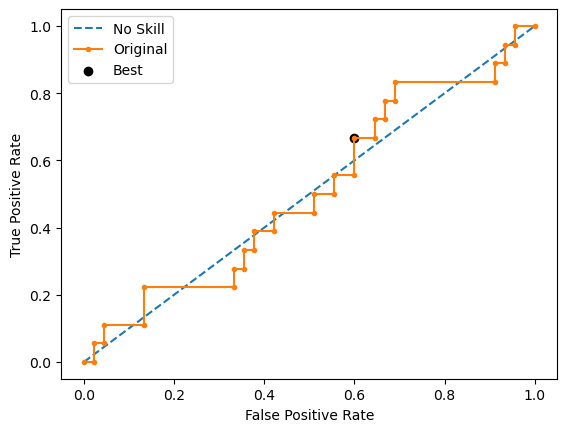

[LibSVM].
*
optimization finished, #iter = 103
obj = -0.000080, rho = -0.999478
nSV = 81, nBSV = 76
Total nSV = 81
.
*
optimization finished, #iter = 131
obj = -0.000074, rho = -0.993606
nSV = 76, nBSV = 72
Total nSV = 76
.
*..*
optimization finished, #iter = 321
obj = -0.000076, rho = -0.973882
nSV = 77, nBSV = 75
Total nSV = 77
.
*.....*
optimization finished, #iter = 486
obj = -0.000074, rho = -0.999364
nSV = 76, nBSV = 72
Total nSV = 76
..
*
optimization finished, #iter = 176
obj = -0.000070, rho = -0.999717
nSV = 74, nBSV = 67
Total nSV = 74
.
*
optimization finished, #iter = 117
obj = -0.000094, rho = 0.993869
nSV = 95, nBSV = 92
Total nSV = 95
Run 2 - Random State: 1
Test G-mean: 0.28974232912011766
Best Threshold=0.524009, G-Mean=0.521


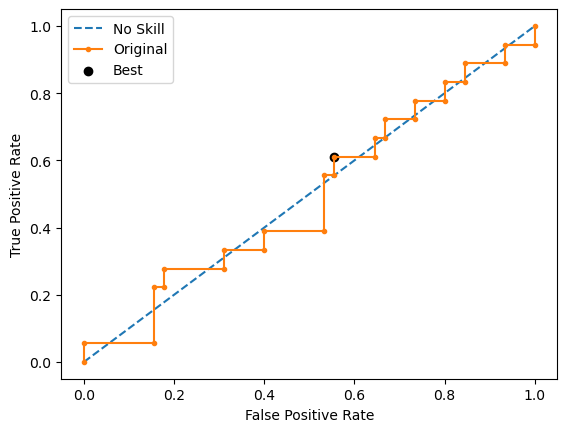

[LibSVM]*
optimization finished, #iter = 45
obj = -0.000080, rho = -0.994275
nSV = 81, nBSV = 78
Total nSV = 81
*
optimization finished, #iter = 46
obj = -0.000076, rho = -0.999711
nSV = 78, nBSV = 75
Total nSV = 78
*
optimization finished, #iter = 51
obj = -0.000076, rho = -0.999888
nSV = 79, nBSV = 75
Total nSV = 79
*
optimization finished, #iter = 49
obj = -0.000074, rho = -0.999850
nSV = 79, nBSV = 72
Total nSV = 79
*
optimization finished, #iter = 63
obj = -0.000070, rho = -1.000023
nSV = 73, nBSV = 66
Total nSV = 73
*
optimization finished, #iter = 65
obj = -0.000094, rho = 0.999631
nSV = 97, nBSV = 92
Total nSV = 97
Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.505877, G-Mean=0.516


invalid value encountered in scalar divide


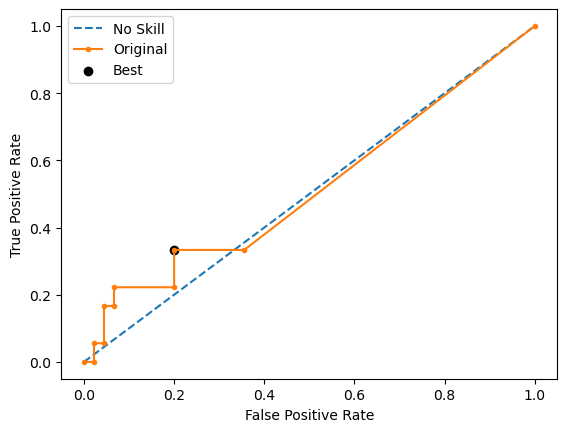

[LibSVM]....*
optimization finished, #iter = 368
obj = -0.000073, rho = 0.824588
nSV = 75, nBSV = 71
Total nSV = 75
......
*.
*
optimization finished, #iter = 589
obj = -0.000068, rho = -1.000335
nSV = 74, nBSV = 64
Total nSV = 74
............WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000067, rho = -1.146569
nSV = 73, nBSV = 64
Total nSV = 73
......
*
optimization finished, #iter = 527
obj = -0.000076, rho = 0.920583
nSV = 78, nBSV = 75
Total nSV = 78
........*.*...WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000072, rho = -0.715622
nSV = 74, nBSV = 69
Total nSV = 74
.........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000089, rho = 0.967636
nSV = 92, nBSV = 86
Total nSV = 92
Run 4 - Random State: 3
Test G-mean: 0.0
Best Threshold=0.506385, G-Mean=0.233


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
invalid value encountered in scalar divide


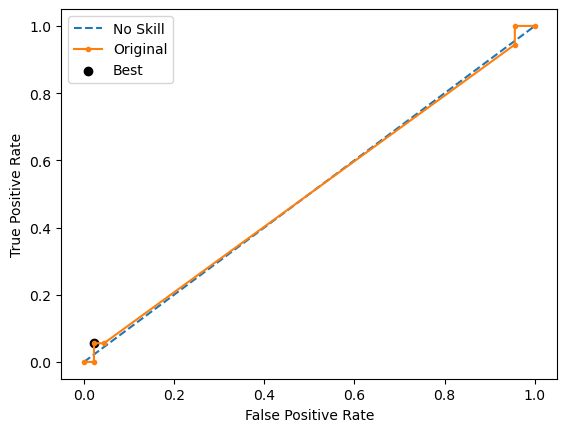

[LibSVM]...........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000078, rho = 0.229644
nSV = 87, nBSV = 75
Total nSV = 87
.....
*..*.*
optimization finished, #iter = 778
obj = -0.000083, rho = 0.999079
nSV = 84, nBSV = 80
Total nSV = 84
...........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000080, rho = 1.673278
nSV = 87, nBSV = 78
Total nSV = 87
...........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000083, rho = -0.184931
nSV = 88, nBSV = 80
Total nSV = 88
......
*.....WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000079, rho = -0.569638
nSV = 84, nBSV = 77
Total nSV = 84
........WARN: libsvm Solver reached max_iter
optimization finished, #iter = 1000
obj = -0.000104, rho = -2.466488
nSV = 109, nBSV = 101
Total nSV = 109
Run 5 - Random State: 4
Test G-mean: 0.0
Best Threshold=0.523688, G-Mean=0.483


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


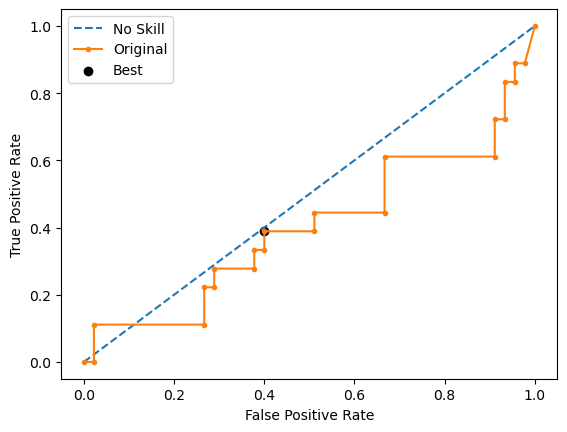

Ave Test G-mean: 0.09892421896754748
Stdev Test G-mean: 0.13874069377279824
Ave Test Specificity: 0.22666666666666666
Ave Test Recall: 0.7777777777777778
Ave Test NPV: 0.7269841269841271
Ave Test Accuracy: 0.3841269841269841
Ave Test Precision: 0.22957307060755333
Ave Test F1-Score: 0.3544309491677912
Ave Runtime: 0.010559415817260743


In [19]:
ho_t02_svm_gs, ho_t02_svm_be, ho_t02_svm_model_info, ho_t02_svm_metrics_df = svm_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

In [20]:
ho_t02_knn_gs, ho_t02_knn_be, ho_t02_knn_model_info, ho_t02_knn_metrics_df = knn_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
[CV 4/10] END classifier__C=10000.0, classifier__kernel=linear, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=0.673, test=0.800) total time=   0.0s
[LibSVM][CV 5/10] END classifier__C=10000.0, classifier__kernel=linear, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=0.646, test=1.000) total time=   0.0s
[LibSVM][CV 6/10] END classifier__C=10000.0, classifier__kernel=linear, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=0.771, test=0.500) total time=   0.0s
[LibSVM][CV 7/10] END classifier__C=10000.0, classifier__kernel=linear, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=0.708, test=0.833) total time=   0.0s
[LibSVM][CV 8/10] END classifier__C=10000.0, classifier__kernel=linear, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=0.688, test=0.833) total time=   0.0

[LibSVM][CV 8/10] END classifier__C=10000.0, classifier__kernel=rbf, classifier__probability=True, resampling=EditedNearestNeighbours();, score=(train=0.646, test=0.000) total time=   0.0s
[LibSVM][CV 7/10] END classifier__C=10000.0, classifier__kernel=rbf, classifier__probability=False, resampling=EditedNearestNeighbours();, score=(train=0.625, test=0.667) total time=   0.0s
[LibSVM][CV 8/10] END classifier__C=10000.0, classifier__kernel=rbf, classifier__probability=False, resampling=EditedNearestNeighbours();, score=(train=0.646, test=0.000) total time=   0.0s
[LibSVM][CV 9/10] END classifier__C=10000.0, classifier__kernel=rbf, classifier__probability=False, resampling=EditedNearestNeighbours();, score=(train=0.755, test=0.600) total time=   0.0s
[LibSVM][CV 10/10] END classifier__C=10000.0, classifier__kernel=rbf, classifier__probability=False, resampling=EditedNearestNeighbours();, score=(train=0.918, test=0.400) total time=   0.0s
[LibSVM][CV 1/10] END classifier__C=10000.0, class

[LibSVM][CV 9/10] END classifier__C=100000.0, classifier__kernel=linear, classifier__probability=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.714, test=0.800) total time=   0.0s
[LibSVM][CV 10/10] END classifier__C=100000.0, classifier__kernel=linear, classifier__probability=False, resampling=RandomUnderSampler(random_state=0);, score=(train=0.714, test=0.600) total time=   0.0s
[LibSVM][CV 5/10] END classifier__C=100000.0, classifier__kernel=poly, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=0.958, test=1.000) total time=   0.0s
[LibSVM][CV 6/10] END classifier__C=100000.0, classifier__kernel=poly, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=0.958, test=0.833) total time=   0.0s
[LibSVM][CV 7/10] END classifier__C=100000.0, classifier__kernel=poly, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=0.000, test=0.000) total time=   0.0s
[LibSVM][CV 8/10] END clas

[LibSVM][CV 8/10] END classifier__C=1000000.0, classifier__kernel=poly, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[LibSVM][CV 9/10] END classifier__C=1000000.0, classifier__kernel=poly, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=0.980, test=1.000) total time=   0.0s
[LibSVM][CV 10/10] END classifier__C=1000000.0, classifier__kernel=poly, classifier__probability=False, resampling=SMOTE(random_state=0);, score=(train=0.082, test=0.200) total time=   0.0s
[LibSVM][CV 1/10] END classifier__C=1000000.0, classifier__kernel=poly, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=0.000, test=0.000) total time=   0.0s
[LibSVM][CV 2/10] END classifier__C=1000000.0, classifier__kernel=poly, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=0.939, test=1.000) total time=   0.0s
[LibSVM][CV 3/10] END classifier__C=1000000.0, class

[LibSVM][CV 8/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.750, test=1.000) total time=   0.0s
[LibSVM][CV 9/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.776, test=0.400) total time=   0.0s
[LibSVM][CV 10/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.653, test=0.400) total time=   0.0s
[LibSVM][CV 1/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.980, test=0.600) total time=   0.0s
[LibSVM][CV 2/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=True, resampling=RandomUnderSampler(random_state=0);, score=(train=0.796, test=0.400) total time=   0.0s
[L

[LibSVM][CV 8/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=True, resampling=EditedNearestNeighbours();, score=(train=0.854, test=0.667) total time=   0.0s
[LibSVM][CV 9/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=0.735, test=0.600) total time=   0.0s
[LibSVM][CV 10/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=False, resampling=ADASYN(random_state=0);, score=(train=0.592, test=0.400) total time=   0.0s
[LibSVM][CV 1/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=False, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[LibSVM][CV 2/10] END classifier__C=1000000.0, classifier__kernel=rbf, classifier__probability=False, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[LibSVM][CV 3/10] END classifier__C=1000000.0,

[CV 5/10] END classifier__C=1000000.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.625, test=0.333) total time=   0.0s
[LibSVM][CV 6/10] END classifier__C=1000000.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.625, test=1.000) total time=   0.0s
[LibSVM][CV 7/10] END classifier__C=1000000.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.604, test=0.500) total time=   0.0s
[LibSVM][CV 8/10] END classifier__C=1000000.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.708, test=0.667) total time=   0.0s
[LibSVM][CV 9/10] END classifier__C=1000000.0, classifier__kernel=sigmoid, classifier__probability=True, resampling=RandomOverSampler(random_state=0);, score=(train=0.571, test=0.600) total time= 

[CV 4/10] END classifier__metric=euclidean, classifier__n_neighbors=2, resampling=RandomOverSampler(random_state=0);, score=(train=0.898, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=euclidean, classifier__n_neighbors=3, resampling=ADASYN(random_state=0);, score=(train=0.980, test=0.600) total time=   0.0s
[CV 4/10] END classifier__metric=euclidean, classifier__n_neighbors=3, resampling=ADASYN(random_state=0);, score=(train=0.857, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=euclidean, classifier__n_neighbors=3, resampling=ADASYN(random_state=0);, score=(train=0.958, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=euclidean, classifier__n_neighbors=3, resampling=ADASYN(random_state=0);, score=(train=0.917, test=0.333) total time=   0.0s
[CV 5/10] END classifier__metric=euclidean, classifier__n_neighbors=5, resampling=SMOTE(random_state=0);, score=(train=0.812, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=euclidean

[CV 6/10] END classifier__metric=euclidean, classifier__n_neighbors=4, resampling=SMOTE(random_state=0);, score=(train=0.771, test=0.167) total time=   0.0s
[CV 9/10] END classifier__metric=euclidean, classifier__n_neighbors=5, resampling=EditedNearestNeighbours();, score=(train=0.673, test=0.600) total time=   0.0s
[CV 10/10] END classifier__metric=euclidean, classifier__n_neighbors=5, resampling=EditedNearestNeighbours();, score=(train=0.694, test=0.400) total time=   0.0s
[CV 1/10] END classifier__metric=euclidean, classifier__n_neighbors=5, resampling=RandomOverSampler(random_state=0);, score=(train=0.735, test=0.400) total time=   0.0s
[CV 2/10] END classifier__metric=euclidean, classifier__n_neighbors=5, resampling=RandomOverSampler(random_state=0);, score=(train=0.673, test=0.200) total time=   0.0s
[CV 3/10] END classifier__metric=euclidean, classifier__n_neighbors=5, resampling=RandomOverSampler(random_state=0);, score=(train=0.796, test=0.400) total time=   0.0s
[CV 4/10] END

[CV 5/10] END classifier__metric=euclidean, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.542, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=euclidean, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.562, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=euclidean, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.521, test=0.500) total time=   0.0s
[CV 8/10] END classifier__metric=euclidean, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.500, test=0.000) total time=   0.0s
[CV 5/10] END classifier__metric=euclidean, classifier__n_neighbors=14, resampling=RandomOverSampler(random_state=0);, score=(train=0.562, test=0.333) total time=   0.0s
[CV 6/10] END classifier__metric=euclidean, classifier__n_neighbors=14, resampling=RandomOverSampler(random_state=0);, score=(train=0.542, test=0.167)

[CV 2/10] END classifier__metric=cosine, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.796, test=0.000) total time=   0.0s
[CV 7/10] END classifier__metric=cosine, classifier__n_neighbors=5, resampling=SMOTE(random_state=0);, score=(train=0.646, test=0.667) total time=   0.0s
[CV 8/10] END classifier__metric=cosine, classifier__n_neighbors=5, resampling=SMOTE(random_state=0);, score=(train=0.750, test=0.333) total time=   0.0s
[CV 9/10] END classifier__metric=cosine, classifier__n_neighbors=5, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.600) total time=   0.0s
[CV 10/10] END classifier__metric=cosine, classifier__n_neighbors=5, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.000) total time=   0.0s
[CV 1/10] END classifier__metric=cosine, classifier__n_neighbors=5, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=cosine, classifier__n_neighbors=5, resam

[CV 1/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomOverSampler(random_state=0);, score=(train=0.673, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomOverSampler(random_state=0);, score=(train=0.735, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomOverSampler(random_state=0);, score=(train=0.653, test=0.400) total time=   0.0s
[CV 4/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomOverSampler(random_state=0);, score=(train=0.714, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomOverSampler(random_state=0);, score=(train=0.667, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomOverSampler(random_state=0);, score=(train=0.688, test=0.333) total time=   0.0s
[CV 

[CV 3/10] END classifier__metric=cosine, classifier__n_neighbors=7, resampling=RandomOverSampler(random_state=0);, score=(train=0.673, test=0.600) total time=   0.0s
[CV 4/10] END classifier__metric=cosine, classifier__n_neighbors=7, resampling=RandomOverSampler(random_state=0);, score=(train=0.735, test=0.600) total time=   0.0s
[CV 7/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomUnderSampler(random_state=0);, score=(train=0.521, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomUnderSampler(random_state=0);, score=(train=0.542, test=0.667) total time=   0.0s
[CV 9/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomUnderSampler(random_state=0);, score=(train=0.551, test=0.400) total time=   0.0s
[CV 10/10] END classifier__metric=cosine, classifier__n_neighbors=9, resampling=RandomUnderSampler(random_state=0);, score=(train=0.449, test=0.400) total time=   0.0s

[CV 8/10] END classifier__metric=cosine, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.417, test=0.333) total time=   0.0s
[CV 9/10] END classifier__metric=cosine, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.490, test=0.400) total time=   0.0s
[CV 10/10] END classifier__metric=cosine, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.490, test=0.200) total time=   0.0s
[CV 1/10] END classifier__metric=cosine, classifier__n_neighbors=10, resampling=RandomUnderSampler(random_state=0);, score=(train=0.286, test=0.200) total time=   0.0s
[CV 2/10] END classifier__metric=cosine, classifier__n_neighbors=10, resampling=RandomUnderSampler(random_state=0);, score=(train=0.490, test=0.000) total time=   0.0s
[CV 3/10] END classifier__metric=cosine, classifier__n_neighbors=10, resampling=RandomUnderSampler(random_state=0);, score=(train=0.469, test=0.400) total time=  

[CV 10/10] END classifier__metric=cosine, classifier__n_neighbors=15, resampling=RandomUnderSampler(random_state=0);, score=(train=0.429, test=0.200) total time=   0.0s
[CV 7/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.417, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.500, test=0.500) total time=   0.0s
[CV 9/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.408, test=0.000) total time=   0.0s
[CV 10/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.429, test=0.400) total time=   0.0s
[CV 1/10] END classifier__metric=hamming, classifier__n_neighbors=3, resampling=SMOTE(random_state=0);, score=(train=0.755, test=0.200) total time=   0.0s
[CV

[CV 6/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=EditedNearestNeighbours();, score=(train=0.479, test=0.500) total time=   0.0s
[CV 7/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=EditedNearestNeighbours();, score=(train=0.479, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=EditedNearestNeighbours();, score=(train=0.500, test=0.333) total time=   0.0s
[CV 9/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=EditedNearestNeighbours();, score=(train=0.673, test=0.000) total time=   0.0s
[CV 10/10] END classifier__metric=hamming, classifier__n_neighbors=2, resampling=EditedNearestNeighbours();, score=(train=0.633, test=0.400) total time=   0.0s
[CV 1/10] END classifier__metric=hamming, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.776, test=0.200) total time=   0.0s
[CV 2/10] END classifier__metric=ham

[CV 1/10] END classifier__metric=hamming, classifier__n_neighbors=8, resampling=EditedNearestNeighbours();, score=(train=0.571, test=0.400) total time=   0.0s
[CV 2/10] END classifier__metric=hamming, classifier__n_neighbors=8, resampling=EditedNearestNeighbours();, score=(train=0.531, test=0.600) total time=   0.0s
[CV 3/10] END classifier__metric=hamming, classifier__n_neighbors=8, resampling=EditedNearestNeighbours();, score=(train=0.816, test=0.800) total time=   0.0s
[CV 4/10] END classifier__metric=hamming, classifier__n_neighbors=8, resampling=EditedNearestNeighbours();, score=(train=0.551, test=0.600) total time=   0.0s
[CV 5/10] END classifier__metric=hamming, classifier__n_neighbors=8, resampling=EditedNearestNeighbours();, score=(train=0.604, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=hamming, classifier__n_neighbors=8, resampling=EditedNearestNeighbours();, score=(train=0.521, test=0.333) total time=   0.0s
[CV 7/10] END classifier__metric=hamming, clas

[CV 1/10] END classifier__metric=hamming, classifier__n_neighbors=7, resampling=SMOTE(random_state=0);, score=(train=0.449, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=hamming, classifier__n_neighbors=7, resampling=SMOTE(random_state=0);, score=(train=0.367, test=0.000) total time=   0.0s
[CV 3/10] END classifier__metric=hamming, classifier__n_neighbors=7, resampling=SMOTE(random_state=0);, score=(train=0.408, test=0.400) total time=   0.0s
[CV 4/10] END classifier__metric=hamming, classifier__n_neighbors=7, resampling=SMOTE(random_state=0);, score=(train=0.449, test=0.600) total time=   0.0s
[CV 9/10] END classifier__metric=hamming, classifier__n_neighbors=9, resampling=RandomUnderSampler(random_state=0);, score=(train=0.612, test=0.400) total time=   0.0s
[CV 10/10] END classifier__metric=hamming, classifier__n_neighbors=9, resampling=RandomUnderSampler(random_state=0);, score=(train=0.714, test=0.800) total time=   0.0s
[CV 1/10] END classifier__metric=hamming, c

[CV 1/10] END classifier__metric=hamming, classifier__n_neighbors=14, resampling=ADASYN(random_state=0);, score=(train=0.143, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=hamming, classifier__n_neighbors=14, resampling=ADASYN(random_state=0);, score=(train=0.082, test=0.000) total time=   0.0s
[CV 3/10] END classifier__metric=hamming, classifier__n_neighbors=14, resampling=ADASYN(random_state=0);, score=(train=0.082, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=hamming, classifier__n_neighbors=14, resampling=ADASYN(random_state=0);, score=(train=0.143, test=0.000) total time=   0.0s
[CV 5/10] END classifier__metric=hamming, classifier__n_neighbors=14, resampling=ADASYN(random_state=0);, score=(train=0.167, test=0.000) total time=   0.0s
[CV 6/10] END classifier__metric=hamming, classifier__n_neighbors=14, resampling=ADASYN(random_state=0);, score=(train=0.104, test=0.000) total time=   0.0s
[CV 7/10] END classifier__metric=hamming, classifier__n_ne

[CV 3/10] END classifier__metric=braycurtis, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.878, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=braycurtis, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.837, test=0.000) total time=   0.0s
[CV 5/10] END classifier__metric=braycurtis, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.917, test=0.167) total time=   0.0s
[CV 6/10] END classifier__metric=braycurtis, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.854, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=braycurtis, classifier__n_neighbors=5, resampling=EditedNearestNeighbours();, score=(train=0.708, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=braycurtis, classifier__n_neighbors=5, resampling=EditedNearestNeighbours();, score=(train=0.667, test=0.333) total time=   0.0s
[CV 9/10] END classifier__metric=braycur

[CV 3/10] END classifier__metric=braycurtis, classifier__n_neighbors=6, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.200) total time=   0.0s
[CV 4/10] END classifier__metric=braycurtis, classifier__n_neighbors=6, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.600) total time=   0.0s
[CV 5/10] END classifier__metric=braycurtis, classifier__n_neighbors=6, resampling=ADASYN(random_state=0);, score=(train=0.750, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=braycurtis, classifier__n_neighbors=6, resampling=ADASYN(random_state=0);, score=(train=0.729, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=braycurtis, classifier__n_neighbors=6, resampling=ADASYN(random_state=0);, score=(train=0.771, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=braycurtis, classifier__n_neighbors=6, resampling=ADASYN(random_state=0);, score=(train=0.688, test=0.333) total time=   0.0s
[CV 9/10] END classifier__metric=braycurtis, c

[CV 8/10] END classifier__metric=braycurtis, classifier__n_neighbors=7, resampling=RandomOverSampler(random_state=0);, score=(train=0.729, test=0.167) total time=   0.0s
[CV 3/10] END classifier__metric=braycurtis, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.531, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=braycurtis, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.510, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=braycurtis, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.604, test=0.333) total time=   0.0s
[CV 6/10] END classifier__metric=braycurtis, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.604, test=0.333) total time=   0.0s
[CV 7/10] END classifier__metric=braycurtis, classifier__n_neighbors=10, resampling=RandomOverSampler(random_state=0);, score=(train=0.604, test=0

[CV 6/10] END classifier__metric=braycurtis, classifier__n_neighbors=11, resampling=RandomOverSampler(random_state=0);, score=(train=0.646, test=0.333) total time=   0.0s
[CV 7/10] END classifier__metric=braycurtis, classifier__n_neighbors=11, resampling=RandomOverSampler(random_state=0);, score=(train=0.688, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=braycurtis, classifier__n_neighbors=11, resampling=RandomOverSampler(random_state=0);, score=(train=0.604, test=0.167) total time=   0.0s
[CV 9/10] END classifier__metric=braycurtis, classifier__n_neighbors=11, resampling=RandomOverSampler(random_state=0);, score=(train=0.714, test=0.600) total time=   0.0s
[CV 10/10] END classifier__metric=braycurtis, classifier__n_neighbors=11, resampling=RandomOverSampler(random_state=0);, score=(train=0.612, test=0.400) total time=   0.0s
[CV 1/10] END classifier__metric=braycurtis, classifier__n_neighbors=11, resampling=RandomUnderSampler(random_state=0);, score=(train=0.592, tes

[CV 1/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=SMOTE(random_state=0);, score=(train=0.714, test=0.000) total time=   0.0s
[CV 3/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=SMOTE(random_state=0);, score=(train=0.612, test=0.200) total time=   0.0s
[CV 4/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=SMOTE(random_state=0);, score=(train=0.673, test=0.200) total time=   0.0s
[CV 5/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=SMOTE(random_state=0);, score=(train=0.729, test=0.167) total time=   0.0s
[CV 6/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=SMOTE(random_state=0);, score=(train=0.771, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=chebyshev, classifier__n_

[CV 3/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=EditedNearestNeighbours();, score=(train=0.531, test=0.600) total time=   0.0s
[CV 4/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=EditedNearestNeighbours();, score=(train=0.510, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=EditedNearestNeighbours();, score=(train=0.479, test=0.167) total time=   0.1s
[CV 6/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=EditedNearestNeighbours();, score=(train=0.458, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=EditedNearestNeighbours();, score=(train=0.521, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=chebyshev, classifier__n_neighbors=4, resampling=EditedNearestNeighbours();, score=(train=0.458, test=0.000) total time=   0.0s
[CV 9/10] END classifier__metric=c

[CV 3/10] END classifier__metric=chebyshev, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.510, test=0.200) total time=   0.0s
[CV 4/10] END classifier__metric=chebyshev, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.490, test=0.600) total time=   0.0s
[CV 7/10] END classifier__metric=chebyshev, classifier__n_neighbors=8, resampling=SMOTE(random_state=0);, score=(train=0.688, test=0.500) total time=   0.0s
[CV 8/10] END classifier__metric=chebyshev, classifier__n_neighbors=8, resampling=SMOTE(random_state=0);, score=(train=0.771, test=0.167) total time=   0.0s
[CV 9/10] END classifier__metric=chebyshev, classifier__n_neighbors=8, resampling=SMOTE(random_state=0);, score=(train=0.531, test=0.600) total time=   0.0s
[CV 10/10] END classifier__metric=chebyshev, classifier__n_neighbors=8, resampling=SMOTE(random_state=0);, score=(train=0.571, test=0.800) total time=   0.0s
[CV 1/10] END classifier__metri

[CV 10/10] END classifier__metric=chebyshev, classifier__n_neighbors=10, resampling=SMOTE(random_state=0);, score=(train=0.551, test=0.800) total time=   0.0s
[CV 1/10] END classifier__metric=chebyshev, classifier__n_neighbors=10, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=chebyshev, classifier__n_neighbors=10, resampling=ADASYN(random_state=0);, score=(train=0.673, test=0.600) total time=   0.0s
[CV 3/10] END classifier__metric=chebyshev, classifier__n_neighbors=10, resampling=ADASYN(random_state=0);, score=(train=0.510, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=chebyshev, classifier__n_neighbors=10, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=chebyshev, classifier__n_neighbors=10, resampling=ADASYN(random_state=0);, score=(train=0.667, test=0.333) total time=   0.0s
[CV 6/10] END classifier__metric=chebyshev, cl

[CV 4/10] END classifier__metric=chebyshev, classifier__n_neighbors=14, resampling=RandomUnderSampler(random_state=0);, score=(train=0.306, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=chebyshev, classifier__n_neighbors=14, resampling=RandomUnderSampler(random_state=0);, score=(train=0.292, test=0.333) total time=   0.0s
[CV 6/10] END classifier__metric=chebyshev, classifier__n_neighbors=14, resampling=RandomUnderSampler(random_state=0);, score=(train=0.333, test=0.000) total time=   0.0s
[CV 7/10] END classifier__metric=chebyshev, classifier__n_neighbors=14, resampling=RandomUnderSampler(random_state=0);, score=(train=0.312, test=0.167) total time=   0.0s
[CV 8/10] END classifier__metric=chebyshev, classifier__n_neighbors=14, resampling=RandomUnderSampler(random_state=0);, score=(train=0.375, test=0.000) total time=   0.0s
[CV 9/10] END classifier__metric=chebyshev, classifier__n_neighbors=14, resampling=RandomUnderSampler(random_state=0);, score=(train=0.388, test=

[CV 9/10] END classifier__metric=canberra, classifier__n_neighbors=5, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.200) total time=   0.0s
[CV 10/10] END classifier__metric=canberra, classifier__n_neighbors=5, resampling=RandomOverSampler(random_state=0);, score=(train=0.735, test=0.400) total time=   0.0s
[CV 1/10] END classifier__metric=canberra, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.200) total time=   0.0s
[CV 2/10] END classifier__metric=canberra, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.755, test=0.200) total time=   0.0s
[CV 3/10] END classifier__metric=canberra, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.796, test=0.400) total time=   0.0s
[CV 4/10] END classifier__metric=canberra, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.653, test=1.000) total 


[CV 2/10] END classifier__metric=canberra, classifier__n_neighbors=9, resampling=SMOTE(random_state=0);, score=(train=0.592, test=0.000) total time=   0.0s
[CV 3/10] END classifier__metric=canberra, classifier__n_neighbors=9, resampling=SMOTE(random_state=0);, score=(train=0.551, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=canberra, classifier__n_neighbors=9, resampling=SMOTE(random_state=0);, score=(train=0.531, test=0.000) total time=   0.0s
[CV 5/10] END classifier__metric=canberra, classifier__n_neighbors=9, resampling=SMOTE(random_state=0);, score=(train=0.458, test=0.000) total time=   0.0s
[CV 6/10] END classifier__metric=canberra, classifier__n_neighbors=9, resampling=SMOTE(random_state=0);, score=(train=0.438, test=0.167) total time=   0.0s
[CV 5/10] END classifier__metric=canberra, classifier__n_neighbors=11, resampling=RandomOverSampler(random_state=0);, score=(train=0.625, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=canberra, classif

[CV 8/10] END classifier__metric=canberra, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.667, test=0.333) total time=   0.0s
[CV 9/10] END classifier__metric=canberra, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.673, test=0.000) total time=   0.0s
[CV 10/10] END classifier__metric=canberra, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.571, test=0.200) total time=   0.0s
[CV 1/10] END classifier__metric=canberra, classifier__n_neighbors=12, resampling=RandomUnderSampler(random_state=0);, score=(train=0.449, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=canberra, classifier__n_neighbors=12, resampling=RandomUnderSampler(random_state=0);, score=(train=0.490, test=0.200) total time=   0.0s
[CV 3/10] END classifier__metric=canberra, classifier__n_neighbors=12, resampling=RandomUnderSampler(random_state=0);, score=(train=0.510, test=0.400) t

Best Hyperparameters: {'classifier__metric': 'euclidean', 'classifier__n_neighbors': 15, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.6666666666666665
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='euclidean', n_neighbors=15))])
Mean Train Score (G-mean) 0.6375297619047618
Std Train Score (G-mean) 0.06019073703729505
GridSearchCV Runtime: 10.013526201248169 secs
Run 1 - Random State: 0
Test G-mean: 0.4303314829119352
Run 2 - Random State: 1
Test G-mean: 0.37184890068181137
Run 3 - Random State: 2
Test G-mean: 0.5305482838361476
Run 4 - Random State: 3
Test G-mean: 0.4661372658534007
Run 5 - Random State: 4
Test G-mean: 0.4201704533597564
Ave Test G-mean: 0.44380727732861025
Stdev Test G-mean: 0.05903586843944018
Ave Test Specificity: 0.28
Ave Test Recall: 0.7444444444444445
Ave Test NPV: 0.7380321441843181
Ave Test 

Fitting 10 folds for each of 80 candidates, totalling 800 fits
[CV 10/10] END classifier__metric=cityblock, classifier__n_neighbors=7, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.600) total time=   0.0s
[CV 1/10] END classifier__metric=cityblock, classifier__n_neighbors=7, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.400) total time=   0.0s
[CV 2/10] END classifier__metric=cityblock, classifier__n_neighbors=7, resampling=ADASYN(random_state=0);, score=(train=0.714, test=0.200) total time=   0.0s
[CV 7/10] END classifier__metric=cityblock, classifier__n_neighbors=10, resampling=SMOTE(random_state=0);, score=(train=0.583, test=0.500) total time=   0.0s
[CV 8/10] END classifier__metric=cityblock, classifier__n_neighbors=10, resampling=SMOTE(random_state=0);, score=(train=0.625, test=0.500) total time=   0.0s
[CV 9/10] END classifier__metric=cityblock, classifier__n_neighbors=10, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.400) total ti

[CV 10/10] END classifier__metric=cityblock, classifier__n_neighbors=5, resampling=RandomOverSampler(random_state=0);, score=(train=0.714, test=0.600) total time=   0.0s
[CV 1/10] END classifier__metric=cityblock, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.551, test=0.200) total time=   0.0s
[CV 2/10] END classifier__metric=cityblock, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.633, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=cityblock, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.592, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=cityblock, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.633, test=0.600) total time=   0.0s
[CV 5/10] END classifier__metric=cityblock, classifier__n_neighbors=5, resampling=RandomUnderSampler(random_state=0);, score=(train=0.625, test=0.833)

[CV 6/10] END classifier__metric=cityblock, classifier__n_neighbors=8, resampling=RandomOverSampler(random_state=0);, score=(train=0.583, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=cityblock, classifier__n_neighbors=8, resampling=RandomOverSampler(random_state=0);, score=(train=0.604, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=cityblock, classifier__n_neighbors=8, resampling=RandomOverSampler(random_state=0);, score=(train=0.500, test=0.167) total time=   0.0s
[CV 9/10] END classifier__metric=cityblock, classifier__n_neighbors=8, resampling=RandomOverSampler(random_state=0);, score=(train=0.510, test=0.200) total time=   0.0s
[CV 10/10] END classifier__metric=cityblock, classifier__n_neighbors=8, resampling=RandomOverSampler(random_state=0);, score=(train=0.531, test=0.600) total time=   0.0s
[CV 1/10] END classifier__metric=cityblock, classifier__n_neighbors=8, resampling=RandomUnderSampler(random_state=0);, score=(train=0.388, test=0.000) tot

[CV 1/10] END classifier__metric=cityblock, classifier__n_neighbors=9, resampling=EditedNearestNeighbours();, score=(train=0.551, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=cityblock, classifier__n_neighbors=9, resampling=EditedNearestNeighbours();, score=(train=0.571, test=0.600) total time=   0.0s
[CV 3/10] END classifier__metric=cityblock, classifier__n_neighbors=9, resampling=EditedNearestNeighbours();, score=(train=0.837, test=0.600) total time=   0.0s
[CV 4/10] END classifier__metric=cityblock, classifier__n_neighbors=9, resampling=EditedNearestNeighbours();, score=(train=0.653, test=0.400) total time=   0.0s
[CV 1/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.200) total time=   0.0s
[CV 2/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=SMOTE(random_state=0);, score=(train=0.735, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=cityblo

[CV 2/10] END classifier__metric=cityblock, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.510, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=cityblock, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.571, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=cityblock, classifier__n_neighbors=12, resampling=RandomOverSampler(random_state=0);, score=(train=0.531, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=ADASYN(random_state=0);, score=(train=0.755, test=0.800) total time=   0.0s
[CV 4/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.600) total time=   0.0s
[CV 5/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=ADASYN(random_state=0);, score=(train=0.854, test=0.833) total time=   0.0s
[CV 6/10] END

[CV 2/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=RandomUnderSampler(random_state=0);, score=(train=0.388, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=RandomUnderSampler(random_state=0);, score=(train=0.429, test=0.600) total time=   0.0s
[CV 4/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=RandomUnderSampler(random_state=0);, score=(train=0.510, test=0.200) total time=   0.0s
[CV 5/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=RandomUnderSampler(random_state=0);, score=(train=0.583, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=RandomUnderSampler(random_state=0);, score=(train=0.583, test=0.333) total time=   0.0s
[CV 7/10] END classifier__metric=cityblock, classifier__n_neighbors=13, resampling=RandomUnderSampler(random_state=0);, score=(train=0.479, test=

[CV 5/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=RandomOverSampler(random_state=0);, score=(train=0.688, test=0.833) total time=   0.0s
[CV 6/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=RandomOverSampler(random_state=0);, score=(train=0.646, test=0.333) total time=   0.0s
[CV 7/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=RandomOverSampler(random_state=0);, score=(train=0.750, test=0.500) total time=   0.0s
[CV 8/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=RandomOverSampler(random_state=0);, score=(train=0.562, test=0.000) total time=   0.0s
[CV 9/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=RandomOverSampler(random_state=0);, score=(train=0.653, test=0.600) total time=   0.0s
[CV 10/10] END classifier__metric=cityblock, classifier__n_neighbors=15, resampling=RandomOverSampler(random_state=0);, score=(train=0.653, test=0.600

[CV 7/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.833, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.833, test=0.167) total time=   0.0s
[CV 9/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.796, test=0.200) total time=   0.0s
[CV 10/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.200) total time=   0.0s
[CV 1/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=EditedNearestNeighbours();, score=(train=0.551, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=EditedNearestNeighbours();, score=(train=0.612, test=0.400) total time=   0.0s
[CV 3/10] END classifier__metric=

[CV 1/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.286, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.388, test=0.200) total time=   0.0s
[CV 3/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.327, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.429, test=0.000) total time=   0.0s
[CV 5/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.417, test=0.333) total time=   0.0s
[CV 6/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=2, resampling=RandomUnderSampler(random_state=0);, score=(train=0.438,

[CV 6/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.854, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.875, test=0.333) total time=   0.0s
[CV 8/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=3, resampling=RandomOverSampler(random_state=0);, score=(train=0.875, test=0.333) total time=   0.0s
[CV 3/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=6, resampling=RandomOverSampler(random_state=0);, score=(train=0.490, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=6, resampling=RandomOverSampler(random_state=0);, score=(train=0.531, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=6, resampling=RandomOverSampler(random_state=0);, score=(train=0.562, test=

[CV 8/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=10, resampling=SMOTE(random_state=0);, score=(train=0.708, test=0.667) total time=   0.0s
[CV 3/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=13, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.200) total time=   0.0s
[CV 4/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=13, resampling=SMOTE(random_state=0);, score=(train=0.816, test=0.400) total time=   0.0s
[CV 5/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=13, resampling=SMOTE(random_state=0);, score=(train=0.771, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=13, resampling=SMOTE(random_state=0);, score=(train=0.812, test=0.333) total time=   0.0s
[CV 7/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=13, resampling=SMOTE(random_state=0);, score=(train=0.750, test=0.833) total time=   0.0s
[CV 8/10] END classifier__metric=sqeucli

Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.72
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.9990763180272108
Std Train Score (G-mean) 0.0016970726518589746
GridSearchCV Runtime: 17.54272699356079 secs
Run 1 - Random State: 0
Test G-mean: 0.557773351022717
Best Threshold=0.641392, G-Mean=0.571


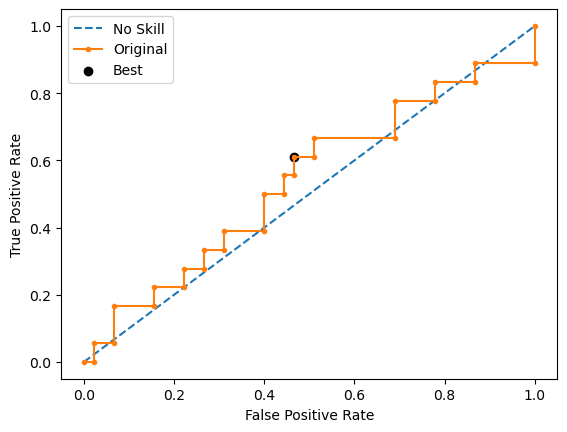

Run 2 - Random State: 1
Test G-mean: 0.4944132324730442
Best Threshold=0.953761, G-Mean=0.558


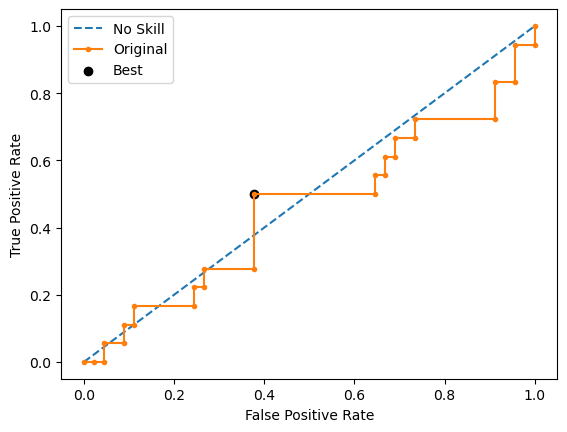

Run 3 - Random State: 2
Test G-mean: 0.5837300238472753
Best Threshold=0.732698, G-Mean=0.606


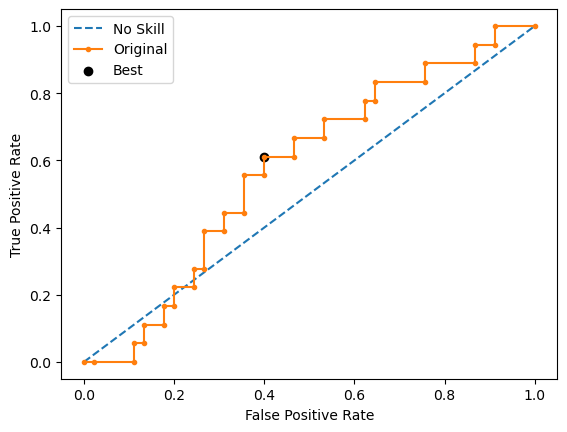

Run 4 - Random State: 3
Test G-mean: 0.5665577237325317
Best Threshold=0.457918, G-Mean=0.621


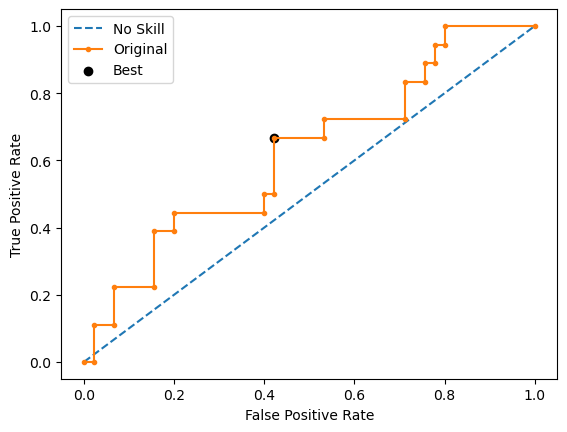

Run 5 - Random State: 4
Test G-mean: 0.447213595499958
Best Threshold=0.589546, G-Mean=0.471


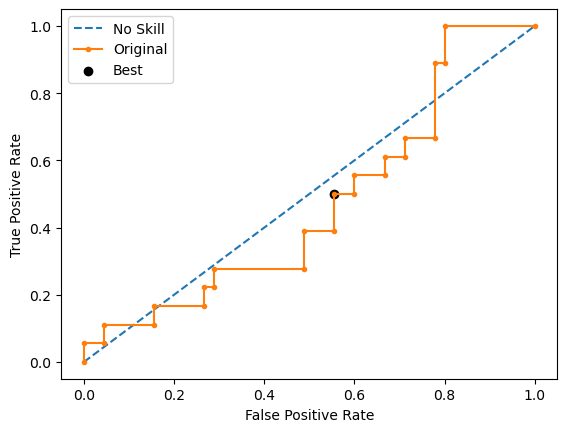

Ave Test G-mean: 0.5299375853151053
Stdev Test G-mean: 0.05725977857375467
Ave Test Specificity: 0.4888888888888888
Ave Test Recall: 0.5777777777777777
Ave Test NPV: 0.7423862388856173
Ave Test Accuracy: 0.5142857142857142
Ave Test Precision: 0.3124704192021636
Ave Test F1-Score: 0.4049696308419713
Ave Runtime: 0.11929941177368164


In [21]:
ho_t02_gbm_gs, ho_t02_gbm_be, ho_t02_gbm_model_info, ho_t02_gbm_metrics_df = gbm_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
[CV 9/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=11, resampling=RandomUnderSampler(random_state=0);, score=(train=0.408, test=0.600) total time=   0.0s
[CV 10/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=11, resampling=RandomUnderSampler(random_state=0);, score=(train=0.735, test=0.600) total time=   0.0s
[CV 1/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=12, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.000) total time=   0.0s
[CV 2/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=12, resampling=SMOTE(random_state=0);, score=(train=0.694, test=0.200) total time=   0.0s
[CV 3/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=12, resampling=SMOTE(random_state=0);, score=(train=0.571, test=0.000) total time=   0.0s
[CV 4/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=12, resampling=SMOTE(random_state=0);,

[CV 6/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=15, resampling=EditedNearestNeighbours();, score=(train=0.375, test=0.167) total time=   0.0s
[CV 7/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=15, resampling=RandomOverSampler(random_state=0);, score=(train=0.562, test=0.500) total time=   0.0s
[CV 6/10] END classifier__metric=sqeuclidean, classifier__n_neighbors=15, resampling=RandomUnderSampler(random_state=0);, score=(train=0.583, test=0.333) total time=   0.0s
[CV 5/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.500) total time=   0.2s
[CV 5/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total t

[CV 2/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.3s
[CV 3/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) total time=   0.2s
[CV 2/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.800) total time=   0.1s
[CV 1/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.400

[CV 10/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.800) total time=   0.1s
[CV 9/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.980, test=0.200) total time=   0.2s
[CV 8/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.979, test=0.167) total time=   0.2s
[CV 10/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.

[CV 6/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.1s
[CV 6/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.500) total time=   0.2s
[CV 6/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.500) total time=   0.2s
[CV 1/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, t

[CV 10/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.1s
[CV 9/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=0.980, test=0.000) total time=   0.2s
[CV 7/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.1s
[CV 7/10] END classifier__learning_rate=0.1, classifier__max_depth=2, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.00

[CV 9/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) total time=   0.4s
[CV 7/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.667) total time=   0.1s
[CV 6/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.3s
[CV 9/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.00

[CV 10/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.400) total time=   0.3s
[CV 10/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.400) total time=   0.3s
[CV 9/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.200) total time=   0.1s
[CV 9/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.2

[CV 8/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.167) total time=   0.2s
[CV 8/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.1s
[CV 8/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.333) total time=   0.4s
[CV 7/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=2, classifier__min_samples_split=3, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, t

[CV 3/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.000) total time=   0.3s
[CV 4/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.400) total time=   0.3s
[CV 5/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=1.000, test=1.000) total time=   0.1s
[CV 4/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=2, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.600

[CV 7/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.3s
[CV 9/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.200) total time=   0.1s
[CV 8/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.167) total time=   0.2s
[CV 6/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.00

[CV 8/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.333) total time=   0.3s
[CV 1/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.2s
[CV 2/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.600) total time=   0.1s
[CV 2/10] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__min_samples_leaf=3, classifier__min_samples_split=3, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, t

[CV 1/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=0.918, test=0.200) total time=   0.1s
[CV 2/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=0.939, test=0.000) total time=   0.2s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.833) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.667) tot

[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=0.980, test=0.400) total time=   0.2s
[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, t

[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.562, test=0.167) total time=   0.1s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.583, test=0.333) total time=   0.0s
[CV 9/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.633, test=0.200) total time=   0.0s
[CV 10/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.400) total time=   0.0s

[CV 2/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.400) total time=   0.1s
[CV 1/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.837, test=0.600) total time=   0.0s
[CV 2/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.939, test=0.800) t

[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=0.857, test=0.800) total time=   0.0s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=0.837, test=0.800) total time=   0.0s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=0.938, test=0.667) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, sco

[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=0.833, test=0.667) total time=   0.1s
[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.816, test=0.400) total time=   0.1s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.837, test=0.200) total time=   0.1s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.771, test=0.500) total time=   0.1s
[

[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.816, test=0.400) total time=   0.1s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.816, test=0.200) total time=   0.1s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=0.792, test=0.167) total time=   0.1s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=0.833, test=0.167) total time=   0.1s
[CV 

[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.400) total time=   0.1s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) total time=   0.1s
[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, t

[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 9/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.959, test=0.200) total time=   0.0s
[CV 10/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 1/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.400) total time

[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(tra

[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=0.958, test=0.500) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.667) t

[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(tr

[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.667) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=

[CV 9/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 10/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[

[CV 2/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.800) total time=   0.0s
[CV 9/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 10/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 1/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0

[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.667) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.500) total t

[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score

[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.0

[CV 9/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 10/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 1/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 2/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 3/10] END

[CV 2/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 9/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 

[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 7/10] EN

[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 3/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 4/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.600) total time=   0.0s
[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.833) total time=   0.0s
[CV 6/10] END cl

[CV 5/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 6/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 7/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=depthwise, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 9/10] END 

[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.918, test=0.200) total time=   0.1s
[CV 2/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.837, test=0.000) total time=   0.1s
[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=0.896, test=0.500) total time=   0.1s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=0.93

[CV 4/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.1s
[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=0.958, test=0.500) total time=   0.1s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=0.917, test=0.500) total time=   0.1s
[CV 3/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(

[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.755, test=0.200) total time=   0.1s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.200) total time=   0.0s
[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.633, test=0.200) total

[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.562, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.583, test=0.333) total time=   0.1s
[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.633, test=0.200) total time=   0.0s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.400) total time=   0.0s

[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.333) total time=   0.0s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=0.750, test=0.333) total time=   0.0s
[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.667, test=0.667) total time=   0.0s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.667, test=0.500)

[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.708, test=0.333) total time=   0.1s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.771, test=0.500) total time=   0.1s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.771, test=0.167) total time=   0.1s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.792, test=0.167) total time=   0.1s
[CV 

[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=0.939, test=0.200) total time=   0.0s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.792, test=0.167) total time=   0.1s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.812, test=0

[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.755, test=0.200) total time=   0.1s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.816, test=0.200) total time=   0.1s
[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.776, test=0.200) total time=   0.1s
[CV 2/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.878, test=0.000) total time=   0.1s
[

[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.771, test=0.500) total time=   0.1s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.833, test=0.333) total time=   0.1s
[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=0.896, test=0.667) total time=   0.0s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=0.938, test=0.66

[CV 4/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.1s
[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.1s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.1s
[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) t

[CV 4/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=20, classifier__n_estimators=250, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=0.959, test=0.200) total time=   0.0s
[CV 10/1

[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.000) total time=   0.1s
[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) total time=   0.1s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.200) total time=   0.1s
[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.400) total time=

[CV 4/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(t

[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.1s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(trai

[CV 4/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[CV 2/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 3/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.0

Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.6466666666666667
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, device=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constraints=None, learning_ra

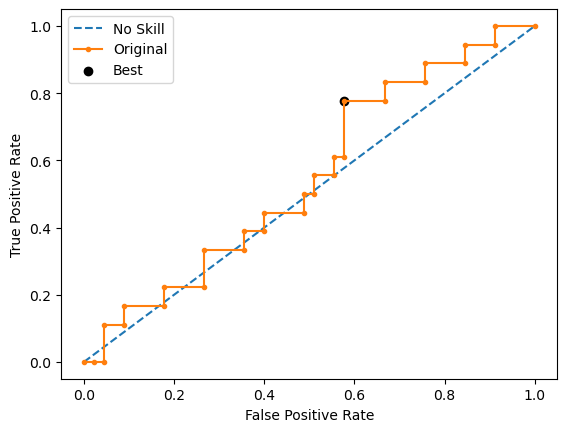

Run 2 - Random State: 1
Test G-mean: 0.5328701692569688
Best Threshold=0.761891, G-Mean=0.587


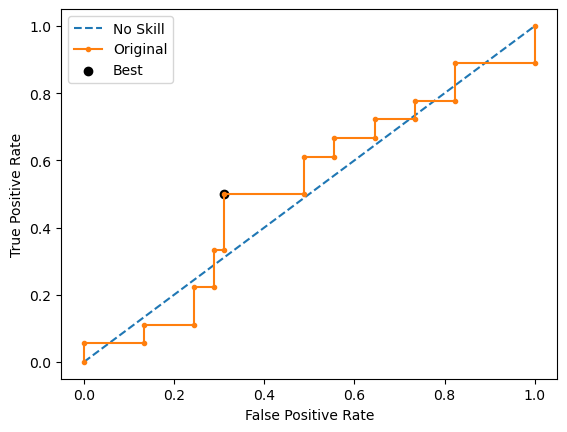

Run 3 - Random State: 2
Test G-mean: 0.6703601390665936
Best Threshold=0.505134, G-Mean=0.670


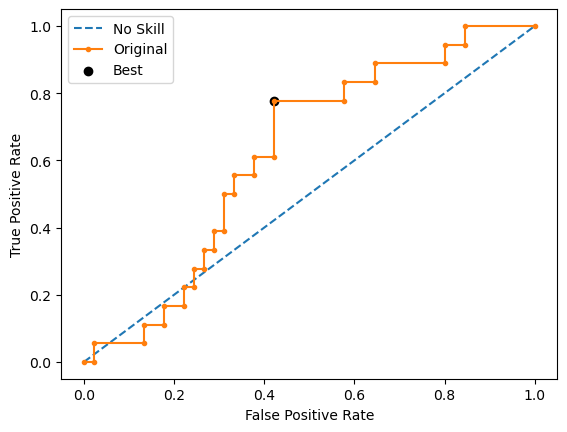

Run 4 - Random State: 3
Test G-mean: 0.5962847939999438
Best Threshold=0.565849, G-Mean=0.644


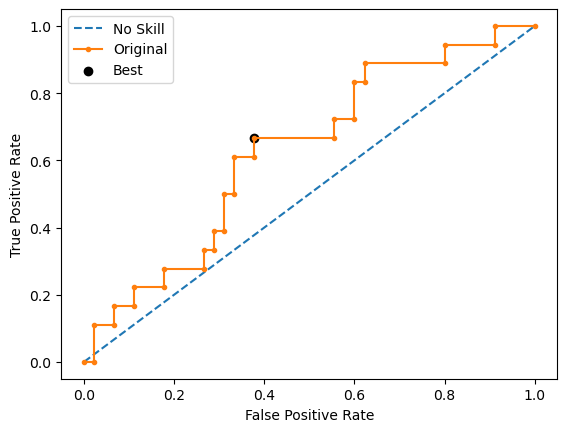

Run 5 - Random State: 4
Test G-mean: 0.5942107536498195
Best Threshold=0.489927, G-Mean=0.609


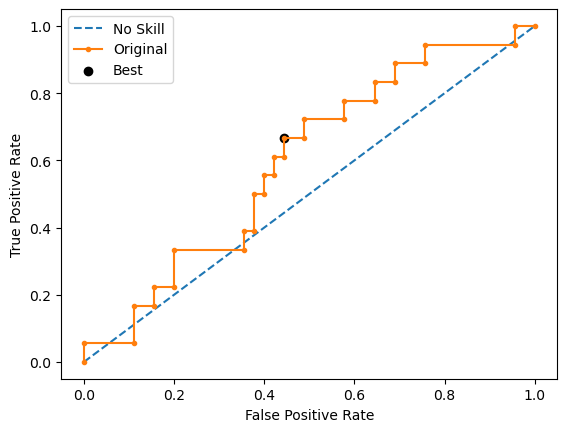

Ave Test G-mean: 0.5803374329783315
Stdev Test G-mean: 0.06332913906844755
Ave Test Specificity: 0.5244444444444444
Ave Test Recall: 0.6444444444444445
Ave Test NPV: 0.7854500338371306
Ave Test Accuracy: 0.5587301587301587
Ave Test Precision: 0.3528685503685504
Ave Test F1-Score: 0.45558823529411774
Ave Runtime: 0.21040983200073243


In [22]:
ho_t02_xgb_gs, ho_t02_xgb_be, ho_t02_xgb_model_info, ho_t02_xgb_metrics_df = xgb_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimato

[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomOverSampler(random_state=0);, score=

[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=20, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.0

[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 3/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 4/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score

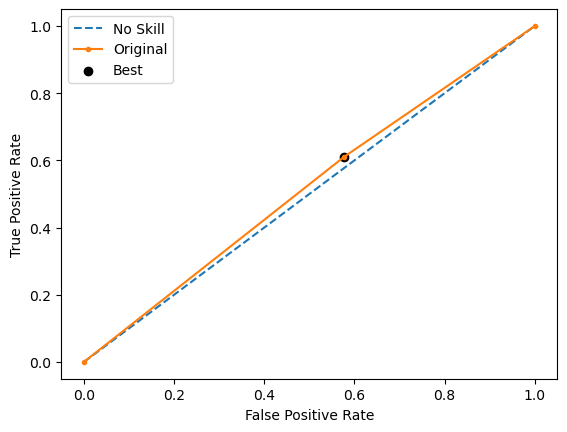

Run 2 - Random State: 1
Test G-mean: 0.5443310539518174
Best Threshold=0.880797, G-Mean=0.544


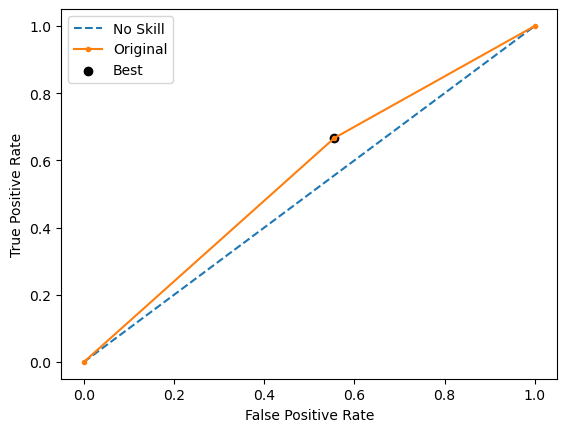

Run 3 - Random State: 2
Test G-mean: 0.5879447357921312
Best Threshold=0.880797, G-Mean=0.588


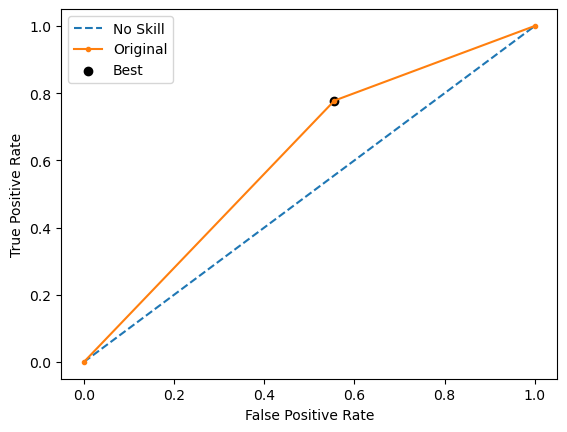

Run 4 - Random State: 3
Test G-mean: 0.607565471755214
Best Threshold=0.880797, G-Mean=0.608


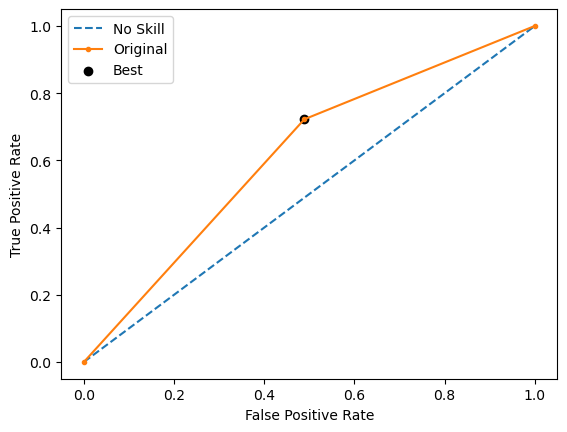

Run 5 - Random State: 4
Test G-mean: 0.4714045207910317
Best Threshold=0.880797, G-Mean=0.471


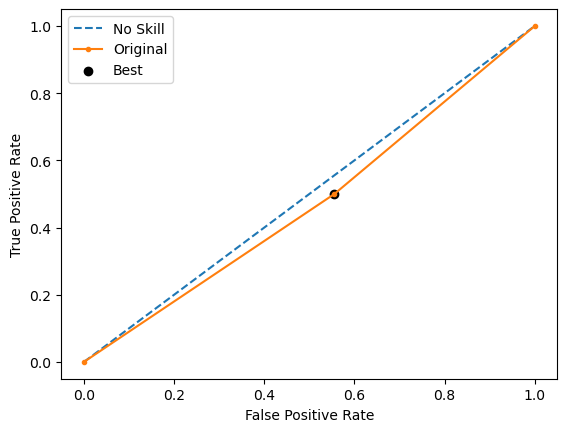

Ave Test G-mean: 0.5438414182417052
Stdev Test G-mean: 0.05599237384593436
Ave Test Specificity: 0.4533333333333333
Ave Test Recall: 0.6555555555555556
Ave Test NPV: 0.7688834154351396
Ave Test Accuracy: 0.5111111111111111
Ave Test Precision: 0.32334608687549865
Ave Test F1-Score: 0.432862318085754
Ave Runtime: 0.05230879783630371


In [23]:
ho_t02_adaboost_gs, ho_t02_adaboost_be, ho_t02_adaboost_model_info, ho_t02_adaboost_metrics_df = adaboost_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=20, classifier__n_estimators=250, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.000) total time=   0.0s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=None, classifier__max_leaves=30, classifier__n_estimators=200, resampling=EditedN

[CV 4/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=1.000) total time=   0.0s
[CV 5/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.833) total time=   0.0s
[CV 6/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 3/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.0

[CV 9/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 10/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=2, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.600) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.167) total time=   0.0s
[CV 8/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=10, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.0

[CV 3/10] END classifier__algorithm=SAMME, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 4/10] END classifier__algorithm=SAMME, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.600) total time=   0.0s
[CV 1/10] END classifier__algorithm=SAMME, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=300, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 2/10] END classifier__algorithm=SAMME, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=300, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 3/10] END classifier__algorithm=SAMME, classifier__estimator=D

[CV 1/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.400) total time=   0.0s
[CV 2/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.800) total time=   0.0s
[CV 7/10] END classifier__grow_policy=lossguide, classifier__learning_rate=1, classifier__max_depth=3, classifier__max_leaves=30, classifier__n_estimators=250, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 10/10] END classifier__algorithm=SAMME, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=200, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.600) total time=   0.0s
[CV 6/10] END class

[CV 2/10] END classifier__algorithm=SAMME, classifier__estimator=RandomForestClassifier(random_state=0), classifier__n_estimators=300, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.000) total time=   0.1s
[CV 3/10] END classifier__algorithm=SAMME, classifier__estimator=RandomForestClassifier(random_state=0), classifier__n_estimators=300, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.000) total time=   0.1s
[CV 4/10] END classifier__algorithm=SAMME, classifier__estimator=RandomForestClassifier(random_state=0), classifier__n_estimators=300, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.000) total time=   0.1s
[CV 5/10] END classifier__algorithm=SAMME, classifier__estimator=RandomForestClassifier(random_state=0), classifier__n_estimators=300, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.1s
[CV 6/10] END classifier__algorithm=SAMME, classifier__estimator=Ran

[CV 6/10] END classifier__algorithm=SAMME.R, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 7/10] END classifier__algorithm=SAMME.R, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.500) total time=   0.0s
[CV 8/10] END classifier__algorithm=SAMME.R, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.667) total time=   0.0s
[CV 9/10] END classifier__algorithm=SAMME.R, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=200, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 10/10] END classifier__algorithm=SAMME.R, classifier

[CV 10/10] END classifier__algorithm=SAMME.R, classifier__estimator=DecisionTreeClassifier(random_state=0), classifier__n_estimators=300, resampling=RandomUnderSampler(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 7/10] END classifier__algorithm=SAMME.R, classifier__estimator=RandomForestClassifier(random_state=0), classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.000) total time=   0.1s
[CV 8/10] END classifier__algorithm=SAMME.R, classifier__estimator=RandomForestClassifier(random_state=0), classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   0.1s
[CV 9/10] END classifier__algorithm=SAMME.R, classifier__estimator=RandomForestClassifier(random_state=0), classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.400) total time=   0.1s
[CV 10/10] END classifier__algorithm=SAMME.R, classifier__estimator=RandomForestClassifier(

[CV 9/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__n_estimators=400, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.000) total time=   0.0s
[CV 10/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__n_estimators=400, resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.400) total time=   0.0s
[CV 1/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__n_estimators=400, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 2/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__n_estimators=400, resampling=EditedNearestNeighbours();, score=(train=1.000, test=0.600) total time=   0.0s
[CV 3/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=2, classifier__n_e

[CV 5/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.958, test=0.833) total time=   0.0s
[CV 6/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.875, test=0.667) total time=   0.0s
[CV 7/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.833, test=0.667) total time=   0.0s
[CV 8/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.750, test=0.333) total time=   0.0s
[CV 9/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, class

[CV 5/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 6/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.333) total time=   0.0s
[CV 9/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=400, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 10/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=400, resampling=SMOTE(random_state=0);, score=(train=1.000, test=0.200) total time=   0.0s
[CV 1/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.1, classifier__max_depth=3, c

[CV 2/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=300, resampling=EditedNearestNeighbours();, score=(train=0.918, test=1.000) total time=   0.0s
[CV 3/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=300, resampling=EditedNearestNeighbours();, score=(train=0.918, test=0.600) total time=   0.0s
[CV 4/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=300, resampling=EditedNearestNeighbours();, score=(train=0.837, test=0.800) total time=   0.0s
[CV 5/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=300, resampling=EditedNearestNeighbours();, score=(train=0.958, test=0.833) total time=   0.0s
[CV 6/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=2, class

[CV 1/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=400, resampling=SMOTE(random_state=0);, score=(train=0.633, test=0.200) total time=   0.0s
[CV 2/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=400, resampling=SMOTE(random_state=0);, score=(train=0.653, test=0.000) total time=   0.0s
[CV 7/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.646, test=0.167) total time=   0.0s
[CV 8/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=ADASYN(random_state=0);, score=(train=0.646, test=0.167) total time=   0.0s
[CV 9/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estim

[CV 8/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=RandomOverSampler(random_state=0);, score=(train=0.958, test=0.167) total time=   0.0s
[CV 9/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=RandomOverSampler(random_state=0);, score=(train=0.939, test=0.200) total time=   0.0s
[CV 10/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=RandomOverSampler(random_state=0);, score=(train=0.918, test=0.200) total time=   0.0s
[CV 1/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=RandomUnderSampler(random_state=0);, score=(train=0.918, test=1.000) total time=   0.0s
[CV 2/10] END classifier__boosting_type=gbdt, classifier__learning_rate=0.

Best Hyperparameters: {'classifier__boosting_type': 'goss', 'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.6933333333333332
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LGBMClassifier(boosting_type='goss', max_depth=3,
                                n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8404565854119426
Std Train Score (G-mean) 0.04047852442459255
GridSearchCV Runtime: 6.975452184677124 secs
Run 1 - Random State: 0
Test G-mean: 0.5522121617684079
Best Threshold=0.543876, G-Mean=0.559


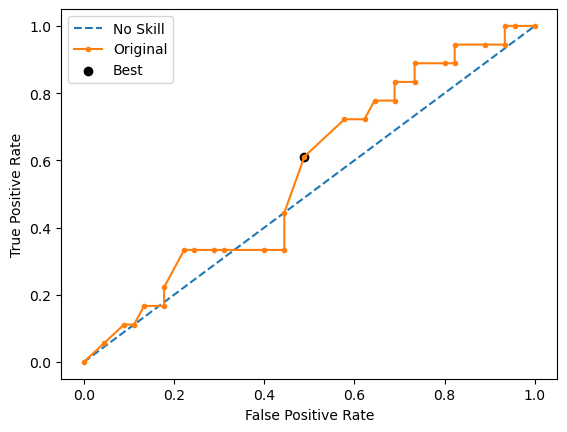

Run 2 - Random State: 1
Test G-mean: 0.5211573066470477
Best Threshold=0.533673, G-Mean=0.556


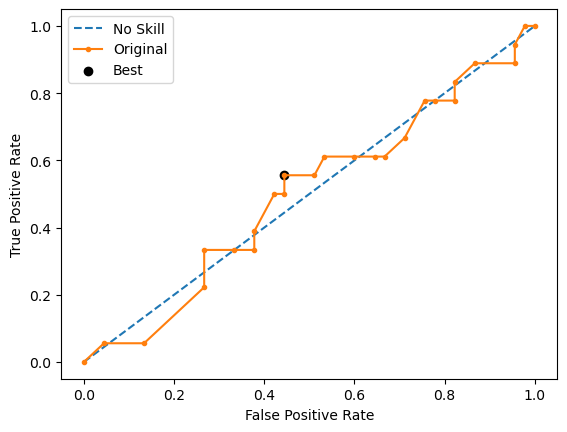

Run 3 - Random State: 2
Test G-mean: 0.5962847939999438
Best Threshold=0.579882, G-Mean=0.678


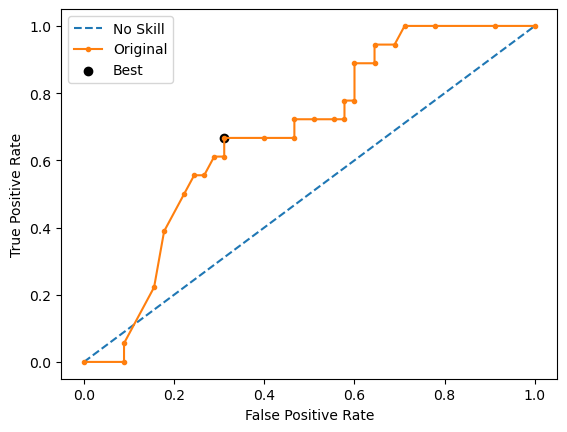

Run 4 - Random State: 3
Test G-mean: 0.6573421981221796
Best Threshold=0.501073, G-Mean=0.657


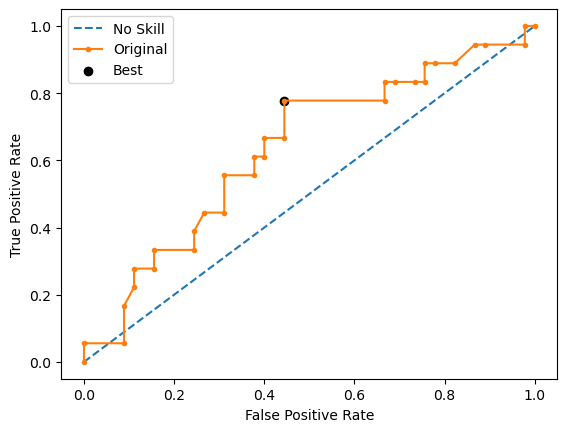

Run 5 - Random State: 4
Test G-mean: 0.48304589153964794
Best Threshold=0.585884, G-Mean=0.524


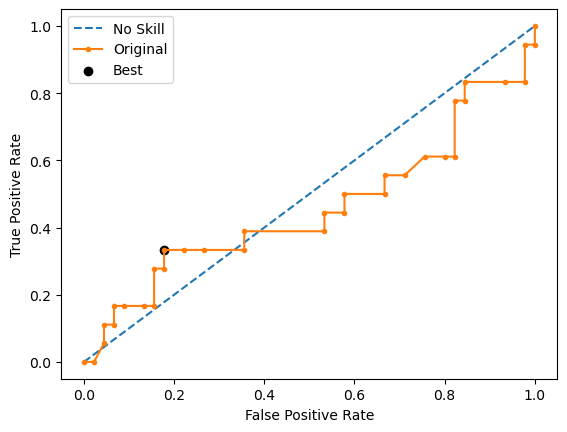

Ave Test G-mean: 0.5620084704154454
Stdev Test G-mean: 0.06757081489812743
Ave Test Specificity: 0.52
Ave Test Recall: 0.6222222222222221
Ave Test NPV: 0.779519056261343
Ave Test Accuracy: 0.5492063492063493
Ave Test Precision: 0.3383529411764706
Ave Test F1-Score: 0.4365856765453569
Ave Runtime: 0.10594062805175782


In [24]:
ho_t02_lgbm_gs, ho_t02_lgbm_be, ho_t02_lgbm_model_info, ho_t02_lgbm_metrics_df = lgbm_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
[CV 2/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=400, resampling=SMOTE(random_state=0);, score=(train=0.490, test=0.000) total time=   0.1s
[CV 5/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.812, test=0.667) total time=   0.0s
[CV 6/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.792, test=0.667) total time=   0.0s
[CV 7/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=200, resampling=EditedNearestNeighbours();, score=(train=0.750, test=0.500) total time=   0.0s
[CV 8/10] END classifier__boosting_type=dart, class

[CV 1/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=EditedNearestNeighbours();, score=(train=0.755, test=0.600) total time=   0.0s
[CV 2/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=EditedNearestNeighbours();, score=(train=0.857, test=0.800) total time=   0.0s
[CV 3/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=EditedNearestNeighbours();, score=(train=0.898, test=0.600) total time=   0.0s
[CV 4/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=EditedNearestNeighbours();, score=(train=0.612, test=0.600) total time=   0.1s
[CV 5/10] END classifier__boosting_type=dart, classifier__learning_rate=0.01, classifier__max_depth=3, class

[CV 10/10] END classifier__boosting_type=goss, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=300, resampling=ADASYN(random_state=0);, score=(train=0.918, test=0.200) total time=   0.0s
[CV 1/10] END classifier__boosting_type=goss, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=300, resampling=EditedNearestNeighbours();, score=(train=0.776, test=0.600) total time=   0.0s
[CV 2/10] END classifier__boosting_type=goss, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=300, resampling=EditedNearestNeighbours();, score=(train=0.898, test=1.000) total time=   0.0s
[CV 3/10] END classifier__boosting_type=goss, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=300, resampling=EditedNearestNeighbours();, score=(train=0.959, test=0.800) total time=   0.0s
[CV 4/10] END classifier__boosting_type=goss, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__

[CV 7/10] END classifier__boosting_type=goss, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=0.792, test=0.167) total time=   0.0s
[CV 8/10] END classifier__boosting_type=goss, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=200, resampling=RandomOverSampler(random_state=0);, score=(train=0.688, test=0.500) total time=   0.0s
[CV 1/10] END classifier__boosting_type=goss, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=400, resampling=ADASYN(random_state=0);, score=(train=0.653, test=0.200) total time=   0.0s
[CV 2/10] END classifier__boosting_type=goss, classifier__learning_rate=0.01, classifier__max_depth=2, classifier__n_estimators=400, resampling=ADASYN(random_state=0);, score=(train=0.694, test=0.000) total time=   0.0s
[CV 3/10] END classifier__boosting_type=goss, classifier__learning_rate=0.01, classifier__max_dept

[CV 10/10] END classifier__boosting_type=goss, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=RandomOverSampler(random_state=0);, score=(train=0.816, test=0.400) total time=   0.0s
[CV 9/10] END classifier__boosting_type=goss, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=400, resampling=RandomUnderSampler(random_state=0);, score=(train=0.837, test=0.600) total time=   0.0s
Learning rate set to 0.005601
0:	learn: 0.6903262	total: 59ms	remaining: 58.9s
1:	learn: 0.6877802	total: 60.7ms	remaining: 30.3s
2:	learn: 0.6863245	total: 64.1ms	remaining: 21.3s
3:	learn: 0.6836951	total: 65.9ms	remaining: 16.4s
4:	learn: 0.6816356	total: 68.5ms	remaining: 13.6s
5:	learn: 0.6790501	total: 70.5ms	remaining: 11.7s
6:	learn: 0.6768225	total: 72.4ms	remaining: 10.3s
7:	learn: 0.6744458	total: 75.5ms	remaining: 9.36s
8:	learn: 0.6722188	total: 78.3ms	remaining: 8.62s
9:	learn: 0.6700986	total: 81.5ms	remaining: 8.07

123:	learn: 0.4849554	total: 388ms	remaining: 2.74s
124:	learn: 0.4838029	total: 390ms	remaining: 2.73s
125:	learn: 0.4823386	total: 394ms	remaining: 2.73s
126:	learn: 0.4811803	total: 397ms	remaining: 2.73s
127:	learn: 0.4800133	total: 404ms	remaining: 2.75s
128:	learn: 0.4787314	total: 412ms	remaining: 2.78s
129:	learn: 0.4775507	total: 421ms	remaining: 2.82s
130:	learn: 0.4764902	total: 426ms	remaining: 2.83s
131:	learn: 0.4756629	total: 432ms	remaining: 2.84s
132:	learn: 0.4740985	total: 439ms	remaining: 2.86s
133:	learn: 0.4727986	total: 445ms	remaining: 2.87s
134:	learn: 0.4717114	total: 451ms	remaining: 2.89s
135:	learn: 0.4702906	total: 458ms	remaining: 2.91s
136:	learn: 0.4689765	total: 465ms	remaining: 2.93s
137:	learn: 0.4675622	total: 471ms	remaining: 2.94s
138:	learn: 0.4664018	total: 473ms	remaining: 2.93s
139:	learn: 0.4654384	total: 478ms	remaining: 2.94s
140:	learn: 0.4642322	total: 480ms	remaining: 2.93s
141:	learn: 0.4630001	total: 483ms	remaining: 2.92s
142:	learn: 

238:	learn: 0.3669973	total: 789ms	remaining: 2.51s
239:	learn: 0.3660031	total: 791ms	remaining: 2.5s
240:	learn: 0.3650709	total: 793ms	remaining: 2.5s
241:	learn: 0.3645514	total: 795ms	remaining: 2.49s
242:	learn: 0.3638937	total: 797ms	remaining: 2.48s
243:	learn: 0.3631622	total: 800ms	remaining: 2.48s
244:	learn: 0.3621804	total: 803ms	remaining: 2.47s
245:	learn: 0.3611789	total: 806ms	remaining: 2.47s
246:	learn: 0.3603501	total: 810ms	remaining: 2.47s
247:	learn: 0.3596846	total: 814ms	remaining: 2.47s
248:	learn: 0.3590116	total: 816ms	remaining: 2.46s
249:	learn: 0.3586526	total: 821ms	remaining: 2.46s
250:	learn: 0.3578514	total: 824ms	remaining: 2.46s
251:	learn: 0.3573047	total: 826ms	remaining: 2.45s
252:	learn: 0.3564517	total: 829ms	remaining: 2.45s
253:	learn: 0.3553670	total: 831ms	remaining: 2.44s
254:	learn: 0.3546394	total: 833ms	remaining: 2.43s
255:	learn: 0.3538515	total: 836ms	remaining: 2.43s
256:	learn: 0.3530717	total: 839ms	remaining: 2.42s
257:	learn: 0.

303:	learn: 0.3366686	total: 1.01s	remaining: 2.33s
304:	learn: 0.3360326	total: 1.02s	remaining: 2.32s
305:	learn: 0.3353578	total: 1.02s	remaining: 2.31s
306:	learn: 0.3347436	total: 1.02s	remaining: 2.31s
307:	learn: 0.3339763	total: 1.02s	remaining: 2.3s
308:	learn: 0.3330762	total: 1.03s	remaining: 2.3s
309:	learn: 0.3325439	total: 1.03s	remaining: 2.29s
310:	learn: 0.3319304	total: 1.03s	remaining: 2.29s
311:	learn: 0.3311495	total: 1.04s	remaining: 2.29s
312:	learn: 0.3306000	total: 1.04s	remaining: 2.28s
313:	learn: 0.3300209	total: 1.04s	remaining: 2.28s
314:	learn: 0.3295845	total: 1.04s	remaining: 2.27s
315:	learn: 0.3286651	total: 1.05s	remaining: 2.27s
316:	learn: 0.3281075	total: 1.05s	remaining: 2.26s
317:	learn: 0.3272375	total: 1.05s	remaining: 2.26s
318:	learn: 0.3263653	total: 1.05s	remaining: 2.25s
319:	learn: 0.3258538	total: 1.06s	remaining: 2.25s
320:	learn: 0.3251646	total: 1.06s	remaining: 2.24s
321:	learn: 0.3245614	total: 1.06s	remaining: 2.24s
322:	learn: 0.

378:	learn: 0.2961178	total: 1.16s	remaining: 1.91s
379:	learn: 0.2955399	total: 1.17s	remaining: 1.91s
380:	learn: 0.2948237	total: 1.17s	remaining: 1.91s
381:	learn: 0.2945197	total: 1.17s	remaining: 1.9s
382:	learn: 0.2940325	total: 1.18s	remaining: 1.9s
383:	learn: 0.2932496	total: 1.18s	remaining: 1.89s
384:	learn: 0.2924769	total: 1.18s	remaining: 1.89s
385:	learn: 0.2916269	total: 1.19s	remaining: 1.89s
386:	learn: 0.2909901	total: 1.2s	remaining: 1.9s
387:	learn: 0.2904201	total: 1.2s	remaining: 1.89s
388:	learn: 0.2898242	total: 1.2s	remaining: 1.89s
389:	learn: 0.2895468	total: 1.21s	remaining: 1.89s
390:	learn: 0.2890333	total: 1.21s	remaining: 1.88s
391:	learn: 0.2884897	total: 1.21s	remaining: 1.88s
392:	learn: 0.2881452	total: 1.21s	remaining: 1.87s
393:	learn: 0.2877976	total: 1.22s	remaining: 1.87s
394:	learn: 0.2872217	total: 1.22s	remaining: 1.86s
395:	learn: 0.2868716	total: 1.22s	remaining: 1.86s
396:	learn: 0.2864818	total: 1.22s	remaining: 1.86s
397:	learn: 0.2857

465:	learn: 0.2458174	total: 1.43s	remaining: 1.63s
466:	learn: 0.2456151	total: 1.43s	remaining: 1.63s
467:	learn: 0.2452002	total: 1.43s	remaining: 1.63s
468:	learn: 0.2447631	total: 1.43s	remaining: 1.62s
469:	learn: 0.2442520	total: 1.43s	remaining: 1.62s
470:	learn: 0.2440779	total: 1.44s	remaining: 1.61s
471:	learn: 0.2435720	total: 1.44s	remaining: 1.61s
472:	learn: 0.2431907	total: 1.44s	remaining: 1.61s
473:	learn: 0.2429046	total: 1.45s	remaining: 1.6s
474:	learn: 0.2427090	total: 1.45s	remaining: 1.6s
475:	learn: 0.2422452	total: 1.45s	remaining: 1.6s
476:	learn: 0.2418336	total: 1.45s	remaining: 1.59s
477:	learn: 0.2413922	total: 1.46s	remaining: 1.59s
478:	learn: 0.2410606	total: 1.46s	remaining: 1.59s
479:	learn: 0.2406831	total: 1.46s	remaining: 1.59s
480:	learn: 0.2400456	total: 1.47s	remaining: 1.58s
481:	learn: 0.2397496	total: 1.47s	remaining: 1.58s
482:	learn: 0.2393795	total: 1.47s	remaining: 1.58s
483:	learn: 0.2390332	total: 1.48s	remaining: 1.57s
484:	learn: 0.2

618:	learn: 0.1767457	total: 1.93s	remaining: 1.19s
619:	learn: 0.1762690	total: 1.94s	remaining: 1.19s
620:	learn: 0.1759365	total: 1.94s	remaining: 1.18s
621:	learn: 0.1757113	total: 1.94s	remaining: 1.18s
622:	learn: 0.1752359	total: 1.94s	remaining: 1.18s
623:	learn: 0.1750082	total: 1.95s	remaining: 1.17s
624:	learn: 0.1747407	total: 1.95s	remaining: 1.17s
625:	learn: 0.1743907	total: 1.95s	remaining: 1.17s
626:	learn: 0.1741715	total: 1.95s	remaining: 1.16s
627:	learn: 0.1740518	total: 1.96s	remaining: 1.16s
628:	learn: 0.1738404	total: 1.96s	remaining: 1.16s
629:	learn: 0.1735428	total: 1.96s	remaining: 1.15s
630:	learn: 0.1731934	total: 1.96s	remaining: 1.15s
631:	learn: 0.1729872	total: 1.97s	remaining: 1.15s
632:	learn: 0.1727697	total: 1.97s	remaining: 1.14s
633:	learn: 0.1725024	total: 1.97s	remaining: 1.14s
634:	learn: 0.1722211	total: 1.98s	remaining: 1.14s
635:	learn: 0.1718627	total: 1.98s	remaining: 1.13s
636:	learn: 0.1715412	total: 1.98s	remaining: 1.13s
637:	learn: 

593:	learn: 0.2076258	total: 1.8s	remaining: 1.23s
594:	learn: 0.2073148	total: 1.8s	remaining: 1.23s
595:	learn: 0.2070752	total: 1.8s	remaining: 1.22s
596:	learn: 0.2067207	total: 1.81s	remaining: 1.22s
597:	learn: 0.2064395	total: 1.81s	remaining: 1.22s
598:	learn: 0.2061385	total: 1.81s	remaining: 1.21s
599:	learn: 0.2058569	total: 1.81s	remaining: 1.21s
600:	learn: 0.2056472	total: 1.81s	remaining: 1.21s
601:	learn: 0.2053394	total: 1.82s	remaining: 1.2s
602:	learn: 0.2048847	total: 1.82s	remaining: 1.2s
603:	learn: 0.2046391	total: 1.82s	remaining: 1.19s
604:	learn: 0.2043826	total: 1.82s	remaining: 1.19s
605:	learn: 0.2040157	total: 1.82s	remaining: 1.19s
606:	learn: 0.2035524	total: 1.83s	remaining: 1.18s
607:	learn: 0.2033174	total: 1.83s	remaining: 1.18s
608:	learn: 0.2029812	total: 1.83s	remaining: 1.18s
609:	learn: 0.2025377	total: 1.83s	remaining: 1.17s
610:	learn: 0.2020808	total: 1.84s	remaining: 1.17s
611:	learn: 0.2018675	total: 1.84s	remaining: 1.17s
612:	learn: 0.201

933:	learn: 0.1100129	total: 2.89s	remaining: 204ms
934:	learn: 0.1098887	total: 2.89s	remaining: 201ms
935:	learn: 0.1097217	total: 2.89s	remaining: 198ms
936:	learn: 0.1095149	total: 2.9s	remaining: 195ms
937:	learn: 0.1092927	total: 2.9s	remaining: 192ms
938:	learn: 0.1091144	total: 2.9s	remaining: 189ms
939:	learn: 0.1089509	total: 2.91s	remaining: 186ms
940:	learn: 0.1087674	total: 2.91s	remaining: 182ms
941:	learn: 0.1086293	total: 2.91s	remaining: 179ms
942:	learn: 0.1084922	total: 2.92s	remaining: 176ms
943:	learn: 0.1084327	total: 2.92s	remaining: 173ms
944:	learn: 0.1083027	total: 2.92s	remaining: 170ms
945:	learn: 0.1081447	total: 2.93s	remaining: 167ms
946:	learn: 0.1079270	total: 2.93s	remaining: 164ms
947:	learn: 0.1077393	total: 2.93s	remaining: 161ms
948:	learn: 0.1075189	total: 2.93s	remaining: 158ms
949:	learn: 0.1073859	total: 2.93s	remaining: 154ms
950:	learn: 0.1072345	total: 2.94s	remaining: 151ms
951:	learn: 0.1070712	total: 2.94s	remaining: 148ms
952:	learn: 0.1

908:	learn: 0.1310161	total: 2.89s	remaining: 289ms
909:	learn: 0.1308408	total: 2.9s	remaining: 286ms
910:	learn: 0.1306751	total: 2.9s	remaining: 284ms
911:	learn: 0.1305127	total: 2.91s	remaining: 281ms
912:	learn: 0.1303417	total: 2.92s	remaining: 278ms
913:	learn: 0.1301594	total: 2.93s	remaining: 275ms
914:	learn: 0.1300093	total: 2.93s	remaining: 272ms
915:	learn: 0.1298023	total: 2.94s	remaining: 269ms
916:	learn: 0.1296419	total: 2.94s	remaining: 266ms
917:	learn: 0.1294955	total: 2.95s	remaining: 264ms
918:	learn: 0.1293027	total: 2.96s	remaining: 261ms
919:	learn: 0.1292271	total: 2.96s	remaining: 258ms
920:	learn: 0.1291252	total: 2.97s	remaining: 255ms
921:	learn: 0.1289370	total: 2.97s	remaining: 251ms
922:	learn: 0.1287801	total: 2.98s	remaining: 248ms
923:	learn: 0.1285509	total: 2.98s	remaining: 246ms
924:	learn: 0.1283763	total: 2.99s	remaining: 243ms
925:	learn: 0.1281974	total: 3s	remaining: 240ms
926:	learn: 0.1281076	total: 3.01s	remaining: 237ms
927:	learn: 0.127

6:	learn: 0.6777992	total: 19.2ms	remaining: 2.72s
7:	learn: 0.6754808	total: 22.1ms	remaining: 2.73s
8:	learn: 0.6734471	total: 26.9ms	remaining: 2.97s
9:	learn: 0.6718471	total: 30.5ms	remaining: 3.02s
10:	learn: 0.6699823	total: 32.7ms	remaining: 2.94s
11:	learn: 0.6676923	total: 35.2ms	remaining: 2.9s
12:	learn: 0.6657127	total: 38.1ms	remaining: 2.89s
13:	learn: 0.6631177	total: 40.1ms	remaining: 2.83s
14:	learn: 0.6604584	total: 42.3ms	remaining: 2.77s
15:	learn: 0.6592411	total: 44.2ms	remaining: 2.72s
16:	learn: 0.6573751	total: 46.4ms	remaining: 2.68s
17:	learn: 0.6558177	total: 48.8ms	remaining: 2.66s
18:	learn: 0.6533675	total: 51ms	remaining: 2.63s
19:	learn: 0.6516322	total: 55.1ms	remaining: 2.7s
20:	learn: 0.6492234	total: 59.4ms	remaining: 2.77s
21:	learn: 0.6471607	total: 61.8ms	remaining: 2.75s
22:	learn: 0.6455045	total: 66.2ms	remaining: 2.81s
23:	learn: 0.6435055	total: 69.4ms	remaining: 2.82s
24:	learn: 0.6411711	total: 71.1ms	remaining: 2.77s
25:	learn: 0.6393465

869:	learn: 0.1307121	total: 2.6s	remaining: 388ms
870:	learn: 0.1305299	total: 2.6s	remaining: 385ms
871:	learn: 0.1303623	total: 2.6s	remaining: 382ms
872:	learn: 0.1301861	total: 2.6s	remaining: 379ms
873:	learn: 0.1300082	total: 2.61s	remaining: 376ms
874:	learn: 0.1297672	total: 2.61s	remaining: 373ms
875:	learn: 0.1294936	total: 2.61s	remaining: 370ms
876:	learn: 0.1293310	total: 2.62s	remaining: 367ms
877:	learn: 0.1290904	total: 2.62s	remaining: 364ms
878:	learn: 0.1288734	total: 2.62s	remaining: 361ms
879:	learn: 0.1286369	total: 2.62s	remaining: 358ms
880:	learn: 0.1284125	total: 2.63s	remaining: 355ms
881:	learn: 0.1281409	total: 2.63s	remaining: 352ms
882:	learn: 0.1279006	total: 2.63s	remaining: 349ms
883:	learn: 0.1277847	total: 2.63s	remaining: 346ms
884:	learn: 0.1276276	total: 2.63s	remaining: 342ms
885:	learn: 0.1274960	total: 2.64s	remaining: 339ms
886:	learn: 0.1272996	total: 2.64s	remaining: 336ms
887:	learn: 0.1271215	total: 2.64s	remaining: 333ms
888:	learn: 0.12

222:	learn: 0.3792447	total: 619ms	remaining: 2.16s
223:	learn: 0.3782857	total: 621ms	remaining: 2.15s
224:	learn: 0.3775640	total: 623ms	remaining: 2.15s
225:	learn: 0.3768297	total: 625ms	remaining: 2.14s
226:	learn: 0.3759472	total: 629ms	remaining: 2.14s
227:	learn: 0.3754736	total: 633ms	remaining: 2.14s
228:	learn: 0.3746799	total: 637ms	remaining: 2.15s
229:	learn: 0.3741874	total: 640ms	remaining: 2.14s
230:	learn: 0.3734999	total: 641ms	remaining: 2.13s
231:	learn: 0.3726979	total: 643ms	remaining: 2.13s
232:	learn: 0.3719931	total: 645ms	remaining: 2.12s
233:	learn: 0.3712506	total: 648ms	remaining: 2.12s
234:	learn: 0.3704176	total: 650ms	remaining: 2.12s
235:	learn: 0.3695110	total: 652ms	remaining: 2.11s
236:	learn: 0.3690086	total: 656ms	remaining: 2.11s
237:	learn: 0.3680918	total: 657ms	remaining: 2.1s
238:	learn: 0.3672123	total: 664ms	remaining: 2.11s
239:	learn: 0.3663546	total: 666ms	remaining: 2.11s
240:	learn: 0.3655945	total: 668ms	remaining: 2.1s
241:	learn: 0.

878:	learn: 0.1258718	total: 4.19s	remaining: 577ms
879:	learn: 0.1256990	total: 4.2s	remaining: 572ms
880:	learn: 0.1255957	total: 4.2s	remaining: 567ms
881:	learn: 0.1254478	total: 4.2s	remaining: 562ms
882:	learn: 0.1253214	total: 4.2s	remaining: 557ms
883:	learn: 0.1250106	total: 4.21s	remaining: 552ms
884:	learn: 0.1247968	total: 4.21s	remaining: 547ms
885:	learn: 0.1246620	total: 4.21s	remaining: 542ms
886:	learn: 0.1244028	total: 4.21s	remaining: 537ms
887:	learn: 0.1242442	total: 4.22s	remaining: 532ms
888:	learn: 0.1241310	total: 4.22s	remaining: 527ms
889:	learn: 0.1239401	total: 4.22s	remaining: 522ms
890:	learn: 0.1237159	total: 4.22s	remaining: 517ms
891:	learn: 0.1235418	total: 4.22s	remaining: 512ms
892:	learn: 0.1234204	total: 4.23s	remaining: 507ms
893:	learn: 0.1232383	total: 4.23s	remaining: 501ms
894:	learn: 0.1229744	total: 4.23s	remaining: 496ms
895:	learn: 0.1227840	total: 4.23s	remaining: 491ms
896:	learn: 0.1225973	total: 4.24s	remaining: 486ms
897:	learn: 0.12

905:	learn: 0.1173430	total: 2.72s	remaining: 282ms
906:	learn: 0.1171077	total: 2.72s	remaining: 279ms
907:	learn: 0.1168931	total: 2.72s	remaining: 276ms
908:	learn: 0.1166577	total: 2.73s	remaining: 273ms
909:	learn: 0.1164994	total: 2.73s	remaining: 271ms
910:	learn: 0.1162478	total: 2.74s	remaining: 268ms
911:	learn: 0.1160722	total: 2.75s	remaining: 265ms
912:	learn: 0.1158809	total: 2.75s	remaining: 262ms
913:	learn: 0.1156744	total: 2.76s	remaining: 259ms
914:	learn: 0.1155040	total: 2.76s	remaining: 257ms
915:	learn: 0.1153113	total: 2.77s	remaining: 254ms
916:	learn: 0.1151620	total: 2.78s	remaining: 251ms
917:	learn: 0.1149799	total: 2.79s	remaining: 249ms
918:	learn: 0.1147281	total: 2.79s	remaining: 246ms
919:	learn: 0.1145937	total: 2.8s	remaining: 244ms
920:	learn: 0.1143833	total: 2.81s	remaining: 241ms
921:	learn: 0.1142452	total: 2.81s	remaining: 238ms
922:	learn: 0.1140657	total: 2.82s	remaining: 235ms
923:	learn: 0.1138986	total: 2.83s	remaining: 232ms
924:	learn: 0

409:	learn: 0.2714631	total: 1.17s	remaining: 1.68s
410:	learn: 0.2710478	total: 1.17s	remaining: 1.68s
411:	learn: 0.2704297	total: 1.17s	remaining: 1.67s
412:	learn: 0.2701779	total: 1.18s	remaining: 1.67s
413:	learn: 0.2697287	total: 1.18s	remaining: 1.67s
414:	learn: 0.2689848	total: 1.18s	remaining: 1.67s
415:	learn: 0.2686633	total: 1.19s	remaining: 1.66s
416:	learn: 0.2682474	total: 1.19s	remaining: 1.66s
417:	learn: 0.2677125	total: 1.19s	remaining: 1.66s
418:	learn: 0.2672060	total: 1.19s	remaining: 1.65s
419:	learn: 0.2669575	total: 1.19s	remaining: 1.65s
420:	learn: 0.2664274	total: 1.2s	remaining: 1.65s
421:	learn: 0.2661219	total: 1.2s	remaining: 1.64s
422:	learn: 0.2656990	total: 1.2s	remaining: 1.64s
423:	learn: 0.2652170	total: 1.2s	remaining: 1.64s
424:	learn: 0.2647189	total: 1.21s	remaining: 1.63s
425:	learn: 0.2643363	total: 1.21s	remaining: 1.63s
426:	learn: 0.2637184	total: 1.21s	remaining: 1.63s
427:	learn: 0.2632068	total: 1.21s	remaining: 1.62s
428:	learn: 0.26

639:	learn: 0.1934931	total: 1.69s	remaining: 952ms
640:	learn: 0.1931757	total: 1.69s	remaining: 949ms
641:	learn: 0.1928973	total: 1.7s	remaining: 947ms
642:	learn: 0.1925565	total: 1.7s	remaining: 945ms
643:	learn: 0.1920601	total: 1.7s	remaining: 942ms
644:	learn: 0.1916239	total: 1.71s	remaining: 940ms
645:	learn: 0.1913686	total: 1.71s	remaining: 937ms
646:	learn: 0.1910615	total: 1.71s	remaining: 934ms
647:	learn: 0.1907521	total: 1.71s	remaining: 931ms
648:	learn: 0.1905434	total: 1.72s	remaining: 928ms
649:	learn: 0.1901767	total: 1.72s	remaining: 925ms
650:	learn: 0.1898198	total: 1.72s	remaining: 923ms
651:	learn: 0.1895827	total: 1.72s	remaining: 920ms
652:	learn: 0.1894603	total: 1.73s	remaining: 917ms
653:	learn: 0.1891116	total: 1.73s	remaining: 914ms
654:	learn: 0.1888024	total: 1.73s	remaining: 911ms
655:	learn: 0.1883654	total: 1.73s	remaining: 908ms
656:	learn: 0.1881681	total: 1.74s	remaining: 906ms
657:	learn: 0.1877838	total: 1.74s	remaining: 904ms
658:	learn: 0.1

569:	learn: 0.1859700	total: 1.6s	remaining: 1.21s
570:	learn: 0.1855729	total: 1.61s	remaining: 1.21s
571:	learn: 0.1853177	total: 1.61s	remaining: 1.2s
572:	learn: 0.1850865	total: 1.61s	remaining: 1.2s
573:	learn: 0.1848485	total: 1.61s	remaining: 1.2s
574:	learn: 0.1845169	total: 1.61s	remaining: 1.19s
575:	learn: 0.1841256	total: 1.62s	remaining: 1.19s
576:	learn: 0.1836726	total: 1.62s	remaining: 1.19s
577:	learn: 0.1832231	total: 1.62s	remaining: 1.19s
578:	learn: 0.1830646	total: 1.63s	remaining: 1.18s
579:	learn: 0.1826932	total: 1.63s	remaining: 1.18s
580:	learn: 0.1823745	total: 1.63s	remaining: 1.18s
581:	learn: 0.1820795	total: 1.63s	remaining: 1.17s
582:	learn: 0.1817295	total: 1.64s	remaining: 1.17s
583:	learn: 0.1814441	total: 1.64s	remaining: 1.17s
584:	learn: 0.1811106	total: 1.64s	remaining: 1.17s
585:	learn: 0.1809466	total: 1.65s	remaining: 1.17s
586:	learn: 0.1807462	total: 1.65s	remaining: 1.16s
587:	learn: 0.1803241	total: 1.66s	remaining: 1.16s
588:	learn: 0.17

991:	learn: 0.1141493	total: 2.73s	remaining: 22ms
992:	learn: 0.1140455	total: 2.73s	remaining: 19.3ms
993:	learn: 0.1139253	total: 2.74s	remaining: 16.5ms
994:	learn: 0.1137468	total: 2.74s	remaining: 13.8ms
995:	learn: 0.1135720	total: 2.74s	remaining: 11ms
996:	learn: 0.1132613	total: 2.74s	remaining: 8.26ms
997:	learn: 0.1131617	total: 2.75s	remaining: 5.5ms
998:	learn: 0.1130032	total: 2.75s	remaining: 2.75ms
999:	learn: 0.1128178	total: 2.75s	remaining: 0us
[CV 5/10] END resampling=ADASYN(random_state=0);, score=(train=1.000, test=0.167) total time=   2.8s
Learning rate set to 0.003504
0:	learn: 0.6918614	total: 1.21ms	remaining: 1.2s
1:	learn: 0.6908599	total: 2.41ms	remaining: 1.2s
2:	learn: 0.6896197	total: 3.57ms	remaining: 1.19s
3:	learn: 0.6882798	total: 4.7ms	remaining: 1.17s
4:	learn: 0.6870292	total: 5.77ms	remaining: 1.15s
5:	learn: 0.6858338	total: 6.87ms	remaining: 1.14s
6:	learn: 0.6840980	total: 7.97ms	remaining: 1.13s
7:	learn: 0.6830549	total: 9.1ms	remaining: 1.

165:	learn: 0.5090469	total: 217ms	remaining: 1.09s
166:	learn: 0.5076937	total: 218ms	remaining: 1.09s
167:	learn: 0.5068980	total: 219ms	remaining: 1.09s
168:	learn: 0.5061829	total: 221ms	remaining: 1.08s
169:	learn: 0.5057917	total: 222ms	remaining: 1.08s
170:	learn: 0.5048080	total: 223ms	remaining: 1.08s
171:	learn: 0.5037781	total: 224ms	remaining: 1.08s
172:	learn: 0.5031158	total: 226ms	remaining: 1.08s
173:	learn: 0.5021065	total: 227ms	remaining: 1.08s
174:	learn: 0.5010769	total: 228ms	remaining: 1.07s
175:	learn: 0.5003144	total: 229ms	remaining: 1.07s
176:	learn: 0.4990570	total: 230ms	remaining: 1.07s
177:	learn: 0.4979408	total: 231ms	remaining: 1.07s
178:	learn: 0.4972044	total: 242ms	remaining: 1.11s
179:	learn: 0.4965424	total: 242ms	remaining: 1.1s
180:	learn: 0.4955512	total: 243ms	remaining: 1.1s
181:	learn: 0.4945993	total: 245ms	remaining: 1.1s
182:	learn: 0.4938765	total: 246ms	remaining: 1.1s
183:	learn: 0.4933979	total: 247ms	remaining: 1.09s
184:	learn: 0.49

507:	learn: 0.2416168	total: 1.44s	remaining: 1.39s
508:	learn: 0.2410410	total: 1.44s	remaining: 1.39s
509:	learn: 0.2406953	total: 1.44s	remaining: 1.38s
510:	learn: 0.2404233	total: 1.44s	remaining: 1.38s
511:	learn: 0.2399424	total: 1.44s	remaining: 1.38s
512:	learn: 0.2395054	total: 1.45s	remaining: 1.37s
513:	learn: 0.2391156	total: 1.45s	remaining: 1.37s
514:	learn: 0.2388245	total: 1.45s	remaining: 1.37s
515:	learn: 0.2384563	total: 1.45s	remaining: 1.36s
516:	learn: 0.2379348	total: 1.45s	remaining: 1.36s
517:	learn: 0.2374840	total: 1.46s	remaining: 1.35s
518:	learn: 0.2369353	total: 1.46s	remaining: 1.35s
519:	learn: 0.2366272	total: 1.46s	remaining: 1.35s
520:	learn: 0.2361019	total: 1.46s	remaining: 1.34s
521:	learn: 0.2354986	total: 1.47s	remaining: 1.34s
522:	learn: 0.2351598	total: 1.47s	remaining: 1.34s
523:	learn: 0.2347171	total: 1.47s	remaining: 1.33s
524:	learn: 0.2344611	total: 1.47s	remaining: 1.33s
525:	learn: 0.2341198	total: 1.47s	remaining: 1.33s
526:	learn: 

37:	learn: 0.6363341	total: 75.6ms	remaining: 1.91s
38:	learn: 0.6348948	total: 77.3ms	remaining: 1.91s
39:	learn: 0.6329152	total: 79ms	remaining: 1.9s
40:	learn: 0.6317909	total: 81.5ms	remaining: 1.91s
41:	learn: 0.6302709	total: 83.3ms	remaining: 1.9s
42:	learn: 0.6295732	total: 85ms	remaining: 1.89s
43:	learn: 0.6284489	total: 86.7ms	remaining: 1.88s
44:	learn: 0.6277180	total: 88.4ms	remaining: 1.88s
45:	learn: 0.6263468	total: 90ms	remaining: 1.87s
46:	learn: 0.6247430	total: 91.9ms	remaining: 1.86s
47:	learn: 0.6235661	total: 94.2ms	remaining: 1.87s
48:	learn: 0.6224668	total: 96.1ms	remaining: 1.86s
49:	learn: 0.6210216	total: 98.8ms	remaining: 1.88s
50:	learn: 0.6207581	total: 99.4ms	remaining: 1.85s
51:	learn: 0.6199081	total: 101ms	remaining: 1.84s
52:	learn: 0.6184236	total: 102ms	remaining: 1.83s
53:	learn: 0.6173454	total: 104ms	remaining: 1.82s
54:	learn: 0.6167472	total: 104ms	remaining: 1.79s
55:	learn: 0.6152123	total: 106ms	remaining: 1.79s
56:	learn: 0.6132157	tota

820:	learn: 0.2155124	total: 1.15s	remaining: 250ms
821:	learn: 0.2152830	total: 1.15s	remaining: 249ms
822:	learn: 0.2149765	total: 1.15s	remaining: 248ms
823:	learn: 0.2148301	total: 1.15s	remaining: 246ms
824:	learn: 0.2145165	total: 1.15s	remaining: 245ms
825:	learn: 0.2142239	total: 1.16s	remaining: 244ms
826:	learn: 0.2140387	total: 1.16s	remaining: 242ms
827:	learn: 0.2138700	total: 1.16s	remaining: 241ms
828:	learn: 0.2136901	total: 1.16s	remaining: 239ms
829:	learn: 0.2135413	total: 1.16s	remaining: 238ms
830:	learn: 0.2132947	total: 1.16s	remaining: 236ms
831:	learn: 0.2131652	total: 1.16s	remaining: 235ms
832:	learn: 0.2127570	total: 1.16s	remaining: 233ms
833:	learn: 0.2123768	total: 1.17s	remaining: 232ms
834:	learn: 0.2121859	total: 1.17s	remaining: 231ms
835:	learn: 0.2118878	total: 1.17s	remaining: 229ms
836:	learn: 0.2117406	total: 1.17s	remaining: 228ms
837:	learn: 0.2115120	total: 1.17s	remaining: 226ms
838:	learn: 0.2112483	total: 1.17s	remaining: 225ms
839:	learn: 

823:	learn: 0.1495132	total: 2.24s	remaining: 478ms
824:	learn: 0.1492724	total: 2.24s	remaining: 476ms
825:	learn: 0.1491603	total: 2.24s	remaining: 473ms
826:	learn: 0.1490053	total: 2.25s	remaining: 470ms
827:	learn: 0.1487149	total: 2.25s	remaining: 467ms
828:	learn: 0.1484361	total: 2.25s	remaining: 465ms
829:	learn: 0.1481618	total: 2.26s	remaining: 462ms
830:	learn: 0.1479920	total: 2.26s	remaining: 459ms
831:	learn: 0.1478310	total: 2.26s	remaining: 456ms
832:	learn: 0.1476426	total: 2.26s	remaining: 454ms
833:	learn: 0.1474433	total: 2.26s	remaining: 451ms
834:	learn: 0.1471920	total: 2.27s	remaining: 448ms
835:	learn: 0.1470958	total: 2.27s	remaining: 445ms
836:	learn: 0.1469013	total: 2.27s	remaining: 442ms
837:	learn: 0.1467031	total: 2.27s	remaining: 440ms
838:	learn: 0.1465366	total: 2.28s	remaining: 437ms
839:	learn: 0.1464494	total: 2.28s	remaining: 434ms
840:	learn: 0.1461881	total: 2.28s	remaining: 431ms
841:	learn: 0.1459356	total: 2.28s	remaining: 428ms
842:	learn: 

825:	learn: 0.2016852	total: 1.04s	remaining: 219ms
826:	learn: 0.2014547	total: 1.04s	remaining: 218ms
827:	learn: 0.2011569	total: 1.04s	remaining: 217ms
828:	learn: 0.2008738	total: 1.04s	remaining: 216ms
829:	learn: 0.2004228	total: 1.05s	remaining: 214ms
830:	learn: 0.2002222	total: 1.05s	remaining: 213ms
831:	learn: 0.2000320	total: 1.05s	remaining: 212ms
832:	learn: 0.1997684	total: 1.05s	remaining: 210ms
833:	learn: 0.1994924	total: 1.05s	remaining: 209ms
834:	learn: 0.1993464	total: 1.05s	remaining: 208ms
835:	learn: 0.1991138	total: 1.05s	remaining: 207ms
836:	learn: 0.1988265	total: 1.05s	remaining: 205ms
837:	learn: 0.1987033	total: 1.05s	remaining: 204ms
838:	learn: 0.1984248	total: 1.06s	remaining: 203ms
839:	learn: 0.1981422	total: 1.06s	remaining: 202ms
840:	learn: 0.1979872	total: 1.06s	remaining: 200ms
841:	learn: 0.1977577	total: 1.06s	remaining: 199ms
842:	learn: 0.1975207	total: 1.06s	remaining: 198ms
843:	learn: 0.1971457	total: 1.07s	remaining: 197ms
844:	learn: 

205:	learn: 0.4358878	total: 272ms	remaining: 1.05s
206:	learn: 0.4345748	total: 273ms	remaining: 1.05s
207:	learn: 0.4336675	total: 274ms	remaining: 1.04s
208:	learn: 0.4326956	total: 276ms	remaining: 1.04s
209:	learn: 0.4321236	total: 277ms	remaining: 1.04s
210:	learn: 0.4316243	total: 278ms	remaining: 1.04s
211:	learn: 0.4312985	total: 279ms	remaining: 1.04s
212:	learn: 0.4308081	total: 280ms	remaining: 1.03s
213:	learn: 0.4297320	total: 284ms	remaining: 1.04s
214:	learn: 0.4289514	total: 286ms	remaining: 1.04s
215:	learn: 0.4278326	total: 288ms	remaining: 1.04s
216:	learn: 0.4270394	total: 289ms	remaining: 1.04s
217:	learn: 0.4265521	total: 290ms	remaining: 1.04s
218:	learn: 0.4255479	total: 291ms	remaining: 1.04s
219:	learn: 0.4248121	total: 292ms	remaining: 1.04s
220:	learn: 0.4237686	total: 294ms	remaining: 1.03s
221:	learn: 0.4227105	total: 295ms	remaining: 1.03s
222:	learn: 0.4220065	total: 296ms	remaining: 1.03s
223:	learn: 0.4214985	total: 297ms	remaining: 1.03s
224:	learn: 

137:	learn: 0.5401208	total: 181ms	remaining: 1.13s
138:	learn: 0.5393819	total: 182ms	remaining: 1.13s
139:	learn: 0.5385485	total: 183ms	remaining: 1.13s
140:	learn: 0.5379872	total: 185ms	remaining: 1.12s
141:	learn: 0.5371470	total: 186ms	remaining: 1.12s
142:	learn: 0.5366052	total: 187ms	remaining: 1.12s
143:	learn: 0.5354151	total: 188ms	remaining: 1.12s
144:	learn: 0.5349645	total: 189ms	remaining: 1.11s
145:	learn: 0.5340282	total: 190ms	remaining: 1.11s
146:	learn: 0.5331159	total: 192ms	remaining: 1.11s
147:	learn: 0.5318597	total: 193ms	remaining: 1.11s
148:	learn: 0.5305271	total: 194ms	remaining: 1.11s
149:	learn: 0.5294711	total: 195ms	remaining: 1.11s
150:	learn: 0.5283972	total: 196ms	remaining: 1.1s
151:	learn: 0.5273545	total: 198ms	remaining: 1.1s
152:	learn: 0.5261211	total: 199ms	remaining: 1.1s
153:	learn: 0.5250983	total: 200ms	remaining: 1.1s
154:	learn: 0.5245783	total: 202ms	remaining: 1.1s
155:	learn: 0.5240324	total: 204ms	remaining: 1.11s
156:	learn: 0.523

519:	learn: 0.2603289	total: 686ms	remaining: 633ms
520:	learn: 0.2602125	total: 691ms	remaining: 636ms
521:	learn: 0.2597285	total: 693ms	remaining: 634ms
522:	learn: 0.2593303	total: 694ms	remaining: 633ms
523:	learn: 0.2587540	total: 695ms	remaining: 631ms
524:	learn: 0.2585851	total: 696ms	remaining: 630ms
525:	learn: 0.2582997	total: 697ms	remaining: 629ms
526:	learn: 0.2578445	total: 699ms	remaining: 627ms
527:	learn: 0.2574232	total: 700ms	remaining: 626ms
528:	learn: 0.2571313	total: 701ms	remaining: 624ms
529:	learn: 0.2566508	total: 702ms	remaining: 623ms
530:	learn: 0.2564040	total: 703ms	remaining: 621ms
531:	learn: 0.2558465	total: 705ms	remaining: 620ms
532:	learn: 0.2554423	total: 706ms	remaining: 618ms
533:	learn: 0.2551176	total: 707ms	remaining: 617ms
534:	learn: 0.2546519	total: 708ms	remaining: 616ms
535:	learn: 0.2539797	total: 709ms	remaining: 614ms
536:	learn: 0.2536238	total: 711ms	remaining: 613ms
537:	learn: 0.2533792	total: 712ms	remaining: 612ms
538:	learn: 

450:	learn: 0.3166729	total: 940ms	remaining: 1.14s
451:	learn: 0.3161990	total: 942ms	remaining: 1.14s
452:	learn: 0.3157228	total: 946ms	remaining: 1.14s
453:	learn: 0.3153284	total: 948ms	remaining: 1.14s
454:	learn: 0.3150731	total: 955ms	remaining: 1.14s
455:	learn: 0.3145117	total: 956ms	remaining: 1.14s
456:	learn: 0.3140561	total: 958ms	remaining: 1.14s
457:	learn: 0.3136827	total: 959ms	remaining: 1.14s
458:	learn: 0.3133549	total: 962ms	remaining: 1.13s
459:	learn: 0.3128231	total: 963ms	remaining: 1.13s
460:	learn: 0.3121229	total: 964ms	remaining: 1.13s
461:	learn: 0.3117098	total: 966ms	remaining: 1.12s
462:	learn: 0.3109892	total: 967ms	remaining: 1.12s
463:	learn: 0.3106842	total: 969ms	remaining: 1.12s
464:	learn: 0.3102043	total: 971ms	remaining: 1.12s
465:	learn: 0.3098883	total: 975ms	remaining: 1.12s
466:	learn: 0.3094013	total: 977ms	remaining: 1.11s
467:	learn: 0.3088801	total: 978ms	remaining: 1.11s
468:	learn: 0.3084857	total: 980ms	remaining: 1.11s
469:	learn: 

980:	learn: 0.1745161	total: 1.95s	remaining: 37.8ms
981:	learn: 0.1743897	total: 1.95s	remaining: 35.8ms
982:	learn: 0.1741595	total: 1.95s	remaining: 33.8ms
983:	learn: 0.1739934	total: 1.96s	remaining: 31.8ms
984:	learn: 0.1737905	total: 1.96s	remaining: 29.8ms
985:	learn: 0.1735201	total: 1.96s	remaining: 27.8ms
986:	learn: 0.1734289	total: 1.96s	remaining: 25.8ms
987:	learn: 0.1731767	total: 1.97s	remaining: 23.9ms
988:	learn: 0.1728801	total: 1.97s	remaining: 21.9ms
989:	learn: 0.1727674	total: 1.97s	remaining: 19.9ms
990:	learn: 0.1725528	total: 1.97s	remaining: 17.9ms
991:	learn: 0.1723379	total: 1.98s	remaining: 15.9ms
992:	learn: 0.1721188	total: 1.98s	remaining: 14ms
993:	learn: 0.1719313	total: 1.98s	remaining: 12ms
994:	learn: 0.1717707	total: 1.98s	remaining: 9.97ms
995:	learn: 0.1716011	total: 1.99s	remaining: 7.97ms
996:	learn: 0.1712934	total: 1.99s	remaining: 5.98ms
997:	learn: 0.1710361	total: 1.99s	remaining: 3.98ms
998:	learn: 0.1708540	total: 1.99s	remaining: 1.99

761:	learn: 0.2407308	total: 1.51s	remaining: 472ms
762:	learn: 0.2403225	total: 1.51s	remaining: 470ms
763:	learn: 0.2399801	total: 1.51s	remaining: 468ms
764:	learn: 0.2397773	total: 1.52s	remaining: 467ms
765:	learn: 0.2394240	total: 1.52s	remaining: 465ms
766:	learn: 0.2389790	total: 1.52s	remaining: 463ms
767:	learn: 0.2386503	total: 1.52s	remaining: 461ms
768:	learn: 0.2384339	total: 1.53s	remaining: 459ms
769:	learn: 0.2381774	total: 1.53s	remaining: 457ms
770:	learn: 0.2379006	total: 1.53s	remaining: 455ms
771:	learn: 0.2378081	total: 1.53s	remaining: 453ms
772:	learn: 0.2376132	total: 1.54s	remaining: 451ms
773:	learn: 0.2374279	total: 1.54s	remaining: 450ms
774:	learn: 0.2372519	total: 1.54s	remaining: 448ms
775:	learn: 0.2370546	total: 1.55s	remaining: 446ms
776:	learn: 0.2367762	total: 1.55s	remaining: 444ms
777:	learn: 0.2365284	total: 1.55s	remaining: 442ms
778:	learn: 0.2362525	total: 1.55s	remaining: 440ms
779:	learn: 0.2361036	total: 1.55s	remaining: 438ms
780:	learn: 

765:	learn: 0.2113295	total: 1.59s	remaining: 487ms
766:	learn: 0.2112069	total: 1.6s	remaining: 485ms
767:	learn: 0.2109233	total: 1.6s	remaining: 483ms
768:	learn: 0.2106477	total: 1.6s	remaining: 481ms
769:	learn: 0.2101905	total: 1.6s	remaining: 479ms
770:	learn: 0.2096851	total: 1.61s	remaining: 477ms
771:	learn: 0.2096055	total: 1.61s	remaining: 476ms
772:	learn: 0.2094952	total: 1.61s	remaining: 474ms
773:	learn: 0.2092728	total: 1.62s	remaining: 472ms
774:	learn: 0.2090734	total: 1.62s	remaining: 470ms
775:	learn: 0.2088858	total: 1.62s	remaining: 469ms
776:	learn: 0.2087650	total: 1.63s	remaining: 467ms
777:	learn: 0.2085755	total: 1.63s	remaining: 465ms
778:	learn: 0.2083487	total: 1.63s	remaining: 462ms
779:	learn: 0.2080977	total: 1.63s	remaining: 460ms
780:	learn: 0.2078223	total: 1.63s	remaining: 458ms
781:	learn: 0.2076078	total: 1.63s	remaining: 455ms
782:	learn: 0.2072775	total: 1.64s	remaining: 453ms
783:	learn: 0.2069740	total: 1.64s	remaining: 451ms
784:	learn: 0.20

293:	learn: 0.3635941	total: 656ms	remaining: 1.57s
294:	learn: 0.3632008	total: 658ms	remaining: 1.57s
295:	learn: 0.3622707	total: 660ms	remaining: 1.57s
296:	learn: 0.3616142	total: 662ms	remaining: 1.57s
297:	learn: 0.3612573	total: 664ms	remaining: 1.56s
298:	learn: 0.3607327	total: 666ms	remaining: 1.56s
299:	learn: 0.3601191	total: 667ms	remaining: 1.56s
300:	learn: 0.3594773	total: 669ms	remaining: 1.55s
301:	learn: 0.3587562	total: 671ms	remaining: 1.55s
302:	learn: 0.3579753	total: 673ms	remaining: 1.55s
303:	learn: 0.3570183	total: 675ms	remaining: 1.54s
304:	learn: 0.3563912	total: 677ms	remaining: 1.54s
305:	learn: 0.3556808	total: 679ms	remaining: 1.54s
306:	learn: 0.3552663	total: 680ms	remaining: 1.53s
307:	learn: 0.3542586	total: 682ms	remaining: 1.53s
308:	learn: 0.3538368	total: 684ms	remaining: 1.53s
309:	learn: 0.3532639	total: 687ms	remaining: 1.53s
310:	learn: 0.3525104	total: 689ms	remaining: 1.53s
311:	learn: 0.3518530	total: 691ms	remaining: 1.52s
312:	learn: 

77:	learn: 0.5419701	total: 172ms	remaining: 2.03s
78:	learn: 0.5403599	total: 173ms	remaining: 2.02s
79:	learn: 0.5388948	total: 175ms	remaining: 2.01s
80:	learn: 0.5375088	total: 177ms	remaining: 2s
81:	learn: 0.5361768	total: 179ms	remaining: 2s
82:	learn: 0.5339910	total: 181ms	remaining: 2s
83:	learn: 0.5325060	total: 183ms	remaining: 1.99s
84:	learn: 0.5310829	total: 185ms	remaining: 1.99s
85:	learn: 0.5293352	total: 187ms	remaining: 1.99s
86:	learn: 0.5281631	total: 189ms	remaining: 1.99s
87:	learn: 0.5264902	total: 192ms	remaining: 1.99s
88:	learn: 0.5240821	total: 194ms	remaining: 1.98s
89:	learn: 0.5225103	total: 196ms	remaining: 1.98s
90:	learn: 0.5211733	total: 197ms	remaining: 1.97s
91:	learn: 0.5195925	total: 199ms	remaining: 1.97s
92:	learn: 0.5184409	total: 201ms	remaining: 1.96s
93:	learn: 0.5168102	total: 203ms	remaining: 1.96s
94:	learn: 0.5157285	total: 205ms	remaining: 1.95s
95:	learn: 0.5145935	total: 207ms	remaining: 1.95s
96:	learn: 0.5138057	total: 209ms	remain

609:	learn: 0.2108762	total: 1.37s	remaining: 875ms
610:	learn: 0.2105880	total: 1.37s	remaining: 873ms
611:	learn: 0.2100381	total: 1.37s	remaining: 871ms
612:	learn: 0.2096981	total: 1.38s	remaining: 869ms
613:	learn: 0.2094341	total: 1.38s	remaining: 867ms
614:	learn: 0.2090383	total: 1.38s	remaining: 865ms
615:	learn: 0.2086890	total: 1.39s	remaining: 864ms
616:	learn: 0.2085074	total: 1.39s	remaining: 862ms
617:	learn: 0.2080996	total: 1.39s	remaining: 859ms
618:	learn: 0.2075246	total: 1.39s	remaining: 856ms
619:	learn: 0.2071915	total: 1.39s	remaining: 854ms
620:	learn: 0.2070390	total: 1.4s	remaining: 852ms
621:	learn: 0.2067286	total: 1.4s	remaining: 850ms
622:	learn: 0.2065458	total: 1.4s	remaining: 847ms
623:	learn: 0.2063234	total: 1.4s	remaining: 845ms
624:	learn: 0.2061738	total: 1.4s	remaining: 842ms
625:	learn: 0.2057600	total: 1.41s	remaining: 840ms
626:	learn: 0.2054281	total: 1.41s	remaining: 837ms
627:	learn: 0.2051247	total: 1.41s	remaining: 835ms
628:	learn: 0.204

393:	learn: 0.2921318	total: 849ms	remaining: 1.31s
394:	learn: 0.2917616	total: 852ms	remaining: 1.3s
395:	learn: 0.2910973	total: 855ms	remaining: 1.3s
396:	learn: 0.2901825	total: 858ms	remaining: 1.3s
397:	learn: 0.2897481	total: 860ms	remaining: 1.3s
398:	learn: 0.2893087	total: 863ms	remaining: 1.3s
399:	learn: 0.2888073	total: 867ms	remaining: 1.3s
400:	learn: 0.2882003	total: 868ms	remaining: 1.3s
401:	learn: 0.2875110	total: 871ms	remaining: 1.29s
402:	learn: 0.2871442	total: 873ms	remaining: 1.29s
403:	learn: 0.2862820	total: 875ms	remaining: 1.29s
404:	learn: 0.2855286	total: 880ms	remaining: 1.29s
405:	learn: 0.2849051	total: 881ms	remaining: 1.29s
406:	learn: 0.2845109	total: 885ms	remaining: 1.29s
407:	learn: 0.2842117	total: 886ms	remaining: 1.29s
408:	learn: 0.2836115	total: 888ms	remaining: 1.28s
409:	learn: 0.2829595	total: 891ms	remaining: 1.28s
410:	learn: 0.2825638	total: 893ms	remaining: 1.28s
411:	learn: 0.2821538	total: 894ms	remaining: 1.28s
412:	learn: 0.28158

924:	learn: 0.1312676	total: 2.12s	remaining: 172ms
925:	learn: 0.1310245	total: 2.12s	remaining: 169ms
926:	learn: 0.1307357	total: 2.12s	remaining: 167ms
927:	learn: 0.1305262	total: 2.12s	remaining: 165ms
928:	learn: 0.1303464	total: 2.13s	remaining: 162ms
929:	learn: 0.1301678	total: 2.13s	remaining: 160ms
930:	learn: 0.1300071	total: 2.13s	remaining: 158ms
931:	learn: 0.1297553	total: 2.13s	remaining: 156ms
932:	learn: 0.1294242	total: 2.13s	remaining: 153ms
933:	learn: 0.1291808	total: 2.14s	remaining: 151ms
934:	learn: 0.1289345	total: 2.14s	remaining: 149ms
935:	learn: 0.1287671	total: 2.14s	remaining: 146ms
936:	learn: 0.1286330	total: 2.14s	remaining: 144ms
937:	learn: 0.1284219	total: 2.14s	remaining: 142ms
938:	learn: 0.1281332	total: 2.15s	remaining: 139ms
939:	learn: 0.1279096	total: 2.15s	remaining: 137ms
940:	learn: 0.1277866	total: 2.15s	remaining: 135ms
941:	learn: 0.1275625	total: 2.15s	remaining: 132ms
942:	learn: 0.1274379	total: 2.15s	remaining: 130ms
943:	learn: 

362:	learn: 0.3066038	total: 861ms	remaining: 1.51s
363:	learn: 0.3061208	total: 863ms	remaining: 1.51s
364:	learn: 0.3050061	total: 865ms	remaining: 1.5s
365:	learn: 0.3045097	total: 867ms	remaining: 1.5s
366:	learn: 0.3042149	total: 871ms	remaining: 1.5s
367:	learn: 0.3036357	total: 872ms	remaining: 1.5s
368:	learn: 0.3031845	total: 875ms	remaining: 1.5s
369:	learn: 0.3020692	total: 877ms	remaining: 1.49s
370:	learn: 0.3013391	total: 880ms	remaining: 1.49s
371:	learn: 0.3010297	total: 881ms	remaining: 1.49s
372:	learn: 0.3005000	total: 883ms	remaining: 1.49s
373:	learn: 0.2996634	total: 885ms	remaining: 1.48s
374:	learn: 0.2991925	total: 887ms	remaining: 1.48s
375:	learn: 0.2985734	total: 889ms	remaining: 1.48s
376:	learn: 0.2977658	total: 892ms	remaining: 1.47s
377:	learn: 0.2971589	total: 894ms	remaining: 1.47s
378:	learn: 0.2964062	total: 896ms	remaining: 1.47s
379:	learn: 0.2961045	total: 898ms	remaining: 1.47s
380:	learn: 0.2956099	total: 900ms	remaining: 1.46s
381:	learn: 0.294

237:	learn: 0.4743180	total: 376ms	remaining: 1.2s
238:	learn: 0.4738654	total: 378ms	remaining: 1.2s
239:	learn: 0.4731332	total: 379ms	remaining: 1.2s
240:	learn: 0.4722990	total: 380ms	remaining: 1.2s
241:	learn: 0.4717721	total: 381ms	remaining: 1.19s
242:	learn: 0.4713122	total: 382ms	remaining: 1.19s
243:	learn: 0.4706861	total: 384ms	remaining: 1.19s
244:	learn: 0.4699709	total: 385ms	remaining: 1.19s
245:	learn: 0.4694826	total: 386ms	remaining: 1.18s
246:	learn: 0.4682210	total: 388ms	remaining: 1.18s
247:	learn: 0.4676440	total: 389ms	remaining: 1.18s
248:	learn: 0.4669194	total: 390ms	remaining: 1.18s
249:	learn: 0.4663954	total: 391ms	remaining: 1.17s
250:	learn: 0.4661087	total: 392ms	remaining: 1.17s
251:	learn: 0.4656801	total: 394ms	remaining: 1.17s
252:	learn: 0.4651858	total: 395ms	remaining: 1.17s
253:	learn: 0.4649327	total: 396ms	remaining: 1.16s
254:	learn: 0.4640652	total: 397ms	remaining: 1.16s
255:	learn: 0.4634695	total: 399ms	remaining: 1.16s
256:	learn: 0.46

19:	learn: 0.6675009	total: 27.4ms	remaining: 1.34s
20:	learn: 0.6663896	total: 28.5ms	remaining: 1.33s
21:	learn: 0.6659515	total: 29.6ms	remaining: 1.32s
22:	learn: 0.6645519	total: 30.8ms	remaining: 1.31s
23:	learn: 0.6643387	total: 31.5ms	remaining: 1.28s
24:	learn: 0.6627722	total: 32.7ms	remaining: 1.28s
25:	learn: 0.6614633	total: 33.8ms	remaining: 1.27s
26:	learn: 0.6605461	total: 35ms	remaining: 1.26s
27:	learn: 0.6591016	total: 36.2ms	remaining: 1.26s
28:	learn: 0.6583220	total: 37.4ms	remaining: 1.25s
29:	learn: 0.6568481	total: 38.6ms	remaining: 1.25s
30:	learn: 0.6559089	total: 39.7ms	remaining: 1.24s
31:	learn: 0.6541034	total: 40.9ms	remaining: 1.24s
32:	learn: 0.6529583	total: 42.2ms	remaining: 1.24s
33:	learn: 0.6518840	total: 46.3ms	remaining: 1.31s
34:	learn: 0.6504474	total: 47.5ms	remaining: 1.31s
35:	learn: 0.6490873	total: 48.7ms	remaining: 1.3s
36:	learn: 0.6479008	total: 49.9ms	remaining: 1.3s
37:	learn: 0.6470797	total: 51ms	remaining: 1.29s
38:	learn: 0.64632

551:	learn: 0.3195994	total: 819ms	remaining: 665ms
552:	learn: 0.3192670	total: 820ms	remaining: 663ms
553:	learn: 0.3188322	total: 821ms	remaining: 661ms
554:	learn: 0.3182329	total: 823ms	remaining: 660ms
555:	learn: 0.3177969	total: 824ms	remaining: 658ms
556:	learn: 0.3175723	total: 825ms	remaining: 656ms
557:	learn: 0.3172742	total: 826ms	remaining: 654ms
558:	learn: 0.3169722	total: 827ms	remaining: 653ms
559:	learn: 0.3164021	total: 829ms	remaining: 651ms
560:	learn: 0.3160464	total: 830ms	remaining: 650ms
561:	learn: 0.3156289	total: 831ms	remaining: 648ms
562:	learn: 0.3152032	total: 835ms	remaining: 648ms
563:	learn: 0.3150559	total: 838ms	remaining: 648ms
564:	learn: 0.3147005	total: 841ms	remaining: 647ms
565:	learn: 0.3144552	total: 843ms	remaining: 647ms
566:	learn: 0.3140896	total: 845ms	remaining: 645ms
567:	learn: 0.3137898	total: 849ms	remaining: 646ms
568:	learn: 0.3135378	total: 851ms	remaining: 645ms
569:	learn: 0.3132912	total: 853ms	remaining: 643ms
570:	learn: 

330:	learn: 0.4314550	total: 451ms	remaining: 912ms
331:	learn: 0.4308246	total: 452ms	remaining: 910ms
332:	learn: 0.4302791	total: 454ms	remaining: 909ms
333:	learn: 0.4297921	total: 455ms	remaining: 907ms
334:	learn: 0.4289455	total: 456ms	remaining: 906ms
335:	learn: 0.4284999	total: 458ms	remaining: 905ms
336:	learn: 0.4281056	total: 459ms	remaining: 904ms
337:	learn: 0.4274700	total: 461ms	remaining: 902ms
338:	learn: 0.4265993	total: 462ms	remaining: 901ms
339:	learn: 0.4257684	total: 463ms	remaining: 899ms
340:	learn: 0.4251508	total: 464ms	remaining: 897ms
341:	learn: 0.4243795	total: 466ms	remaining: 896ms
342:	learn: 0.4237683	total: 467ms	remaining: 895ms
343:	learn: 0.4234140	total: 469ms	remaining: 895ms
344:	learn: 0.4229359	total: 470ms	remaining: 893ms
345:	learn: 0.4227213	total: 472ms	remaining: 891ms
346:	learn: 0.4224458	total: 473ms	remaining: 890ms
347:	learn: 0.4216155	total: 474ms	remaining: 888ms
348:	learn: 0.4212624	total: 475ms	remaining: 886ms
349:	learn: 

992:	learn: 0.1140725	total: 2.37s	remaining: 16.7ms
993:	learn: 0.1139464	total: 2.38s	remaining: 14.3ms
994:	learn: 0.1136774	total: 2.38s	remaining: 12ms
995:	learn: 0.1134568	total: 2.38s	remaining: 9.57ms
996:	learn: 0.1132634	total: 2.39s	remaining: 7.18ms
997:	learn: 0.1130589	total: 2.39s	remaining: 4.79ms
998:	learn: 0.1127545	total: 2.39s	remaining: 2.39ms
999:	learn: 0.1126255	total: 2.39s	remaining: 0us
[CV 10/10] END resampling=RandomOverSampler(random_state=0);, score=(train=1.000, test=0.200) total time=   2.4s
Learning rate set to 0.003788
0:	learn: 0.6925904	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6910802	total: 3.54ms	remaining: 1.77s
2:	learn: 0.6904727	total: 4.92ms	remaining: 1.64s
3:	learn: 0.6897455	total: 6.29ms	remaining: 1.57s
4:	learn: 0.6891190	total: 7.61ms	remaining: 1.51s
5:	learn: 0.6871261	total: 9.5ms	remaining: 1.57s
6:	learn: 0.6858347	total: 11.5ms	remaining: 1.63s
7:	learn: 0.6850684	total: 12.9ms	remaining: 1.6s
8:	learn: 0.6842263	total: 15.2m

644:	learn: 0.2944386	total: 849ms	remaining: 467ms
645:	learn: 0.2940711	total: 850ms	remaining: 466ms
646:	learn: 0.2937042	total: 851ms	remaining: 464ms
647:	learn: 0.2935724	total: 852ms	remaining: 463ms
648:	learn: 0.2933429	total: 853ms	remaining: 461ms
649:	learn: 0.2929015	total: 854ms	remaining: 460ms
650:	learn: 0.2927201	total: 855ms	remaining: 459ms
651:	learn: 0.2925198	total: 856ms	remaining: 457ms
652:	learn: 0.2923096	total: 858ms	remaining: 456ms
653:	learn: 0.2920525	total: 859ms	remaining: 454ms
654:	learn: 0.2917921	total: 860ms	remaining: 453ms
655:	learn: 0.2914295	total: 861ms	remaining: 452ms
656:	learn: 0.2913380	total: 862ms	remaining: 450ms
657:	learn: 0.2911115	total: 864ms	remaining: 449ms
658:	learn: 0.2908515	total: 865ms	remaining: 447ms
659:	learn: 0.2903455	total: 866ms	remaining: 446ms
660:	learn: 0.2901625	total: 867ms	remaining: 445ms
661:	learn: 0.2899092	total: 868ms	remaining: 443ms
662:	learn: 0.2896194	total: 869ms	remaining: 442ms
663:	learn: 

305:	learn: 0.4520693	total: 475ms	remaining: 1.08s
306:	learn: 0.4513842	total: 476ms	remaining: 1.07s
307:	learn: 0.4507423	total: 477ms	remaining: 1.07s
308:	learn: 0.4503820	total: 479ms	remaining: 1.07s
309:	learn: 0.4500470	total: 481ms	remaining: 1.07s
310:	learn: 0.4498307	total: 482ms	remaining: 1.07s
311:	learn: 0.4491207	total: 483ms	remaining: 1.06s
312:	learn: 0.4487861	total: 485ms	remaining: 1.06s
313:	learn: 0.4480779	total: 486ms	remaining: 1.06s
314:	learn: 0.4473446	total: 487ms	remaining: 1.06s
315:	learn: 0.4469619	total: 489ms	remaining: 1.06s
316:	learn: 0.4462533	total: 491ms	remaining: 1.06s
317:	learn: 0.4455485	total: 493ms	remaining: 1.06s
318:	learn: 0.4449917	total: 495ms	remaining: 1.05s
319:	learn: 0.4441865	total: 496ms	remaining: 1.05s
320:	learn: 0.4435315	total: 497ms	remaining: 1.05s
321:	learn: 0.4426626	total: 499ms	remaining: 1.05s
322:	learn: 0.4421248	total: 500ms	remaining: 1.05s
323:	learn: 0.4412715	total: 502ms	remaining: 1.05s
324:	learn: 

491:	learn: 0.3384329	total: 719ms	remaining: 742ms
492:	learn: 0.3377686	total: 720ms	remaining: 741ms
493:	learn: 0.3376051	total: 721ms	remaining: 739ms
494:	learn: 0.3369953	total: 723ms	remaining: 737ms
495:	learn: 0.3366361	total: 724ms	remaining: 736ms
496:	learn: 0.3364121	total: 725ms	remaining: 734ms
497:	learn: 0.3359881	total: 726ms	remaining: 732ms
498:	learn: 0.3353148	total: 728ms	remaining: 730ms
499:	learn: 0.3345019	total: 729ms	remaining: 729ms
500:	learn: 0.3342605	total: 730ms	remaining: 727ms
501:	learn: 0.3338980	total: 731ms	remaining: 725ms
502:	learn: 0.3336706	total: 732ms	remaining: 724ms
503:	learn: 0.3332135	total: 734ms	remaining: 722ms
504:	learn: 0.3326092	total: 735ms	remaining: 720ms
505:	learn: 0.3321814	total: 736ms	remaining: 719ms
506:	learn: 0.3317711	total: 737ms	remaining: 717ms
507:	learn: 0.3314781	total: 739ms	remaining: 715ms
508:	learn: 0.3309184	total: 740ms	remaining: 714ms
509:	learn: 0.3305456	total: 741ms	remaining: 712ms
510:	learn: 

270:	learn: 0.4727852	total: 383ms	remaining: 1.03s
271:	learn: 0.4716359	total: 384ms	remaining: 1.03s
272:	learn: 0.4713642	total: 386ms	remaining: 1.03s
273:	learn: 0.4705868	total: 387ms	remaining: 1.02s
274:	learn: 0.4702410	total: 388ms	remaining: 1.02s
275:	learn: 0.4693472	total: 390ms	remaining: 1.02s
276:	learn: 0.4684886	total: 391ms	remaining: 1.02s
277:	learn: 0.4681311	total: 393ms	remaining: 1.02s
278:	learn: 0.4673813	total: 394ms	remaining: 1.02s
279:	learn: 0.4663468	total: 396ms	remaining: 1.02s
280:	learn: 0.4658978	total: 397ms	remaining: 1.01s
281:	learn: 0.4654424	total: 399ms	remaining: 1.01s
282:	learn: 0.4647667	total: 400ms	remaining: 1.01s
283:	learn: 0.4641498	total: 401ms	remaining: 1.01s
284:	learn: 0.4632658	total: 403ms	remaining: 1.01s
285:	learn: 0.4626249	total: 404ms	remaining: 1.01s
286:	learn: 0.4620324	total: 405ms	remaining: 1.01s
287:	learn: 0.4615012	total: 407ms	remaining: 1s
288:	learn: 0.4611707	total: 408ms	remaining: 1s
289:	learn: 0.4604

387:	learn: 0.4036188	total: 896ms	remaining: 1.41s
388:	learn: 0.4032372	total: 897ms	remaining: 1.41s
389:	learn: 0.4030279	total: 898ms	remaining: 1.41s
390:	learn: 0.4024738	total: 900ms	remaining: 1.4s
391:	learn: 0.4021683	total: 901ms	remaining: 1.4s
392:	learn: 0.4017576	total: 902ms	remaining: 1.39s
393:	learn: 0.4008952	total: 904ms	remaining: 1.39s
394:	learn: 0.4002227	total: 905ms	remaining: 1.39s
395:	learn: 0.3997996	total: 906ms	remaining: 1.38s
396:	learn: 0.3994802	total: 908ms	remaining: 1.38s
397:	learn: 0.3994175	total: 908ms	remaining: 1.37s
398:	learn: 0.3988470	total: 910ms	remaining: 1.37s
399:	learn: 0.3985494	total: 911ms	remaining: 1.37s
400:	learn: 0.3980991	total: 913ms	remaining: 1.36s
401:	learn: 0.3977998	total: 914ms	remaining: 1.36s
402:	learn: 0.3975438	total: 915ms	remaining: 1.35s
403:	learn: 0.3971294	total: 916ms	remaining: 1.35s
404:	learn: 0.3967623	total: 918ms	remaining: 1.35s
405:	learn: 0.3963954	total: 919ms	remaining: 1.34s
406:	learn: 0.

0:	learn: 0.6919317	total: 58.2ms	remaining: 58.2s
1:	learn: 0.6907033	total: 59.6ms	remaining: 29.7s
2:	learn: 0.6887919	total: 61.5ms	remaining: 20.5s
3:	learn: 0.6871567	total: 63.5ms	remaining: 15.8s
4:	learn: 0.6856313	total: 64.8ms	remaining: 12.9s
5:	learn: 0.6848361	total: 66ms	remaining: 10.9s
6:	learn: 0.6830795	total: 67.2ms	remaining: 9.54s
7:	learn: 0.6809615	total: 68.6ms	remaining: 8.51s
8:	learn: 0.6797403	total: 69.9ms	remaining: 7.7s
9:	learn: 0.6778547	total: 72.1ms	remaining: 7.14s
10:	learn: 0.6766434	total: 74ms	remaining: 6.66s
11:	learn: 0.6753662	total: 75.1ms	remaining: 6.18s
12:	learn: 0.6745728	total: 77.1ms	remaining: 5.85s
13:	learn: 0.6735835	total: 78.2ms	remaining: 5.51s
14:	learn: 0.6718845	total: 79.6ms	remaining: 5.22s
15:	learn: 0.6698912	total: 81.5ms	remaining: 5.01s
16:	learn: 0.6679021	total: 82.9ms	remaining: 4.79s
17:	learn: 0.6666030	total: 84.2ms	remaining: 4.59s
18:	learn: 0.6649300	total: 85.3ms	remaining: 4.41s
19:	learn: 0.6632085	total:

160:	learn: 0.5110228	total: 256ms	remaining: 1.33s
161:	learn: 0.5099855	total: 258ms	remaining: 1.33s
162:	learn: 0.5092636	total: 259ms	remaining: 1.33s
163:	learn: 0.5083894	total: 260ms	remaining: 1.32s
164:	learn: 0.5076817	total: 261ms	remaining: 1.32s
165:	learn: 0.5071654	total: 262ms	remaining: 1.31s
166:	learn: 0.5064143	total: 263ms	remaining: 1.31s
167:	learn: 0.5058920	total: 264ms	remaining: 1.31s
168:	learn: 0.5050355	total: 265ms	remaining: 1.3s
169:	learn: 0.5037743	total: 266ms	remaining: 1.3s
170:	learn: 0.5028645	total: 267ms	remaining: 1.3s
171:	learn: 0.5022264	total: 269ms	remaining: 1.29s
172:	learn: 0.5012505	total: 270ms	remaining: 1.29s
173:	learn: 0.4999190	total: 271ms	remaining: 1.28s
174:	learn: 0.4993024	total: 272ms	remaining: 1.28s
175:	learn: 0.4979879	total: 273ms	remaining: 1.28s
176:	learn: 0.4971746	total: 274ms	remaining: 1.27s
177:	learn: 0.4963060	total: 275ms	remaining: 1.27s
178:	learn: 0.4955747	total: 276ms	remaining: 1.27s
179:	learn: 0.4

326:	learn: 0.3926000	total: 453ms	remaining: 932ms
327:	learn: 0.3917122	total: 454ms	remaining: 930ms
328:	learn: 0.3911411	total: 455ms	remaining: 929ms
329:	learn: 0.3907129	total: 456ms	remaining: 927ms
330:	learn: 0.3903403	total: 457ms	remaining: 925ms
331:	learn: 0.3897046	total: 459ms	remaining: 923ms
332:	learn: 0.3892846	total: 460ms	remaining: 921ms
333:	learn: 0.3890615	total: 461ms	remaining: 919ms
334:	learn: 0.3886259	total: 462ms	remaining: 917ms
335:	learn: 0.3879883	total: 463ms	remaining: 915ms
336:	learn: 0.3876431	total: 464ms	remaining: 913ms
337:	learn: 0.3870691	total: 465ms	remaining: 911ms
338:	learn: 0.3868641	total: 466ms	remaining: 909ms
339:	learn: 0.3864076	total: 467ms	remaining: 907ms
340:	learn: 0.3859064	total: 468ms	remaining: 905ms
341:	learn: 0.3856057	total: 469ms	remaining: 903ms
342:	learn: 0.3849676	total: 470ms	remaining: 901ms
343:	learn: 0.3846338	total: 472ms	remaining: 900ms
344:	learn: 0.3841956	total: 473ms	remaining: 898ms
345:	learn: 

500:	learn: 0.3143385	total: 650ms	remaining: 647ms
501:	learn: 0.3140289	total: 651ms	remaining: 646ms
502:	learn: 0.3135529	total: 653ms	remaining: 645ms
503:	learn: 0.3132423	total: 654ms	remaining: 643ms
504:	learn: 0.3127154	total: 655ms	remaining: 642ms
505:	learn: 0.3124982	total: 656ms	remaining: 640ms
506:	learn: 0.3120548	total: 657ms	remaining: 639ms
507:	learn: 0.3116128	total: 658ms	remaining: 637ms
508:	learn: 0.3111045	total: 659ms	remaining: 636ms
509:	learn: 0.3107913	total: 660ms	remaining: 634ms
510:	learn: 0.3103692	total: 661ms	remaining: 633ms
511:	learn: 0.3100701	total: 662ms	remaining: 631ms
512:	learn: 0.3096639	total: 663ms	remaining: 630ms
513:	learn: 0.3088725	total: 664ms	remaining: 628ms
514:	learn: 0.3083100	total: 665ms	remaining: 627ms
515:	learn: 0.3079854	total: 667ms	remaining: 625ms
516:	learn: 0.3078014	total: 668ms	remaining: 624ms
517:	learn: 0.3074810	total: 669ms	remaining: 622ms
518:	learn: 0.3072435	total: 670ms	remaining: 621ms
519:	learn: 

674:	learn: 0.2524814	total: 846ms	remaining: 407ms
675:	learn: 0.2521848	total: 848ms	remaining: 406ms
676:	learn: 0.2518413	total: 849ms	remaining: 405ms
677:	learn: 0.2516304	total: 850ms	remaining: 404ms
678:	learn: 0.2509736	total: 851ms	remaining: 402ms
679:	learn: 0.2506892	total: 852ms	remaining: 401ms
680:	learn: 0.2505099	total: 853ms	remaining: 400ms
681:	learn: 0.2502698	total: 855ms	remaining: 398ms
682:	learn: 0.2498227	total: 856ms	remaining: 397ms
683:	learn: 0.2495140	total: 857ms	remaining: 396ms
684:	learn: 0.2490663	total: 858ms	remaining: 394ms
685:	learn: 0.2485883	total: 859ms	remaining: 393ms
686:	learn: 0.2482016	total: 860ms	remaining: 392ms
687:	learn: 0.2478013	total: 861ms	remaining: 390ms
688:	learn: 0.2474183	total: 862ms	remaining: 389ms
689:	learn: 0.2473196	total: 863ms	remaining: 388ms
690:	learn: 0.2471877	total: 865ms	remaining: 387ms
691:	learn: 0.2467592	total: 866ms	remaining: 385ms
692:	learn: 0.2463033	total: 867ms	remaining: 384ms
693:	learn: 

843:	learn: 0.2045851	total: 1.04s	remaining: 193ms
844:	learn: 0.2043965	total: 1.04s	remaining: 192ms
845:	learn: 0.2041045	total: 1.05s	remaining: 190ms
846:	learn: 0.2039202	total: 1.05s	remaining: 189ms
847:	learn: 0.2036675	total: 1.05s	remaining: 188ms
848:	learn: 0.2034983	total: 1.05s	remaining: 187ms
849:	learn: 0.2032262	total: 1.05s	remaining: 185ms
850:	learn: 0.2030465	total: 1.05s	remaining: 184ms
851:	learn: 0.2029259	total: 1.05s	remaining: 183ms
852:	learn: 0.2027752	total: 1.05s	remaining: 182ms
853:	learn: 0.2024884	total: 1.06s	remaining: 181ms
854:	learn: 0.2022967	total: 1.06s	remaining: 179ms
855:	learn: 0.2020513	total: 1.06s	remaining: 178ms
856:	learn: 0.2018180	total: 1.06s	remaining: 177ms
857:	learn: 0.2015228	total: 1.06s	remaining: 176ms
858:	learn: 0.2011342	total: 1.06s	remaining: 174ms
859:	learn: 0.2008820	total: 1.06s	remaining: 173ms
860:	learn: 0.2006043	total: 1.06s	remaining: 172ms
861:	learn: 0.2002857	total: 1.06s	remaining: 171ms
862:	learn: 

Learning rate set to 0.003838
0:	learn: 0.6919317	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6907033	total: 2.21ms	remaining: 1.1s
2:	learn: 0.6887919	total: 3.23ms	remaining: 1.07s
3:	learn: 0.6871567	total: 4.45ms	remaining: 1.11s
4:	learn: 0.6856313	total: 5.68ms	remaining: 1.13s
5:	learn: 0.6848361	total: 6.91ms	remaining: 1.14s
6:	learn: 0.6830795	total: 8.09ms	remaining: 1.15s
7:	learn: 0.6809615	total: 9.32ms	remaining: 1.16s
8:	learn: 0.6797403	total: 10.4ms	remaining: 1.14s
9:	learn: 0.6778547	total: 11.5ms	remaining: 1.14s
10:	learn: 0.6766434	total: 13.4ms	remaining: 1.21s
11:	learn: 0.6753662	total: 14.8ms	remaining: 1.21s
12:	learn: 0.6745728	total: 16ms	remaining: 1.21s
13:	learn: 0.6735835	total: 17.1ms	remaining: 1.21s
14:	learn: 0.6718845	total: 18.5ms	remaining: 1.21s
15:	learn: 0.6698912	total: 19.7ms	remaining: 1.21s
16:	learn: 0.6679021	total: 20.8ms	remaining: 1.2s
17:	learn: 0.6666030	total: 22.9ms	remaining: 1.25s
18:	learn: 0.6649300	total: 24ms	remaining: 1.24

320:	learn: 0.3954785	total: 394ms	remaining: 833ms
321:	learn: 0.3949698	total: 395ms	remaining: 832ms
322:	learn: 0.3943434	total: 397ms	remaining: 832ms
323:	learn: 0.3937939	total: 398ms	remaining: 830ms
324:	learn: 0.3934165	total: 399ms	remaining: 829ms
325:	learn: 0.3928399	total: 400ms	remaining: 827ms
326:	learn: 0.3926000	total: 402ms	remaining: 827ms
327:	learn: 0.3917122	total: 403ms	remaining: 826ms
328:	learn: 0.3911411	total: 404ms	remaining: 824ms
329:	learn: 0.3907129	total: 405ms	remaining: 823ms
330:	learn: 0.3903403	total: 406ms	remaining: 821ms
331:	learn: 0.3897046	total: 408ms	remaining: 820ms
332:	learn: 0.3892846	total: 409ms	remaining: 820ms
333:	learn: 0.3890615	total: 410ms	remaining: 818ms
334:	learn: 0.3886259	total: 411ms	remaining: 817ms
335:	learn: 0.3879883	total: 413ms	remaining: 815ms
336:	learn: 0.3876431	total: 414ms	remaining: 814ms
337:	learn: 0.3870691	total: 416ms	remaining: 814ms
338:	learn: 0.3868641	total: 417ms	remaining: 813ms
339:	learn: 

491:	learn: 0.3176612	total: 591ms	remaining: 610ms
492:	learn: 0.3173957	total: 592ms	remaining: 609ms
493:	learn: 0.3170155	total: 593ms	remaining: 607ms
494:	learn: 0.3166588	total: 594ms	remaining: 606ms
495:	learn: 0.3163036	total: 595ms	remaining: 605ms
496:	learn: 0.3160515	total: 596ms	remaining: 604ms
497:	learn: 0.3155350	total: 598ms	remaining: 602ms
498:	learn: 0.3150155	total: 599ms	remaining: 601ms
499:	learn: 0.3146561	total: 600ms	remaining: 600ms
500:	learn: 0.3143385	total: 601ms	remaining: 599ms
501:	learn: 0.3140289	total: 602ms	remaining: 597ms
502:	learn: 0.3135529	total: 603ms	remaining: 596ms
503:	learn: 0.3132423	total: 604ms	remaining: 595ms
504:	learn: 0.3127154	total: 605ms	remaining: 593ms
505:	learn: 0.3124982	total: 606ms	remaining: 592ms
506:	learn: 0.3120548	total: 608ms	remaining: 591ms
507:	learn: 0.3116128	total: 609ms	remaining: 590ms
508:	learn: 0.3111045	total: 610ms	remaining: 589ms
509:	learn: 0.3107913	total: 611ms	remaining: 587ms
510:	learn: 

664:	learn: 0.2554375	total: 788ms	remaining: 397ms
665:	learn: 0.2551861	total: 789ms	remaining: 396ms
666:	learn: 0.2550462	total: 790ms	remaining: 395ms
667:	learn: 0.2549356	total: 792ms	remaining: 393ms
668:	learn: 0.2541783	total: 793ms	remaining: 392ms
669:	learn: 0.2538010	total: 794ms	remaining: 391ms
670:	learn: 0.2537006	total: 796ms	remaining: 390ms
671:	learn: 0.2534430	total: 797ms	remaining: 389ms
672:	learn: 0.2531126	total: 798ms	remaining: 388ms
673:	learn: 0.2528070	total: 799ms	remaining: 386ms
674:	learn: 0.2524814	total: 800ms	remaining: 385ms
675:	learn: 0.2521848	total: 801ms	remaining: 384ms
676:	learn: 0.2518413	total: 802ms	remaining: 383ms
677:	learn: 0.2516304	total: 804ms	remaining: 382ms
678:	learn: 0.2509736	total: 805ms	remaining: 380ms
679:	learn: 0.2506892	total: 806ms	remaining: 379ms
680:	learn: 0.2505099	total: 807ms	remaining: 378ms
681:	learn: 0.2502698	total: 808ms	remaining: 377ms
682:	learn: 0.2498227	total: 809ms	remaining: 375ms
683:	learn: 

834:	learn: 0.2073597	total: 985ms	remaining: 195ms
835:	learn: 0.2070487	total: 986ms	remaining: 193ms
836:	learn: 0.2068651	total: 987ms	remaining: 192ms
837:	learn: 0.2066754	total: 988ms	remaining: 191ms
838:	learn: 0.2065563	total: 989ms	remaining: 190ms
839:	learn: 0.2060666	total: 990ms	remaining: 189ms
840:	learn: 0.2055842	total: 991ms	remaining: 187ms
841:	learn: 0.2052313	total: 992ms	remaining: 186ms
842:	learn: 0.2049295	total: 994ms	remaining: 185ms
843:	learn: 0.2045851	total: 995ms	remaining: 184ms
844:	learn: 0.2043965	total: 996ms	remaining: 183ms
845:	learn: 0.2041045	total: 997ms	remaining: 182ms
846:	learn: 0.2039202	total: 999ms	remaining: 180ms
847:	learn: 0.2036675	total: 1000ms	remaining: 179ms
848:	learn: 0.2034983	total: 1s	remaining: 178ms
849:	learn: 0.2032262	total: 1s	remaining: 177ms
850:	learn: 0.2030465	total: 1s	remaining: 176ms
851:	learn: 0.2029259	total: 1s	remaining: 174ms
852:	learn: 0.2027752	total: 1s	remaining: 173ms
853:	learn: 0.2024884	tota

999:	learn: 0.1685011	total: 1.18s	remaining: 0us
Run 1 - Random State: 0
Test G-mean: 0.5079613089183317
Best Threshold=0.548208, G-Mean=0.559


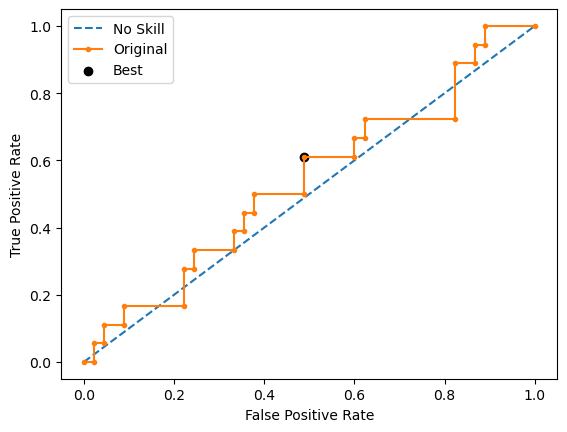

Learning rate set to 0.003871
0:	learn: 0.6917159	total: 819us	remaining: 819ms
1:	learn: 0.6905683	total: 1.97ms	remaining: 982ms
2:	learn: 0.6897031	total: 3.15ms	remaining: 1.05s
3:	learn: 0.6885841	total: 4.26ms	remaining: 1.06s
4:	learn: 0.6874500	total: 5.42ms	remaining: 1.08s
5:	learn: 0.6859262	total: 6.69ms	remaining: 1.11s
6:	learn: 0.6846010	total: 7.75ms	remaining: 1.1s
7:	learn: 0.6833015	total: 9.08ms	remaining: 1.13s
8:	learn: 0.6811969	total: 10.4ms	remaining: 1.14s
9:	learn: 0.6799812	total: 11.4ms	remaining: 1.13s
10:	learn: 0.6787906	total: 12.5ms	remaining: 1.12s
11:	learn: 0.6768968	total: 13.7ms	remaining: 1.13s
12:	learn: 0.6752615	total: 14.9ms	remaining: 1.13s
13:	learn: 0.6734001	total: 16.1ms	remaining: 1.13s
14:	learn: 0.6719833	total: 17.2ms	remaining: 1.13s
15:	learn: 0.6711877	total: 18.5ms	remaining: 1.14s
16:	learn: 0.6696815	total: 20ms	remaining: 1.15s
17:	learn: 0.6688226	total: 21.1ms	remaining: 1.15s
18:	learn: 0.6674048	total: 22.2ms	remaining: 1.

160:	learn: 0.5123849	total: 196ms	remaining: 1.02s
161:	learn: 0.5118341	total: 198ms	remaining: 1.02s
162:	learn: 0.5106579	total: 199ms	remaining: 1.02s
163:	learn: 0.5100663	total: 200ms	remaining: 1.02s
164:	learn: 0.5089863	total: 201ms	remaining: 1.02s
165:	learn: 0.5080350	total: 202ms	remaining: 1.02s
166:	learn: 0.5072068	total: 203ms	remaining: 1.01s
167:	learn: 0.5069131	total: 204ms	remaining: 1.01s
168:	learn: 0.5059912	total: 206ms	remaining: 1.01s
169:	learn: 0.5050565	total: 207ms	remaining: 1.01s
170:	learn: 0.5043648	total: 210ms	remaining: 1.02s
171:	learn: 0.5030611	total: 211ms	remaining: 1.01s
172:	learn: 0.5025083	total: 212ms	remaining: 1.01s
173:	learn: 0.5014158	total: 213ms	remaining: 1.01s
174:	learn: 0.5007041	total: 214ms	remaining: 1.01s
175:	learn: 0.4993266	total: 215ms	remaining: 1.01s
176:	learn: 0.4983468	total: 216ms	remaining: 1s
177:	learn: 0.4978512	total: 218ms	remaining: 1.01s
178:	learn: 0.4965536	total: 220ms	remaining: 1.01s
179:	learn: 0.4

329:	learn: 0.3919278	total: 393ms	remaining: 798ms
330:	learn: 0.3914581	total: 394ms	remaining: 797ms
331:	learn: 0.3908771	total: 395ms	remaining: 796ms
332:	learn: 0.3899330	total: 397ms	remaining: 795ms
333:	learn: 0.3893460	total: 398ms	remaining: 793ms
334:	learn: 0.3884840	total: 399ms	remaining: 792ms
335:	learn: 0.3878005	total: 400ms	remaining: 790ms
336:	learn: 0.3874999	total: 401ms	remaining: 789ms
337:	learn: 0.3871193	total: 402ms	remaining: 788ms
338:	learn: 0.3867439	total: 403ms	remaining: 786ms
339:	learn: 0.3861490	total: 405ms	remaining: 785ms
340:	learn: 0.3858234	total: 406ms	remaining: 784ms
341:	learn: 0.3851891	total: 407ms	remaining: 782ms
342:	learn: 0.3845221	total: 408ms	remaining: 781ms
343:	learn: 0.3834052	total: 409ms	remaining: 780ms
344:	learn: 0.3829132	total: 410ms	remaining: 778ms
345:	learn: 0.3824702	total: 411ms	remaining: 777ms
346:	learn: 0.3818173	total: 412ms	remaining: 776ms
347:	learn: 0.3816196	total: 413ms	remaining: 774ms
348:	learn: 

502:	learn: 0.3087954	total: 590ms	remaining: 583ms
503:	learn: 0.3084090	total: 591ms	remaining: 582ms
504:	learn: 0.3083206	total: 591ms	remaining: 580ms
505:	learn: 0.3079277	total: 593ms	remaining: 579ms
506:	learn: 0.3075868	total: 594ms	remaining: 578ms
507:	learn: 0.3073562	total: 596ms	remaining: 577ms
508:	learn: 0.3070910	total: 597ms	remaining: 576ms
509:	learn: 0.3066532	total: 598ms	remaining: 574ms
510:	learn: 0.3063364	total: 599ms	remaining: 573ms
511:	learn: 0.3060539	total: 601ms	remaining: 572ms
512:	learn: 0.3055300	total: 602ms	remaining: 571ms
513:	learn: 0.3052579	total: 603ms	remaining: 570ms
514:	learn: 0.3046874	total: 604ms	remaining: 569ms
515:	learn: 0.3043184	total: 605ms	remaining: 567ms
516:	learn: 0.3041773	total: 606ms	remaining: 566ms
517:	learn: 0.3039953	total: 607ms	remaining: 565ms
518:	learn: 0.3034147	total: 608ms	remaining: 564ms
519:	learn: 0.3031835	total: 609ms	remaining: 562ms
520:	learn: 0.3026085	total: 611ms	remaining: 561ms
521:	learn: 

673:	learn: 0.2520092	total: 787ms	remaining: 381ms
674:	learn: 0.2514782	total: 789ms	remaining: 380ms
675:	learn: 0.2512706	total: 790ms	remaining: 378ms
676:	learn: 0.2509779	total: 791ms	remaining: 377ms
677:	learn: 0.2506300	total: 792ms	remaining: 376ms
678:	learn: 0.2504172	total: 793ms	remaining: 375ms
679:	learn: 0.2499774	total: 794ms	remaining: 374ms
680:	learn: 0.2496494	total: 795ms	remaining: 372ms
681:	learn: 0.2495076	total: 796ms	remaining: 371ms
682:	learn: 0.2488635	total: 797ms	remaining: 370ms
683:	learn: 0.2485320	total: 799ms	remaining: 369ms
684:	learn: 0.2482163	total: 800ms	remaining: 368ms
685:	learn: 0.2478865	total: 802ms	remaining: 367ms
686:	learn: 0.2476247	total: 804ms	remaining: 366ms
687:	learn: 0.2472431	total: 805ms	remaining: 365ms
688:	learn: 0.2469837	total: 806ms	remaining: 364ms
689:	learn: 0.2467702	total: 807ms	remaining: 363ms
690:	learn: 0.2464657	total: 808ms	remaining: 361ms
691:	learn: 0.2462816	total: 809ms	remaining: 360ms
692:	learn: 

846:	learn: 0.2068010	total: 983ms	remaining: 178ms
847:	learn: 0.2065722	total: 985ms	remaining: 176ms
848:	learn: 0.2062896	total: 986ms	remaining: 175ms
849:	learn: 0.2059379	total: 987ms	remaining: 174ms
850:	learn: 0.2056982	total: 988ms	remaining: 173ms
851:	learn: 0.2054271	total: 989ms	remaining: 172ms
852:	learn: 0.2053197	total: 990ms	remaining: 171ms
853:	learn: 0.2050652	total: 991ms	remaining: 169ms
854:	learn: 0.2048530	total: 992ms	remaining: 168ms
855:	learn: 0.2044746	total: 993ms	remaining: 167ms
856:	learn: 0.2043207	total: 994ms	remaining: 166ms
857:	learn: 0.2040265	total: 995ms	remaining: 165ms
858:	learn: 0.2036816	total: 997ms	remaining: 164ms
859:	learn: 0.2033704	total: 998ms	remaining: 162ms
860:	learn: 0.2030693	total: 999ms	remaining: 161ms
861:	learn: 0.2026843	total: 1000ms	remaining: 160ms
862:	learn: 0.2024477	total: 1s	remaining: 159ms
863:	learn: 0.2020868	total: 1s	remaining: 158ms
864:	learn: 0.2017752	total: 1s	remaining: 157ms
865:	learn: 0.201688

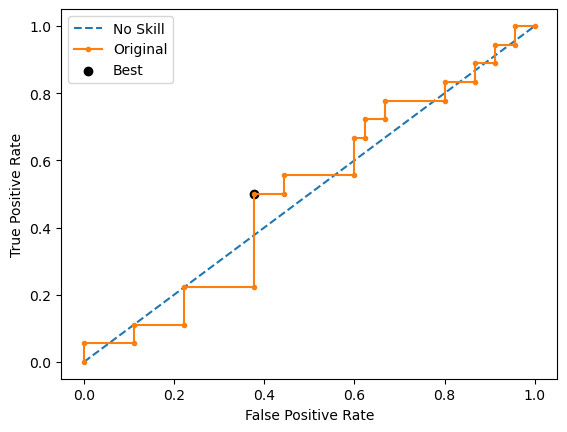

Learning rate set to 0.003871
0:	learn: 0.6927530	total: 2.09ms	remaining: 2.09s
1:	learn: 0.6913975	total: 3.28ms	remaining: 1.64s
2:	learn: 0.6902600	total: 5.07ms	remaining: 1.69s
3:	learn: 0.6891552	total: 6.28ms	remaining: 1.56s
4:	learn: 0.6885805	total: 7.4ms	remaining: 1.47s
5:	learn: 0.6875048	total: 8.57ms	remaining: 1.42s
6:	learn: 0.6860725	total: 9.8ms	remaining: 1.39s
7:	learn: 0.6844895	total: 10.8ms	remaining: 1.34s
8:	learn: 0.6839286	total: 12.2ms	remaining: 1.34s
9:	learn: 0.6820136	total: 13.4ms	remaining: 1.33s
10:	learn: 0.6808738	total: 14.5ms	remaining: 1.3s
11:	learn: 0.6797894	total: 15.5ms	remaining: 1.27s
12:	learn: 0.6785145	total: 16.6ms	remaining: 1.26s
13:	learn: 0.6775071	total: 17.7ms	remaining: 1.25s
14:	learn: 0.6773229	total: 18.2ms	remaining: 1.19s
15:	learn: 0.6756536	total: 20.1ms	remaining: 1.24s
16:	learn: 0.6749661	total: 21.3ms	remaining: 1.23s
17:	learn: 0.6739179	total: 22.4ms	remaining: 1.22s
18:	learn: 0.6731543	total: 23.5ms	remaining: 1

163:	learn: 0.5347517	total: 197ms	remaining: 1s
164:	learn: 0.5336194	total: 198ms	remaining: 1s
165:	learn: 0.5327075	total: 199ms	remaining: 1s
166:	learn: 0.5315802	total: 200ms	remaining: 999ms
167:	learn: 0.5310745	total: 202ms	remaining: 1s
168:	learn: 0.5301783	total: 203ms	remaining: 999ms
169:	learn: 0.5293801	total: 204ms	remaining: 998ms
170:	learn: 0.5287783	total: 206ms	remaining: 999ms
171:	learn: 0.5278314	total: 207ms	remaining: 998ms
172:	learn: 0.5275475	total: 208ms	remaining: 996ms
173:	learn: 0.5262501	total: 210ms	remaining: 995ms
174:	learn: 0.5260140	total: 211ms	remaining: 993ms
175:	learn: 0.5252379	total: 212ms	remaining: 991ms
176:	learn: 0.5244256	total: 213ms	remaining: 989ms
177:	learn: 0.5236651	total: 214ms	remaining: 987ms
178:	learn: 0.5228553	total: 215ms	remaining: 985ms
179:	learn: 0.5218846	total: 216ms	remaining: 984ms
180:	learn: 0.5207942	total: 217ms	remaining: 983ms
181:	learn: 0.5201664	total: 218ms	remaining: 981ms
182:	learn: 0.5190019	to

333:	learn: 0.4132663	total: 393ms	remaining: 783ms
334:	learn: 0.4127510	total: 394ms	remaining: 781ms
335:	learn: 0.4123634	total: 395ms	remaining: 780ms
336:	learn: 0.4119719	total: 396ms	remaining: 779ms
337:	learn: 0.4112045	total: 397ms	remaining: 777ms
338:	learn: 0.4103958	total: 398ms	remaining: 776ms
339:	learn: 0.4097751	total: 400ms	remaining: 776ms
340:	learn: 0.4088645	total: 401ms	remaining: 776ms
341:	learn: 0.4082071	total: 402ms	remaining: 774ms
342:	learn: 0.4075658	total: 403ms	remaining: 773ms
343:	learn: 0.4071047	total: 404ms	remaining: 771ms
344:	learn: 0.4062793	total: 406ms	remaining: 770ms
345:	learn: 0.4056045	total: 407ms	remaining: 769ms
346:	learn: 0.4051260	total: 408ms	remaining: 768ms
347:	learn: 0.4046928	total: 409ms	remaining: 767ms
348:	learn: 0.4039575	total: 410ms	remaining: 766ms
349:	learn: 0.4032489	total: 412ms	remaining: 766ms
350:	learn: 0.4029349	total: 413ms	remaining: 763ms
351:	learn: 0.4024522	total: 414ms	remaining: 762ms
352:	learn: 

504:	learn: 0.3252224	total: 590ms	remaining: 578ms
505:	learn: 0.3250327	total: 591ms	remaining: 577ms
506:	learn: 0.3244806	total: 592ms	remaining: 576ms
507:	learn: 0.3240213	total: 594ms	remaining: 575ms
508:	learn: 0.3236499	total: 595ms	remaining: 574ms
509:	learn: 0.3234864	total: 596ms	remaining: 573ms
510:	learn: 0.3229560	total: 597ms	remaining: 572ms
511:	learn: 0.3223389	total: 599ms	remaining: 571ms
512:	learn: 0.3219872	total: 600ms	remaining: 569ms
513:	learn: 0.3217271	total: 600ms	remaining: 568ms
514:	learn: 0.3213571	total: 602ms	remaining: 567ms
515:	learn: 0.3210059	total: 603ms	remaining: 565ms
516:	learn: 0.3203368	total: 604ms	remaining: 564ms
517:	learn: 0.3200059	total: 605ms	remaining: 563ms
518:	learn: 0.3194162	total: 606ms	remaining: 561ms
519:	learn: 0.3190791	total: 607ms	remaining: 560ms
520:	learn: 0.3186942	total: 608ms	remaining: 559ms
521:	learn: 0.3184354	total: 609ms	remaining: 558ms
522:	learn: 0.3181348	total: 611ms	remaining: 557ms
523:	learn: 

680:	learn: 0.2611730	total: 787ms	remaining: 369ms
681:	learn: 0.2606944	total: 788ms	remaining: 368ms
682:	learn: 0.2602972	total: 790ms	remaining: 366ms
683:	learn: 0.2599796	total: 791ms	remaining: 365ms
684:	learn: 0.2596435	total: 792ms	remaining: 364ms
685:	learn: 0.2592827	total: 793ms	remaining: 363ms
686:	learn: 0.2591247	total: 794ms	remaining: 362ms
687:	learn: 0.2589886	total: 795ms	remaining: 361ms
688:	learn: 0.2585156	total: 797ms	remaining: 360ms
689:	learn: 0.2582293	total: 798ms	remaining: 358ms
690:	learn: 0.2580629	total: 799ms	remaining: 357ms
691:	learn: 0.2577828	total: 800ms	remaining: 356ms
692:	learn: 0.2576101	total: 801ms	remaining: 355ms
693:	learn: 0.2574671	total: 802ms	remaining: 354ms
694:	learn: 0.2571676	total: 803ms	remaining: 352ms
695:	learn: 0.2567994	total: 804ms	remaining: 351ms
696:	learn: 0.2563756	total: 805ms	remaining: 350ms
697:	learn: 0.2561077	total: 806ms	remaining: 349ms
698:	learn: 0.2559150	total: 807ms	remaining: 348ms
699:	learn: 

852:	learn: 0.2139402	total: 984ms	remaining: 170ms
853:	learn: 0.2136371	total: 985ms	remaining: 168ms
854:	learn: 0.2135136	total: 987ms	remaining: 167ms
855:	learn: 0.2132418	total: 988ms	remaining: 166ms
856:	learn: 0.2129592	total: 989ms	remaining: 165ms
857:	learn: 0.2128193	total: 990ms	remaining: 164ms
858:	learn: 0.2125181	total: 991ms	remaining: 163ms
859:	learn: 0.2122176	total: 992ms	remaining: 162ms
860:	learn: 0.2119220	total: 994ms	remaining: 160ms
861:	learn: 0.2116874	total: 995ms	remaining: 159ms
862:	learn: 0.2113941	total: 996ms	remaining: 158ms
863:	learn: 0.2111655	total: 998ms	remaining: 157ms
864:	learn: 0.2109303	total: 999ms	remaining: 156ms
865:	learn: 0.2108227	total: 1000ms	remaining: 155ms
866:	learn: 0.2105680	total: 1s	remaining: 154ms
867:	learn: 0.2103698	total: 1s	remaining: 152ms
868:	learn: 0.2101813	total: 1s	remaining: 151ms
869:	learn: 0.2099649	total: 1s	remaining: 150ms
870:	learn: 0.2095369	total: 1s	remaining: 149ms
871:	learn: 0.2094257	tota

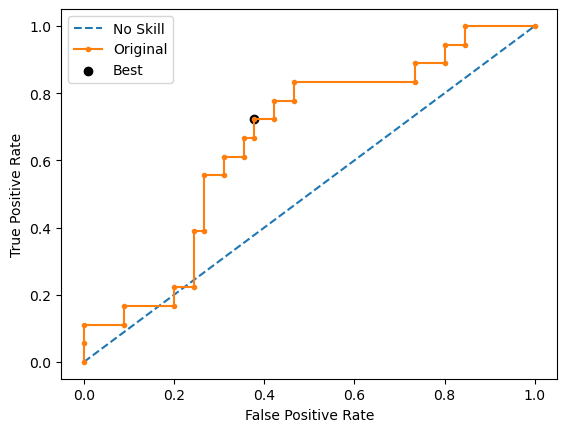

Learning rate set to 0.003854
0:	learn: 0.6920561	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6909664	total: 2.33ms	remaining: 1.17s
2:	learn: 0.6898255	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6890681	total: 4.56ms	remaining: 1.14s
4:	learn: 0.6883292	total: 5.65ms	remaining: 1.12s
5:	learn: 0.6874231	total: 6.71ms	remaining: 1.11s
6:	learn: 0.6864297	total: 8.13ms	remaining: 1.15s
7:	learn: 0.6846664	total: 9.39ms	remaining: 1.16s
8:	learn: 0.6837137	total: 11.4ms	remaining: 1.25s
9:	learn: 0.6827732	total: 12.6ms	remaining: 1.25s
10:	learn: 0.6813359	total: 13.8ms	remaining: 1.24s
11:	learn: 0.6801926	total: 14.7ms	remaining: 1.21s
12:	learn: 0.6793655	total: 16.1ms	remaining: 1.22s
13:	learn: 0.6781677	total: 17.4ms	remaining: 1.22s
14:	learn: 0.6771316	total: 18.6ms	remaining: 1.22s
15:	learn: 0.6763066	total: 19.7ms	remaining: 1.21s
16:	learn: 0.6747866	total: 20.9ms	remaining: 1.21s
17:	learn: 0.6730997	total: 22.2ms	remaining: 1.21s
18:	learn: 0.6720512	total: 23.3ms	remaining:

159:	learn: 0.5342986	total: 197ms	remaining: 1.03s
160:	learn: 0.5336735	total: 199ms	remaining: 1.04s
161:	learn: 0.5331888	total: 201ms	remaining: 1.04s
162:	learn: 0.5319971	total: 202ms	remaining: 1.04s
163:	learn: 0.5312473	total: 203ms	remaining: 1.04s
164:	learn: 0.5301959	total: 204ms	remaining: 1.03s
165:	learn: 0.5292319	total: 206ms	remaining: 1.03s
166:	learn: 0.5281385	total: 207ms	remaining: 1.03s
167:	learn: 0.5274877	total: 208ms	remaining: 1.03s
168:	learn: 0.5267264	total: 210ms	remaining: 1.03s
169:	learn: 0.5258006	total: 211ms	remaining: 1.03s
170:	learn: 0.5251117	total: 213ms	remaining: 1.03s
171:	learn: 0.5247342	total: 214ms	remaining: 1.03s
172:	learn: 0.5240179	total: 215ms	remaining: 1.03s
173:	learn: 0.5233002	total: 216ms	remaining: 1.02s
174:	learn: 0.5225275	total: 217ms	remaining: 1.02s
175:	learn: 0.5221279	total: 218ms	remaining: 1.02s
176:	learn: 0.5211163	total: 220ms	remaining: 1.02s
177:	learn: 0.5207652	total: 221ms	remaining: 1.02s
178:	learn: 

324:	learn: 0.4223210	total: 394ms	remaining: 818ms
325:	learn: 0.4220911	total: 396ms	remaining: 818ms
326:	learn: 0.4213679	total: 397ms	remaining: 817ms
327:	learn: 0.4211865	total: 398ms	remaining: 816ms
328:	learn: 0.4203294	total: 400ms	remaining: 816ms
329:	learn: 0.4199157	total: 401ms	remaining: 814ms
330:	learn: 0.4192828	total: 402ms	remaining: 812ms
331:	learn: 0.4188969	total: 404ms	remaining: 812ms
332:	learn: 0.4183501	total: 405ms	remaining: 811ms
333:	learn: 0.4179462	total: 406ms	remaining: 809ms
334:	learn: 0.4171537	total: 407ms	remaining: 808ms
335:	learn: 0.4166369	total: 408ms	remaining: 806ms
336:	learn: 0.4159762	total: 409ms	remaining: 805ms
337:	learn: 0.4154782	total: 410ms	remaining: 804ms
338:	learn: 0.4151560	total: 411ms	remaining: 802ms
339:	learn: 0.4148060	total: 413ms	remaining: 802ms
340:	learn: 0.4142252	total: 414ms	remaining: 800ms
341:	learn: 0.4136009	total: 416ms	remaining: 800ms
342:	learn: 0.4131792	total: 417ms	remaining: 798ms
343:	learn: 

497:	learn: 0.3356872	total: 591ms	remaining: 596ms
498:	learn: 0.3350922	total: 592ms	remaining: 594ms
499:	learn: 0.3346738	total: 593ms	remaining: 593ms
500:	learn: 0.3339245	total: 594ms	remaining: 592ms
501:	learn: 0.3336176	total: 595ms	remaining: 590ms
502:	learn: 0.3334326	total: 596ms	remaining: 589ms
503:	learn: 0.3331340	total: 597ms	remaining: 588ms
504:	learn: 0.3329147	total: 598ms	remaining: 586ms
505:	learn: 0.3323382	total: 599ms	remaining: 585ms
506:	learn: 0.3320222	total: 600ms	remaining: 584ms
507:	learn: 0.3314920	total: 601ms	remaining: 583ms
508:	learn: 0.3313615	total: 602ms	remaining: 581ms
509:	learn: 0.3307928	total: 604ms	remaining: 581ms
510:	learn: 0.3304597	total: 605ms	remaining: 579ms
511:	learn: 0.3298427	total: 607ms	remaining: 578ms
512:	learn: 0.3294136	total: 608ms	remaining: 577ms
513:	learn: 0.3289777	total: 609ms	remaining: 575ms
514:	learn: 0.3285756	total: 610ms	remaining: 574ms
515:	learn: 0.3281008	total: 611ms	remaining: 573ms
516:	learn: 

670:	learn: 0.2700047	total: 787ms	remaining: 386ms
671:	learn: 0.2695791	total: 789ms	remaining: 385ms
672:	learn: 0.2690184	total: 790ms	remaining: 384ms
673:	learn: 0.2687570	total: 791ms	remaining: 382ms
674:	learn: 0.2684108	total: 792ms	remaining: 381ms
675:	learn: 0.2680692	total: 793ms	remaining: 380ms
676:	learn: 0.2675641	total: 794ms	remaining: 379ms
677:	learn: 0.2673594	total: 795ms	remaining: 378ms
678:	learn: 0.2669140	total: 796ms	remaining: 376ms
679:	learn: 0.2664009	total: 797ms	remaining: 375ms
680:	learn: 0.2661887	total: 798ms	remaining: 374ms
681:	learn: 0.2657282	total: 799ms	remaining: 373ms
682:	learn: 0.2655210	total: 801ms	remaining: 372ms
683:	learn: 0.2652387	total: 803ms	remaining: 371ms
684:	learn: 0.2650061	total: 804ms	remaining: 370ms
685:	learn: 0.2647223	total: 805ms	remaining: 369ms
686:	learn: 0.2645194	total: 806ms	remaining: 367ms
687:	learn: 0.2643043	total: 807ms	remaining: 366ms
688:	learn: 0.2639111	total: 809ms	remaining: 365ms
689:	learn: 

841:	learn: 0.2211404	total: 984ms	remaining: 185ms
842:	learn: 0.2208982	total: 986ms	remaining: 184ms
843:	learn: 0.2206536	total: 986ms	remaining: 182ms
844:	learn: 0.2204325	total: 988ms	remaining: 181ms
845:	learn: 0.2202037	total: 989ms	remaining: 180ms
846:	learn: 0.2199888	total: 990ms	remaining: 179ms
847:	learn: 0.2197552	total: 991ms	remaining: 178ms
848:	learn: 0.2193699	total: 992ms	remaining: 176ms
849:	learn: 0.2191748	total: 993ms	remaining: 175ms
850:	learn: 0.2189488	total: 995ms	remaining: 174ms
851:	learn: 0.2187635	total: 996ms	remaining: 173ms
852:	learn: 0.2184269	total: 997ms	remaining: 172ms
853:	learn: 0.2180724	total: 998ms	remaining: 171ms
854:	learn: 0.2179676	total: 999ms	remaining: 169ms
855:	learn: 0.2176266	total: 1s	remaining: 168ms
856:	learn: 0.2173643	total: 1s	remaining: 167ms
857:	learn: 0.2171199	total: 1s	remaining: 166ms
858:	learn: 0.2169905	total: 1s	remaining: 165ms
859:	learn: 0.2167288	total: 1s	remaining: 164ms
860:	learn: 0.2164872	total

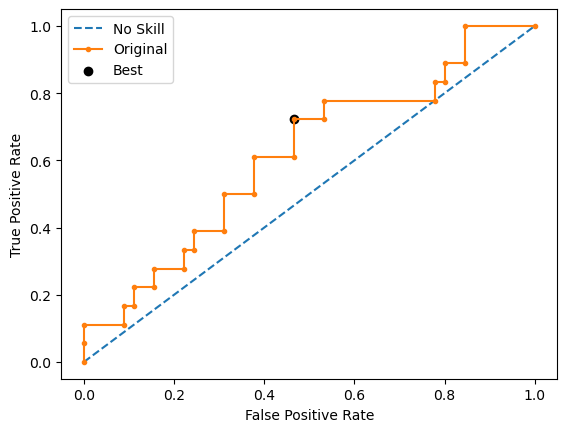

Learning rate set to 0.004045
0:	learn: 0.6913908	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6898588	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6887572	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6872842	total: 5.63ms	remaining: 1.4s
4:	learn: 0.6868506	total: 6.66ms	remaining: 1.32s
5:	learn: 0.6860244	total: 7.49ms	remaining: 1.24s
6:	learn: 0.6847880	total: 8.75ms	remaining: 1.24s
7:	learn: 0.6834224	total: 10ms	remaining: 1.25s
8:	learn: 0.6830838	total: 11.3ms	remaining: 1.24s
9:	learn: 0.6811446	total: 12.4ms	remaining: 1.23s
10:	learn: 0.6793031	total: 13.5ms	remaining: 1.22s
11:	learn: 0.6783583	total: 14.6ms	remaining: 1.2s
12:	learn: 0.6773561	total: 17.2ms	remaining: 1.3s
13:	learn: 0.6752319	total: 18.6ms	remaining: 1.31s
14:	learn: 0.6737227	total: 19.8ms	remaining: 1.3s
15:	learn: 0.6719212	total: 21.7ms	remaining: 1.33s
16:	learn: 0.6701680	total: 22.9ms	remaining: 1.32s
17:	learn: 0.6693065	total: 24.8ms	remaining: 1.35s
18:	learn: 0.6682019	total: 27ms	remaining: 1.39s


314:	learn: 0.4055094	total: 396ms	remaining: 861ms
315:	learn: 0.4049490	total: 397ms	remaining: 859ms
316:	learn: 0.4041981	total: 398ms	remaining: 858ms
317:	learn: 0.4033571	total: 399ms	remaining: 856ms
318:	learn: 0.4027225	total: 400ms	remaining: 854ms
319:	learn: 0.4022576	total: 401ms	remaining: 853ms
320:	learn: 0.4016115	total: 403ms	remaining: 852ms
321:	learn: 0.4012099	total: 404ms	remaining: 850ms
322:	learn: 0.4006632	total: 405ms	remaining: 848ms
323:	learn: 0.4002607	total: 406ms	remaining: 847ms
324:	learn: 0.3993105	total: 407ms	remaining: 845ms
325:	learn: 0.3986469	total: 408ms	remaining: 844ms
326:	learn: 0.3976178	total: 409ms	remaining: 842ms
327:	learn: 0.3972857	total: 410ms	remaining: 840ms
328:	learn: 0.3970601	total: 411ms	remaining: 839ms
329:	learn: 0.3965314	total: 412ms	remaining: 837ms
330:	learn: 0.3958423	total: 414ms	remaining: 836ms
331:	learn: 0.3953102	total: 415ms	remaining: 834ms
332:	learn: 0.3942696	total: 416ms	remaining: 834ms
333:	learn: 

481:	learn: 0.3233642	total: 593ms	remaining: 638ms
482:	learn: 0.3226510	total: 595ms	remaining: 637ms
483:	learn: 0.3218934	total: 596ms	remaining: 635ms
484:	learn: 0.3213653	total: 597ms	remaining: 634ms
485:	learn: 0.3209561	total: 598ms	remaining: 632ms
486:	learn: 0.3205751	total: 599ms	remaining: 631ms
487:	learn: 0.3199253	total: 600ms	remaining: 630ms
488:	learn: 0.3197501	total: 601ms	remaining: 628ms
489:	learn: 0.3192594	total: 602ms	remaining: 627ms
490:	learn: 0.3187510	total: 604ms	remaining: 626ms
491:	learn: 0.3181633	total: 605ms	remaining: 624ms
492:	learn: 0.3176255	total: 606ms	remaining: 623ms
493:	learn: 0.3173429	total: 607ms	remaining: 622ms
494:	learn: 0.3171745	total: 608ms	remaining: 620ms
495:	learn: 0.3167992	total: 609ms	remaining: 619ms
496:	learn: 0.3166377	total: 610ms	remaining: 618ms
497:	learn: 0.3161027	total: 611ms	remaining: 616ms
498:	learn: 0.3157101	total: 613ms	remaining: 616ms
499:	learn: 0.3153877	total: 614ms	remaining: 614ms
500:	learn: 

651:	learn: 0.2586779	total: 790ms	remaining: 422ms
652:	learn: 0.2584470	total: 791ms	remaining: 421ms
653:	learn: 0.2583014	total: 793ms	remaining: 420ms
654:	learn: 0.2580394	total: 794ms	remaining: 418ms
655:	learn: 0.2577362	total: 795ms	remaining: 417ms
656:	learn: 0.2574554	total: 796ms	remaining: 416ms
657:	learn: 0.2571186	total: 797ms	remaining: 414ms
658:	learn: 0.2567531	total: 799ms	remaining: 413ms
659:	learn: 0.2561885	total: 800ms	remaining: 412ms
660:	learn: 0.2559358	total: 801ms	remaining: 411ms
661:	learn: 0.2558305	total: 802ms	remaining: 410ms
662:	learn: 0.2554007	total: 804ms	remaining: 409ms
663:	learn: 0.2551278	total: 805ms	remaining: 407ms
664:	learn: 0.2547076	total: 806ms	remaining: 406ms
665:	learn: 0.2543188	total: 807ms	remaining: 405ms
666:	learn: 0.2542089	total: 809ms	remaining: 404ms
667:	learn: 0.2536791	total: 810ms	remaining: 403ms
668:	learn: 0.2532859	total: 812ms	remaining: 402ms
669:	learn: 0.2528897	total: 814ms	remaining: 401ms
670:	learn: 

815:	learn: 0.2108241	total: 988ms	remaining: 223ms
816:	learn: 0.2106101	total: 989ms	remaining: 222ms
817:	learn: 0.2103827	total: 990ms	remaining: 220ms
818:	learn: 0.2102602	total: 991ms	remaining: 219ms
819:	learn: 0.2100214	total: 992ms	remaining: 218ms
820:	learn: 0.2099359	total: 994ms	remaining: 217ms
821:	learn: 0.2095970	total: 995ms	remaining: 215ms
822:	learn: 0.2091951	total: 996ms	remaining: 214ms
823:	learn: 0.2090666	total: 997ms	remaining: 213ms
824:	learn: 0.2087771	total: 998ms	remaining: 212ms
825:	learn: 0.2084267	total: 999ms	remaining: 211ms
826:	learn: 0.2082094	total: 1s	remaining: 209ms
827:	learn: 0.2079967	total: 1s	remaining: 208ms
828:	learn: 0.2077613	total: 1s	remaining: 207ms
829:	learn: 0.2076353	total: 1s	remaining: 206ms
830:	learn: 0.2073133	total: 1s	remaining: 204ms
831:	learn: 0.2070800	total: 1.01s	remaining: 203ms
832:	learn: 0.2068652	total: 1.01s	remaining: 202ms
833:	learn: 0.2065661	total: 1.01s	remaining: 201ms
834:	learn: 0.2063304	total

983:	learn: 0.1735449	total: 1.19s	remaining: 19.3ms
984:	learn: 0.1732839	total: 1.19s	remaining: 18.1ms
985:	learn: 0.1731703	total: 1.19s	remaining: 16.9ms
986:	learn: 0.1728722	total: 1.19s	remaining: 15.7ms
987:	learn: 0.1726720	total: 1.19s	remaining: 14.5ms
988:	learn: 0.1725515	total: 1.19s	remaining: 13.3ms
989:	learn: 0.1723239	total: 1.19s	remaining: 12.1ms
990:	learn: 0.1720757	total: 1.19s	remaining: 10.8ms
991:	learn: 0.1717910	total: 1.2s	remaining: 9.64ms
992:	learn: 0.1715548	total: 1.2s	remaining: 8.43ms
993:	learn: 0.1712660	total: 1.2s	remaining: 7.23ms
994:	learn: 0.1710349	total: 1.2s	remaining: 6.02ms
995:	learn: 0.1708347	total: 1.2s	remaining: 4.82ms
996:	learn: 0.1707530	total: 1.2s	remaining: 3.61ms
997:	learn: 0.1704299	total: 1.2s	remaining: 2.41ms
998:	learn: 0.1702577	total: 1.2s	remaining: 1.2ms
999:	learn: 0.1700769	total: 1.2s	remaining: 0us
Run 5 - Random State: 4
Test G-mean: 0.5163977794943222
Best Threshold=0.489582, G-Mean=0.547


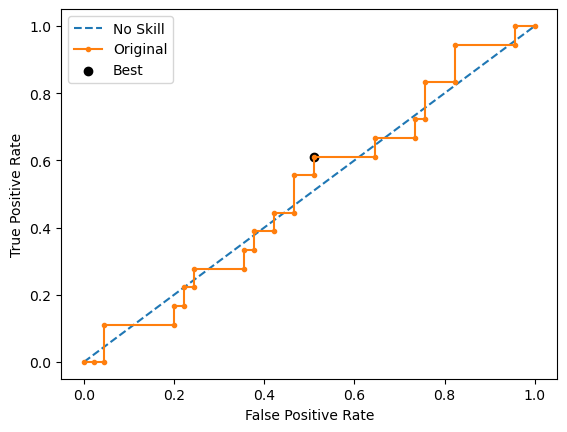

Ave Test G-mean: 0.5693045456604647
Stdev Test G-mean: 0.061774065325712176
Ave Test Specificity: 0.5244444444444445
Ave Test Recall: 0.6222222222222222
Ave Test NPV: 0.7763827199867244
Ave Test Accuracy: 0.5523809523809524
Ave Test Precision: 0.3438467143614202
Ave Test F1-Score: 0.4423333333333333
Ave Runtime: 1.2171438217163086


In [25]:
ho_t02_catboost_gs, ho_t02_catboost_be, ho_t02_catboost_model_info, ho_t02_catboost_metrics_df = catboost_class2(ho_t02, 'recall',
                                                            'ageing_class', random_state=0)

In [26]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoosts'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],n
    'Best Hyperparameters': [],
    'Mean Val Recall': [],
    'Mean Train Recall': [],
    'Stdev Train Recall': [],
    'Average Runtime': [],
    'Average Test Precision': [],
    'Stdev Test Precision': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Stdev Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Stdev Test Accuracy': [],
    'Average Test G-mean': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t02_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val Recall'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train Recall'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train Recall'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Stdev Test Precision'].append(globals()[prefix+name+'_model_info']['stdev_test_precision'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Stdev Test Recall'].append(globals()[prefix+name+'_model_info']['stdev_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Stdev Test Accuracy'].append(globals()[prefix+name+'_model_info']['stdev_test_accuracy'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t02_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t02_summ[[
    'Classifier model', 'Average Test Recall',
    'Stdev Test Recall', 'Mean Val Recall',
    'Mean Train Recall','Average Test F1-score',
    'Average Test Accuracy', 'Stdev Test Accuracy'
]].sort_values(by='Average Test Recall', ascending=False)

,Classifier model,Average Test Recall,Stdev Test Recall,Mean Val Recall,Mean Train Recall,Average Test F1-score,Average Test Accuracy,Stdev Test Accuracy
1,SVM Classifier,0.777778,0.435677,0.900000,0.591441,0.354431,0.384127,0.185585
0,k-Nearest Neighbors,0.744444,0.115202,0.666667,0.637530,0.418701,0.412698,0.050195
3,Decision Tree,0.722222,0.175682,0.806667,NaN,0.418652,0.428571,0.107656
2,Logistic Regression,0.700000,0.399846,0.863333,NaN,0.335571,0.390476,0.183949
4,Random Forest,0.666667,0.136083,0.730000,0.772053,0.423805,0.473016,0.131085
8,AdaBoost,0.655556,0.106863,0.666667,1.000000,0.432862,0.511111,0.045453
7,Extreme Gradient Boosting (XGBoost),0.644444,0.084254,0.646667,0.958638,0.455588,0.558730,0.060858
9,CatBoosts,0.622222,0.099381,0.610000,1.000000,0.442333,0.552381,0.055442
6,LightGBM,0.622222,0.154160,0.693333,0.840457,0.436586,0.549206,0.047087
5,Gradient Boosting Machine (GBM),0.577778,0.084254,0.720000,0.999076,0.404970,0.514286,0.056789


In [27]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t02_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.558730,Extreme Gradient Boosting (XGBoost)
Highest Test G-mean,0.580337,Extreme Gradient Boosting (XGBoost)
Highest Test Recall,0.777778,SVM Classifier
Highest Test Precision,0.352869,Extreme Gradient Boosting (XGBoost)
Highest Test Specificity,0.524444,CatBoosts
Highest Test F1-score,0.455588,Extreme Gradient Boosting (XGBoost)


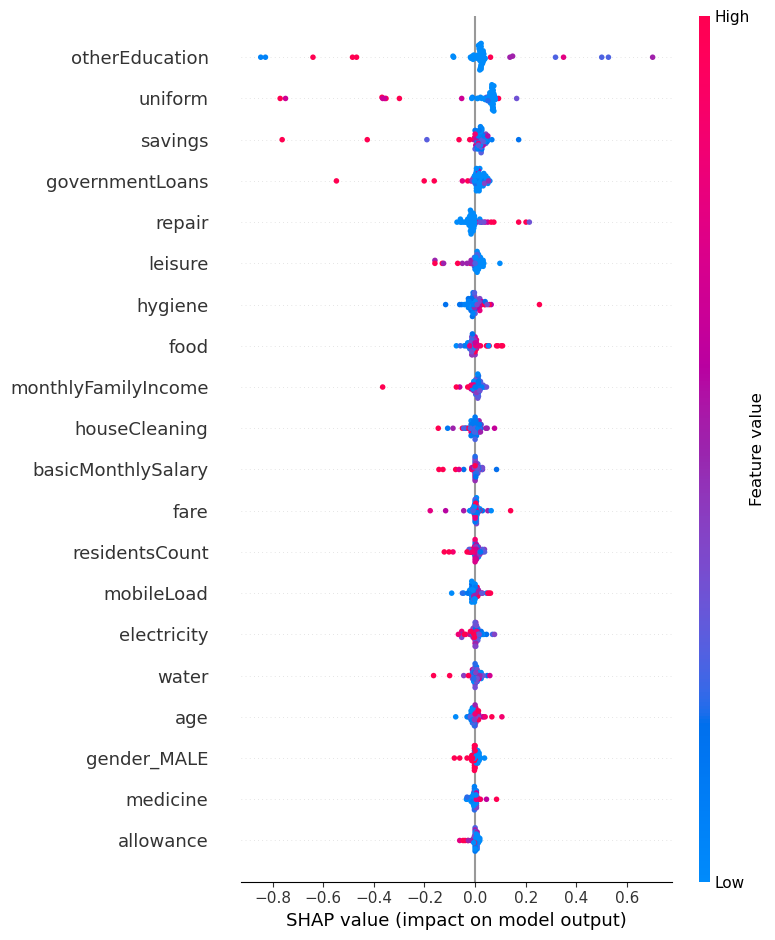

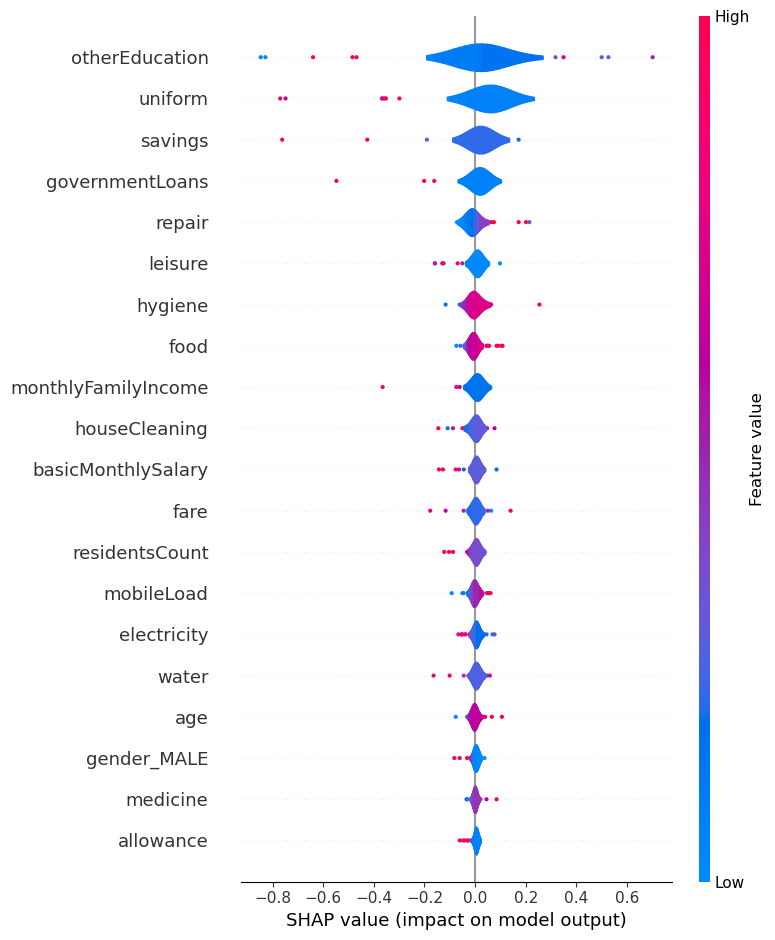

589:	learn: 0.2978311	total: 826ms	remaining: 574ms
590:	learn: 0.2975995	total: 827ms	remaining: 573ms
591:	learn: 0.2972254	total: 829ms	remaining: 571ms
592:	learn: 0.2967733	total: 830ms	remaining: 570ms
593:	learn: 0.2966355	total: 832ms	remaining: 569ms
594:	learn: 0.2964537	total: 833ms	remaining: 567ms
595:	learn: 0.2961602	total: 835ms	remaining: 566ms
596:	learn: 0.2957430	total: 836ms	remaining: 564ms
597:	learn: 0.2954284	total: 837ms	remaining: 563ms
598:	learn: 0.2951030	total: 839ms	remaining: 561ms
599:	learn: 0.2948303	total: 840ms	remaining: 560ms
600:	learn: 0.2942808	total: 841ms	remaining: 558ms
601:	learn: 0.2940152	total: 842ms	remaining: 557ms
602:	learn: 0.2936788	total: 843ms	remaining: 555ms
603:	learn: 0.2933092	total: 845ms	remaining: 554ms
604:	learn: 0.2928406	total: 846ms	remaining: 553ms
605:	learn: 0.2924529	total: 848ms	remaining: 551ms
606:	learn: 0.2920354	total: 849ms	remaining: 550ms
607:	learn: 0.2917902	total: 850ms	remaining: 548ms
608:	learn: 

In [28]:
df = ho_t02
# model = ho_t02_xgb_be.named_steps['classifier']
model = ho_t02_knn_be
label_col = 'ageing_class'
X = df.drop(['userId', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)
# explainer = shap.TreeExplainer(model=model,
#                                data=X_test,
#                                model_output='raw',
# #                                feature_perturbation='tree_path_dependent'
#                               )

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)
# shap_values = explainer.shap_values(X_test)

feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')